In [29]:
import glob
import shutil
import os
import subprocess

parent_directory = "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/*/*/*/*/My_V4_Miniscope"
# "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/*/*/*/*/My_V4_Miniscope"
# "/home/lq53/mir_data/Oct3V1mini/Oct3V1mini_sorted/*/*/*/*/My_V4_Miniscope"  # Adjust the pattern as needed
# locations = glob.glob(parent_directory)
locations = [loc for loc in glob.glob(parent_directory) if not any(part.startswith('#') for part in loc.split(os.sep))]

In [30]:
source_file = "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/minian_mirpy_set.py"
# "/home/lq53/mir_data/24cont_miniscope/240918v1r1/2024_10_08/14_41_53/minian_simp_test/minian_mirpy_set.py"
for location in locations:
    destination_file = os.path.join(location, "minian_mirpy_set.py")
    if not os.path.exists(destination_file):
        shutil.copy(source_file, location)
        print(f"Copied script to {location}")
    else:
        print(f"Script already exists in {location}, skipping copy.")
# source_file = "/home/lq53/mir_data/24cont_miniscope/240918v1r1/2024_10_08/14_41_53/minian_simp_test/minian_mirpy_set.py"
# for location in locations:
#     shutil.copy(source_file, location)

Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241212v1l1r1/customEntValHere/2024_12_31/11_31_05/My_V4_Miniscope, skipping copy.
Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241212v1l1r1/customEntValHere/2024_12_31/11_41_01/My_V4_Miniscope, skipping copy.
Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope, skipping copy.
Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope, skipping copy.
Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_24_53/My_V4_Miniscope, skipping copy.
Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope, skipping copy.
Script already exists in /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted

In [31]:
import sys
import os
sys.path.append(os.path.abspath('../..'))

from utlis.scan_engine_utlis.scan_eng_big_utlis import log_experiment_data
from status_field_config_mini_250430 import STATUS_FIELDS_CONFIG
if __name__ == "__main__":
    root_dir = "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted" #"/data/big_rim/mir_data/Oct3V1mini/Oct3V1mini_sorted"
    failed_paths_file = None #'/data/big_rim/mir_data/Oct3V1mini/Oct3V1mini_sorted/sync_failed.txt'
    manual_log_path = "/home/lq53/mir_repos/BBOP/random_tests/25may_mini/mini_sanity_240618_mannual.csv"
    # "/home/lq53/mir_repos/BBOP/random_tests/25mar_minibbop_integration/mini_sanity_240324_mannual.csv"
    # 1) Delete all parquet files first
    # remove_all_parquet_files(root_dir)


    # 2) Then log only My_V4_Miniscope
    force_reprocess = []
    rescan_days = 0.001  # Lower for quick re-scan testing

    log_experiment_data(root_dir, manual_log_path, failed_paths_file, STATUS_FIELDS_CONFIG,
                        force_reprocess=force_reprocess,
                        rescan_days=rescan_days) #manual_log_path


Match found: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241212v1l1r1/customEntValHere/2024_12_31/11_31_05/My_V4_Miniscope
Match found: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240910-V1-R/customEntValHere/2024_11_01/12_52_48/My_V4_Miniscope
Match found: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope
Match found: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506V1L23-L1/customEntValHere/2025_06_26/16_27_17/My_V4_Miniscope
Match found: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope
Match found: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope
Log for 20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01 saved at /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/folder_log.parquet
Match found: /data/big_rim/rsync_dcc_sum/Oct3

In [32]:
# sys.path.append(os.path.abspath('../..'))
from utlis.scan_engine_utlis.scan_engine_utlis import read_all_parquet_files
# base_folder = "/hpc/group/tdunn/Bryan_Rigs/BigOpenField/24summ"
all_mini = read_all_parquet_files(root_dir)

In [38]:
import pyarrow as pa
import pyarrow.compute as pc
from functools import reduce

table = all_mini  # combined_df

# 1) 保留 valid_rec == '1' 且 mini_6cam_map == '1'
base_conditions = [
    pc.equal(table['valid_rec'], '1'),
    pc.equal(table['mini_6cam_map'], '1'),
]

# 2) 指定一组 quality 值，例如 ['unknown', 'param_adjust']
# quality_values = ['2025_06_13','2025_06_17'] #[, 'param_adjust'] #movements_too_much
# quality_condition = pc.is_in(table['date'], pa.array(quality_values)) #quality

# 2) 指定一组 quality 值，例如 ['unknown', 'param_adjust']
quality_values2 = ['unknown', 'param_adjust'] #[, 'param_adjust'] #movements_too_much
quality_condition2 = pc.is_in(table['quality'], pa.array(quality_values2)) #
# 3) 合并所有条件
all_conditions = base_conditions +[quality_condition2] # + [quality_condition]
filter_mask = reduce(pc.and_, all_conditions)

# 4) 应用过滤并转换为 pandas 查看
filtered_table_mini = table.filter(filter_mask)
print(filtered_table_mini.to_pandas())


  minian mini_6cam_map minian_selected valid_rec mapped       quality  \
0      0             1               0         1      0       unknown   
1      0             1               0         1      0       unknown   
2      0             1               0         1      0       unknown   
3      1             1               0         1      0       unknown   
4      0             1               0         1      0       unknown   
5      0             1               0         1      0       unknown   
6      0             1               0         1      0       unknown   
7      0             1               0         1      0       unknown   
8      1             1               1         1      1  param_adjust   
9      0             1               0         1      1  param_adjust   

                    timestamp               animal_id      custom_label  \
0  2025-07-07T17:48:50.834839       20250505-V1L23-R1  customEntValHere   
1  2025-07-07T17:48:50.836126       20250505-V

In [41]:
# Convert and flatten the ChunkedArray
experiment_path = filtered_table_mini["experiment_path"].to_pylist()

# Print each path
for path in experiment_path:
   # Each element is likely a list with one string, e.g., ['/some/path']
   print(path[0] if isinstance(path, list) else path)


# 

/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_38_23/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224P


=== Running vis_param_opti for session ===
Animal:       20250505-V1L23-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope
Found 18 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/20

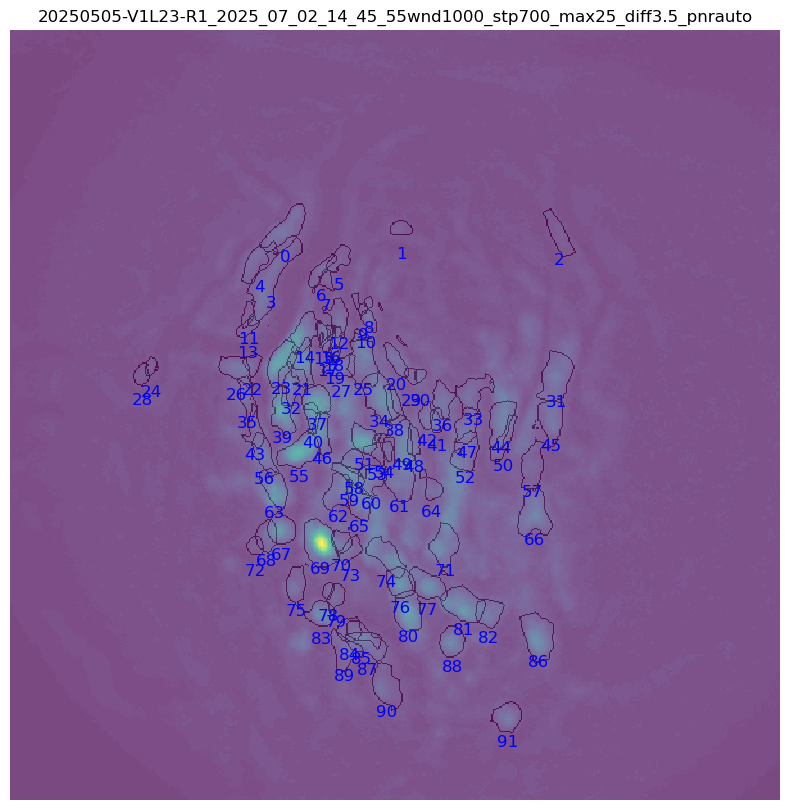

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc


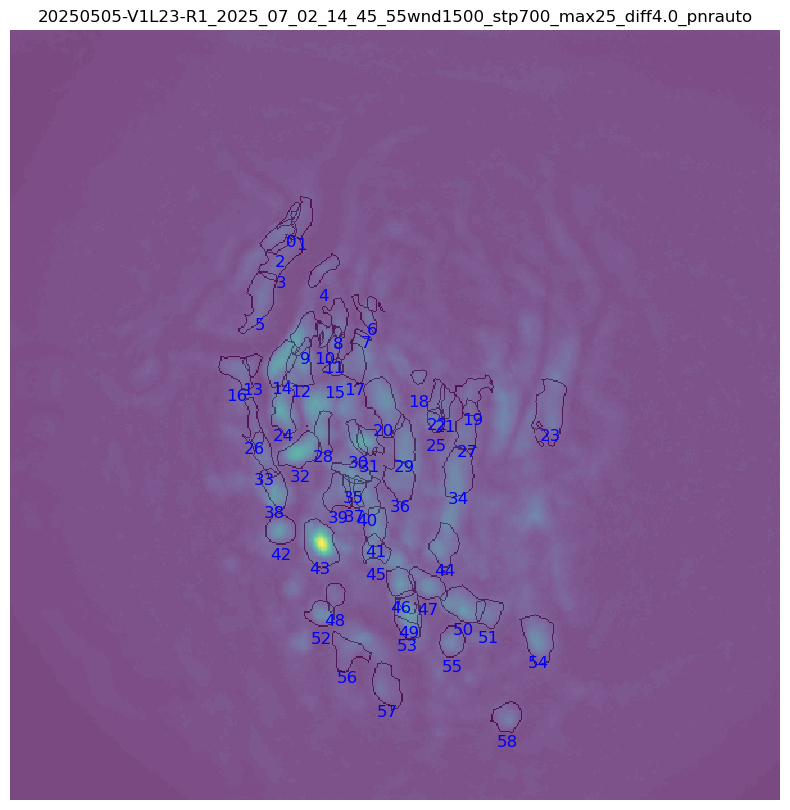

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


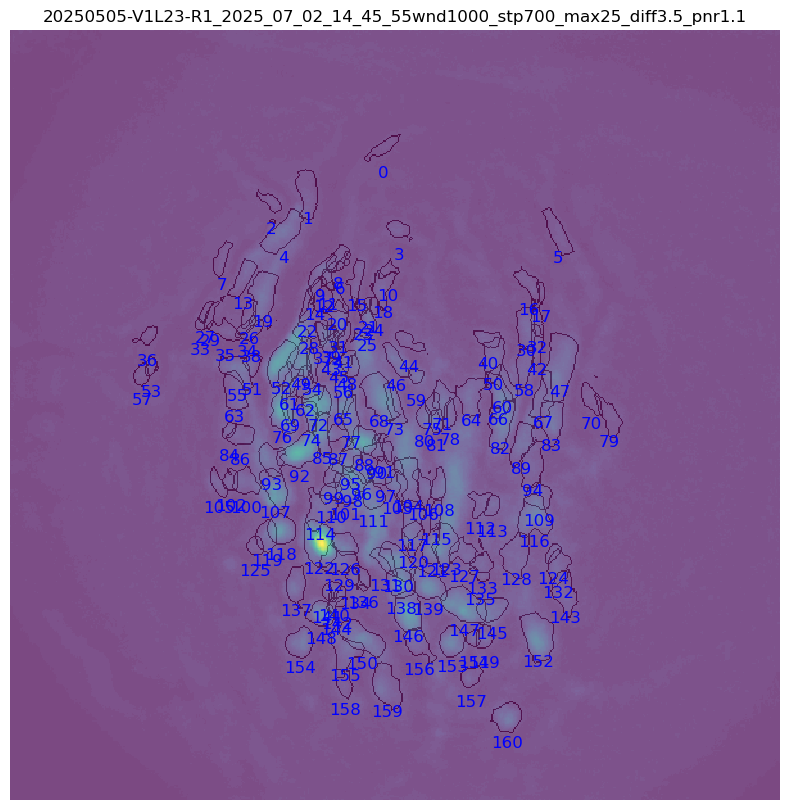

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


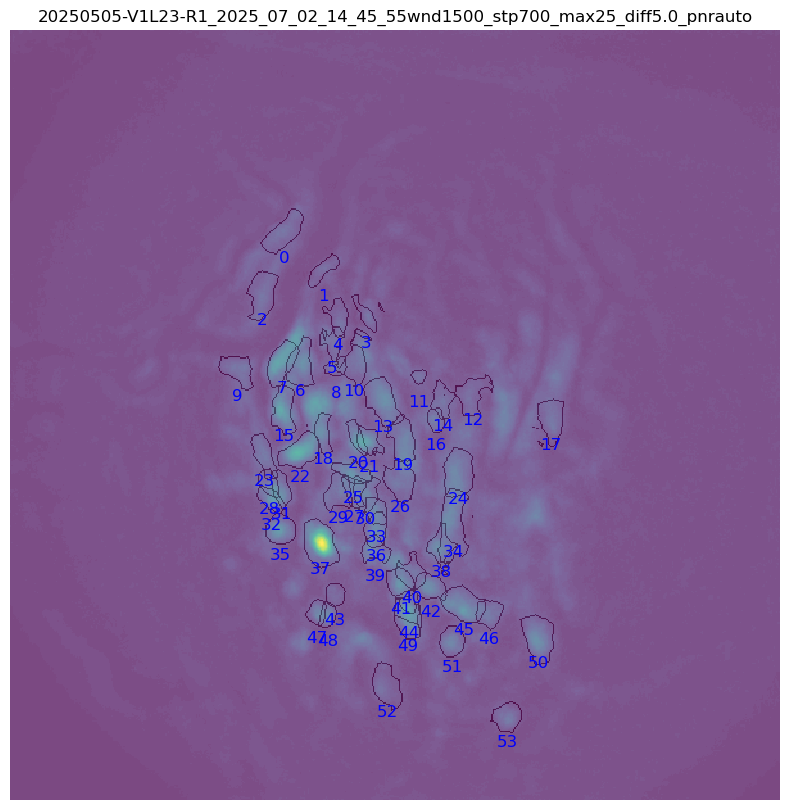

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


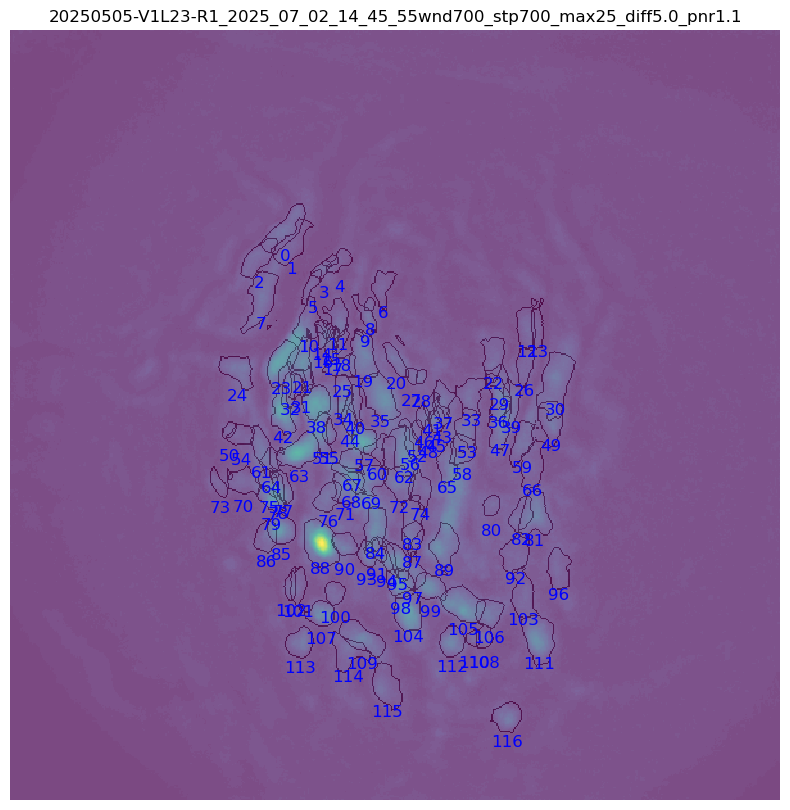

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


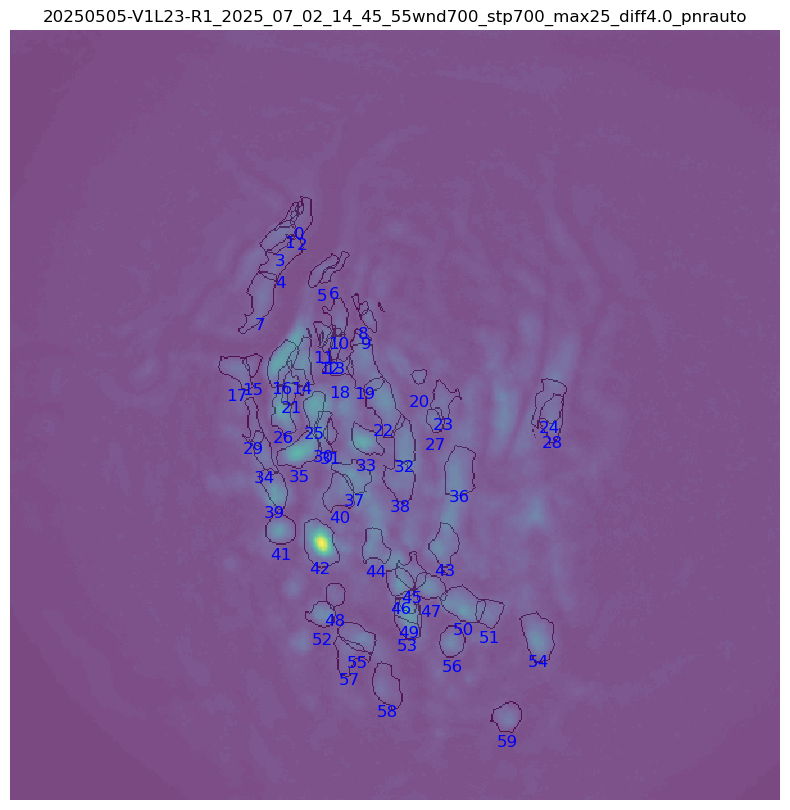

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnrauto.nc


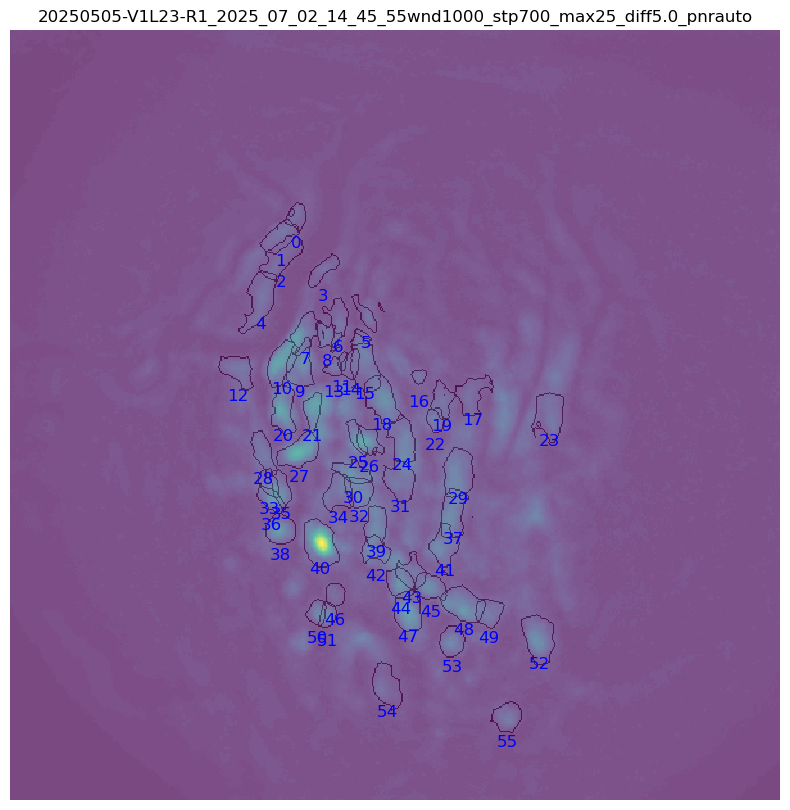

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


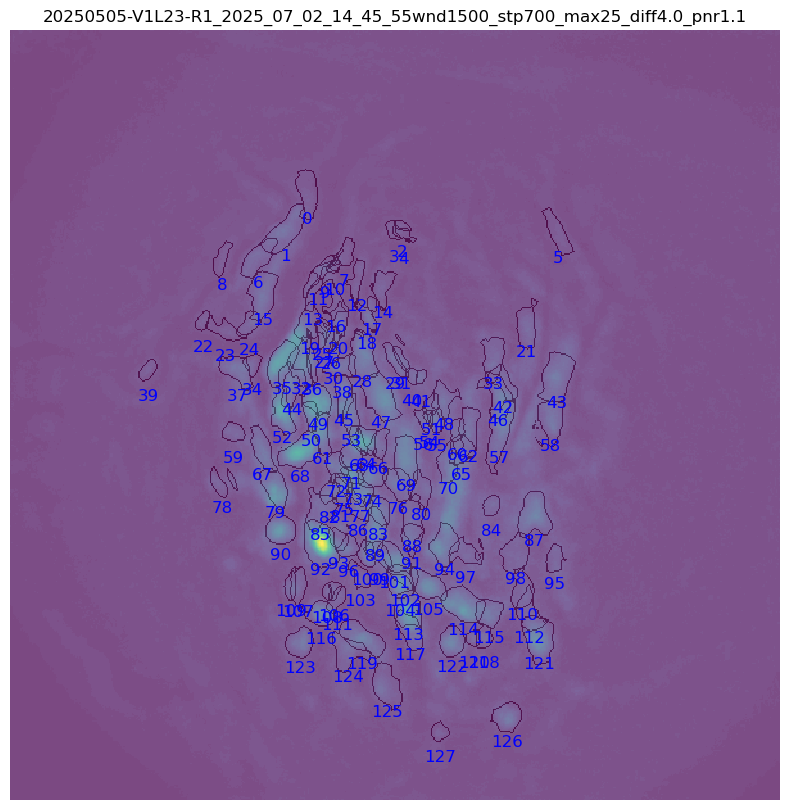

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


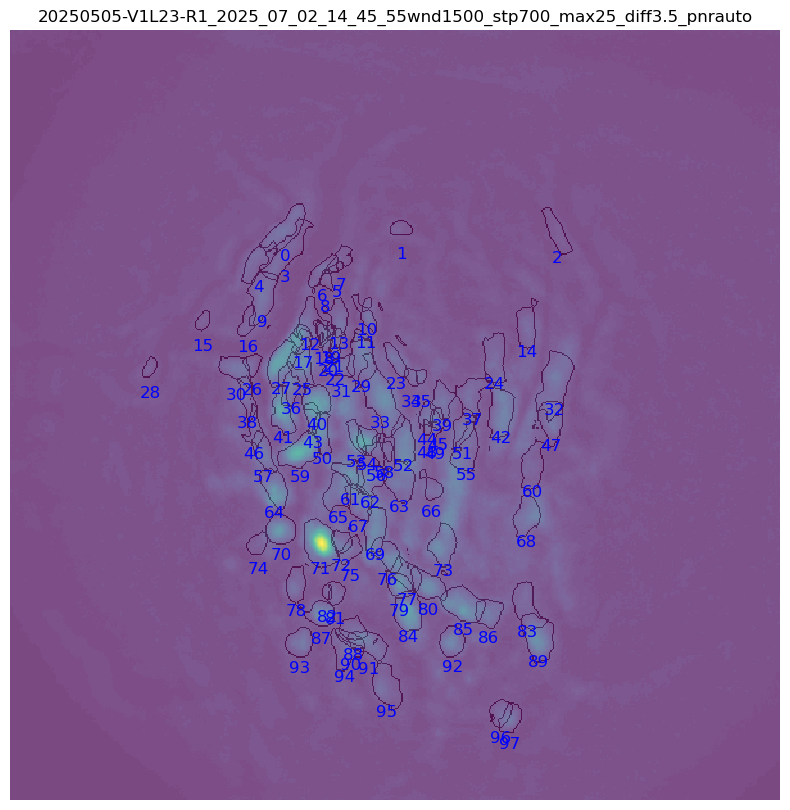

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


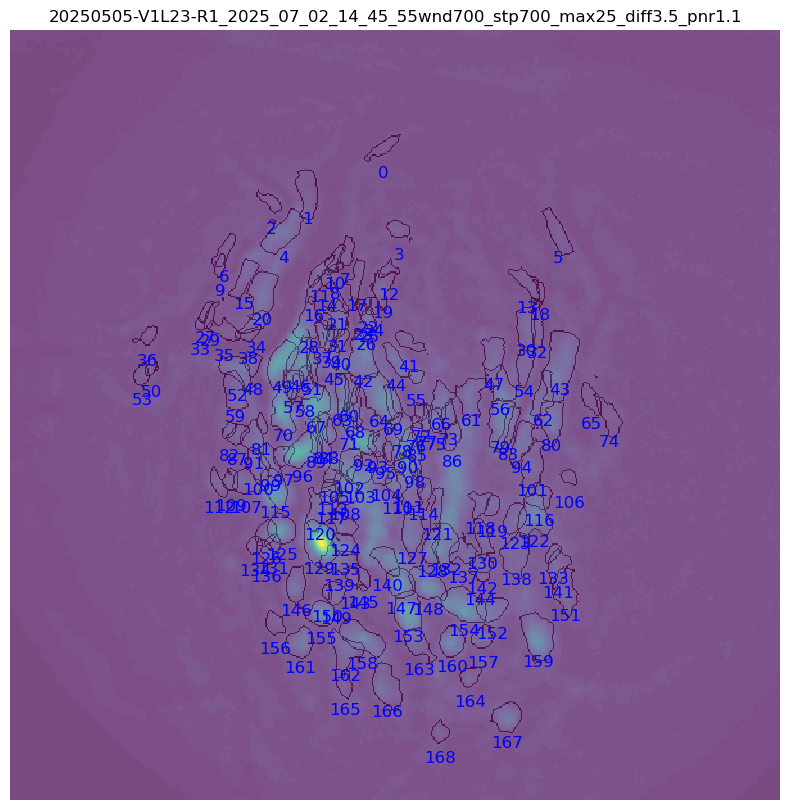

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


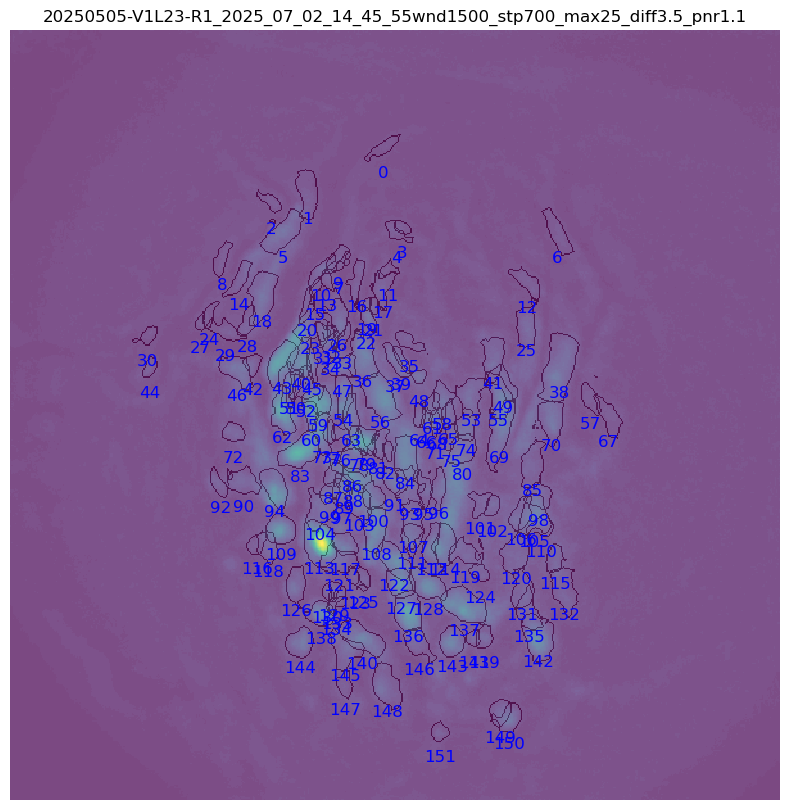

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


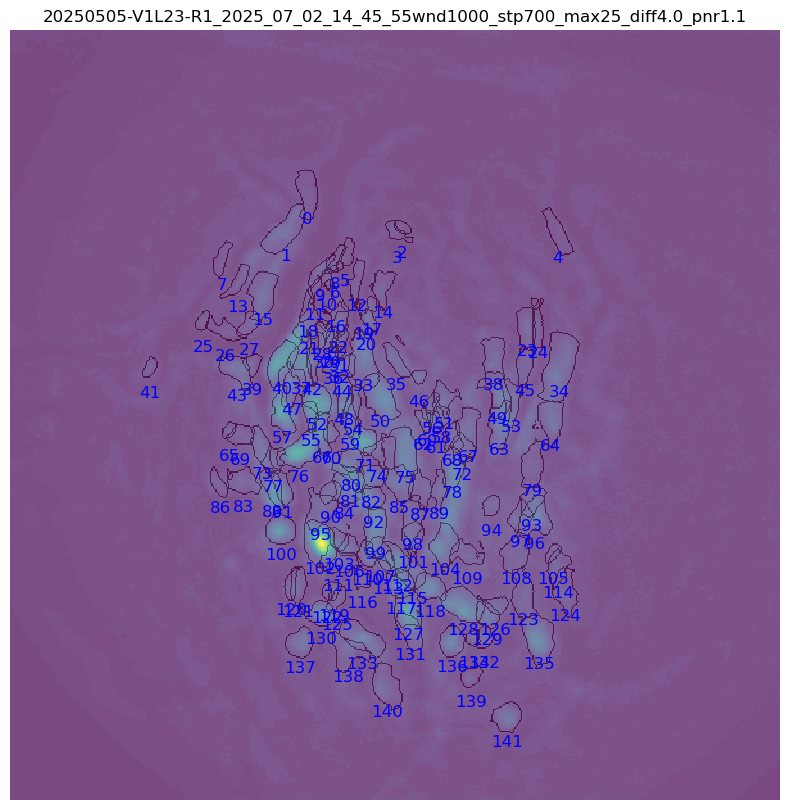

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


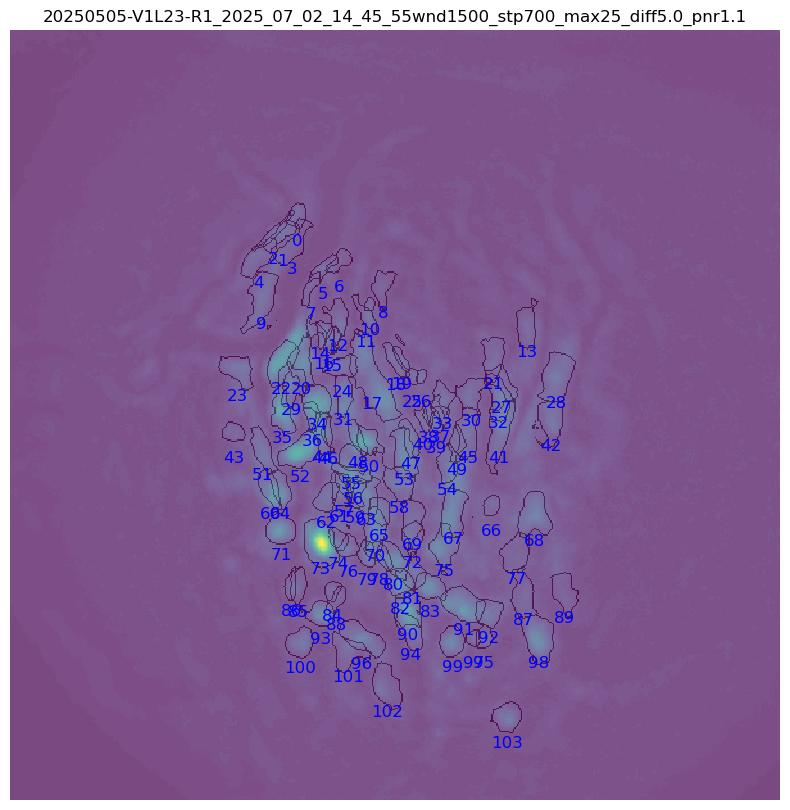

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


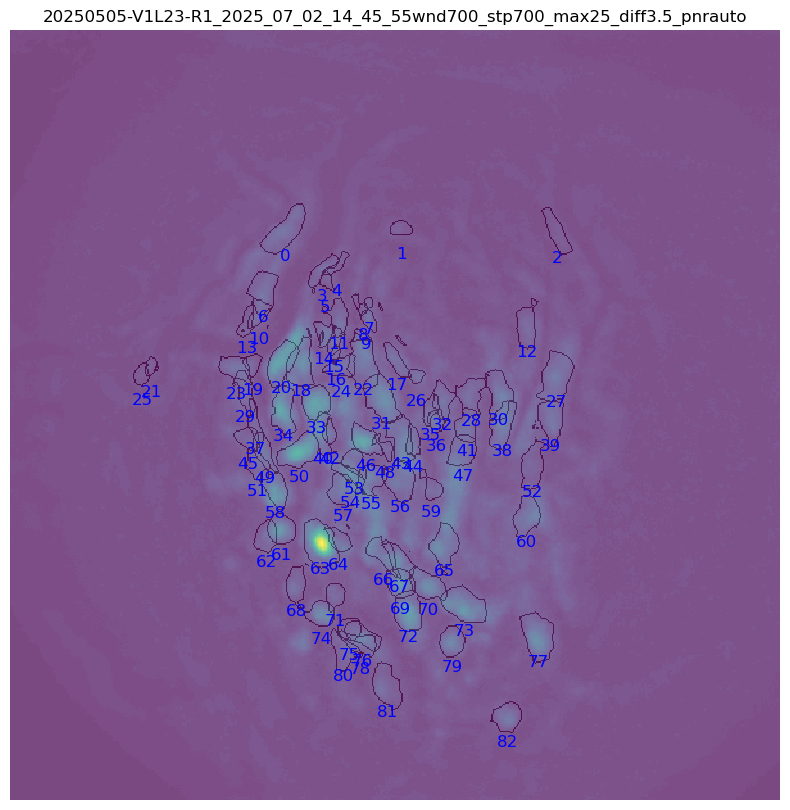

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


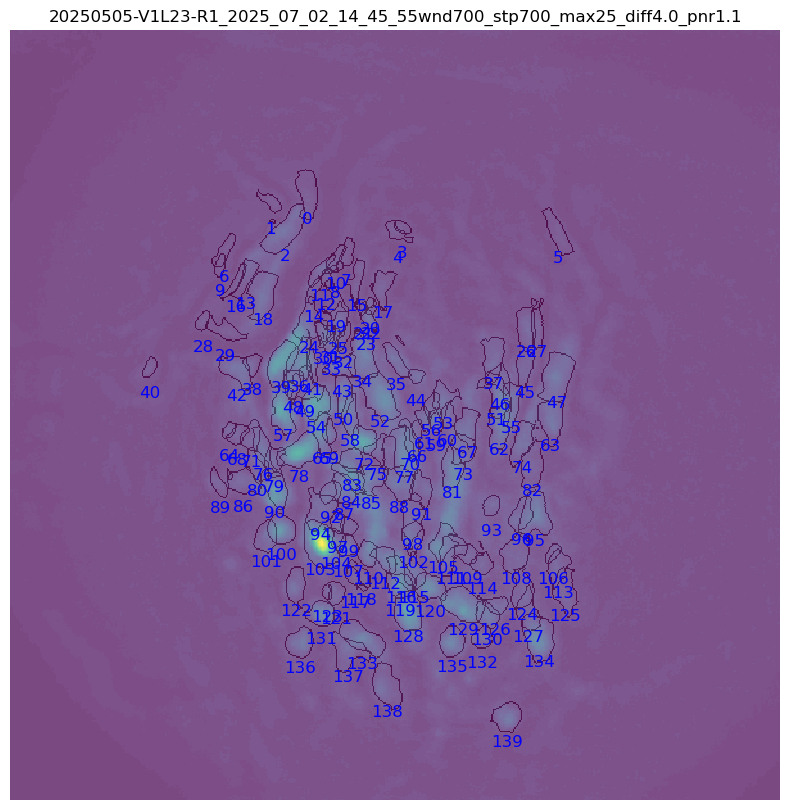

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnrauto.nc


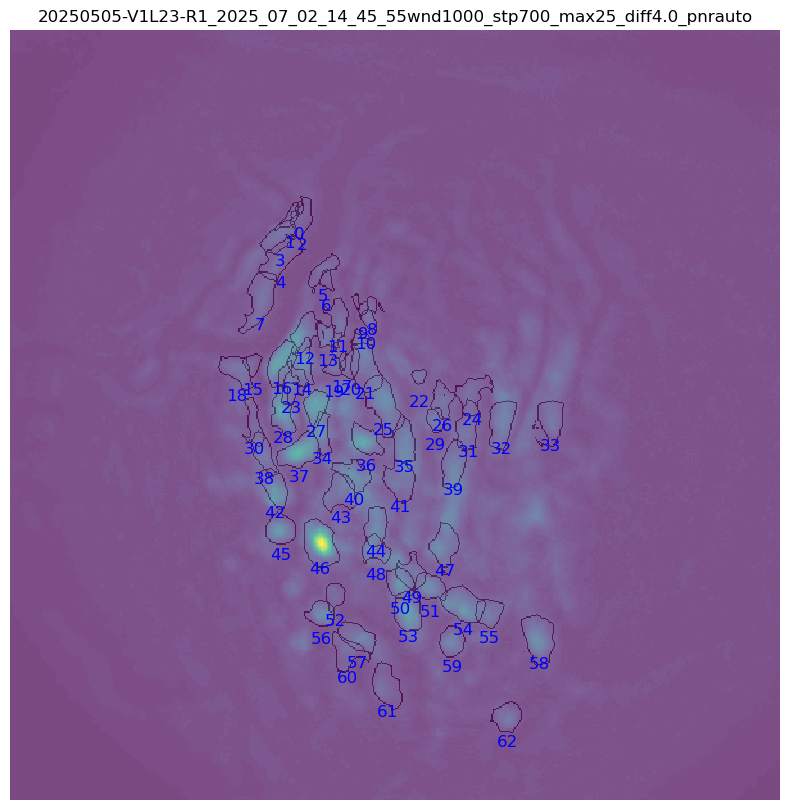

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


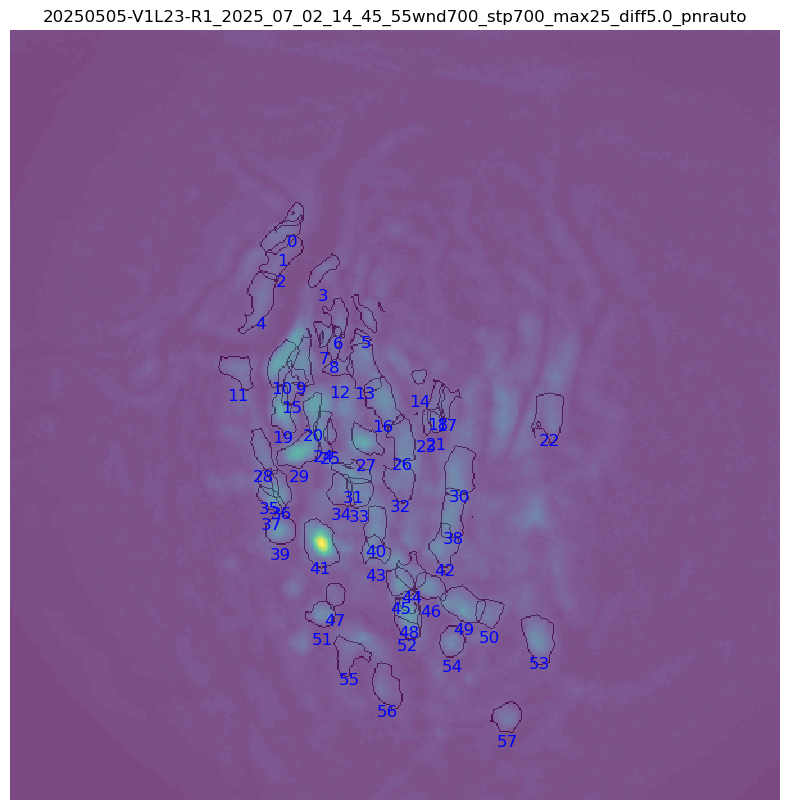

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


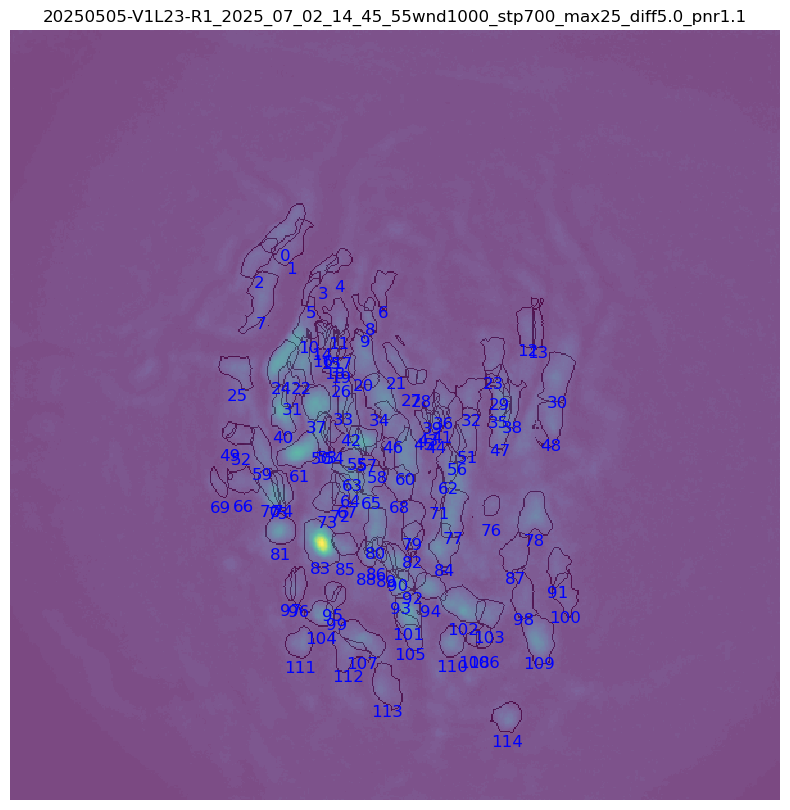


=== Running vis_param_opti for session ===
Animal:       20250505-V1L23-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope
Found 18 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/20

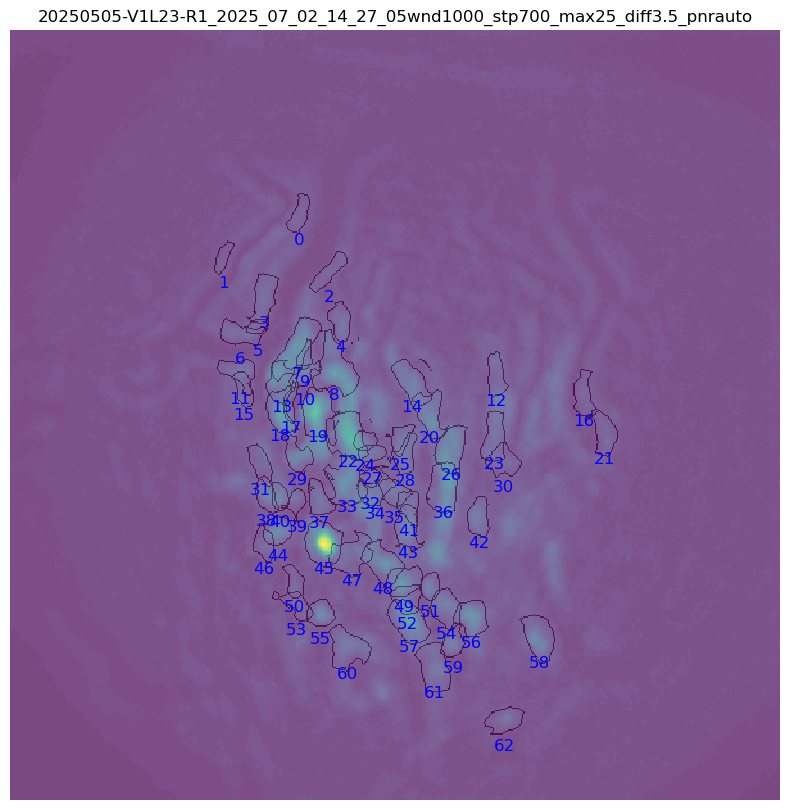

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc


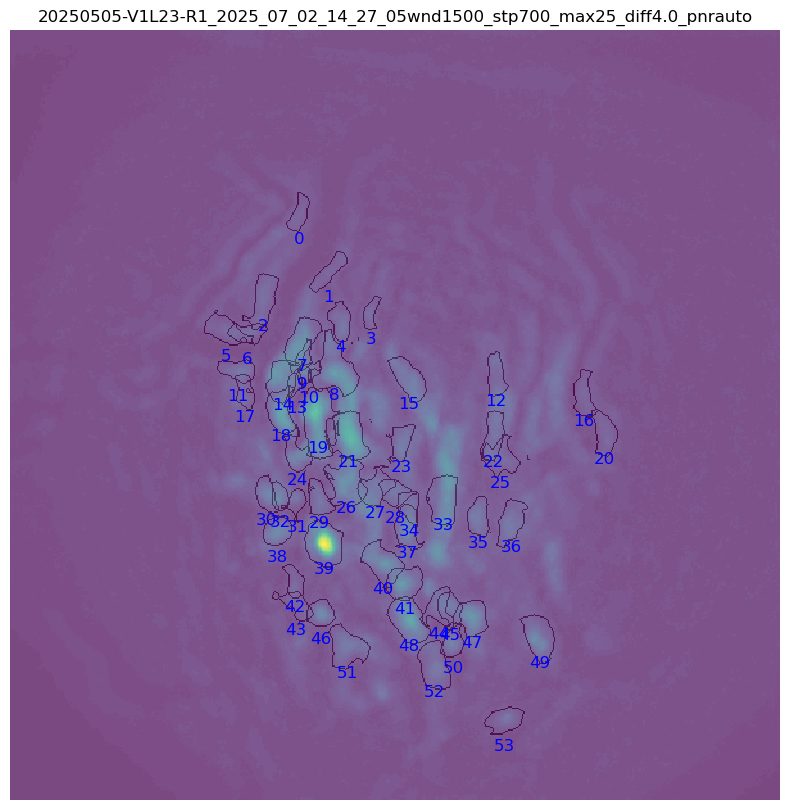

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


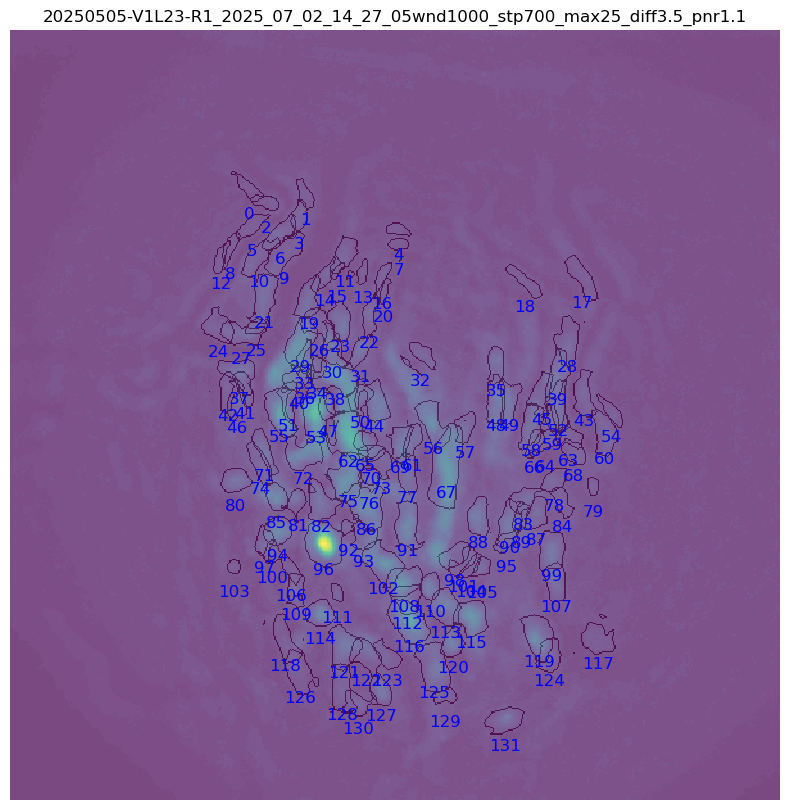

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


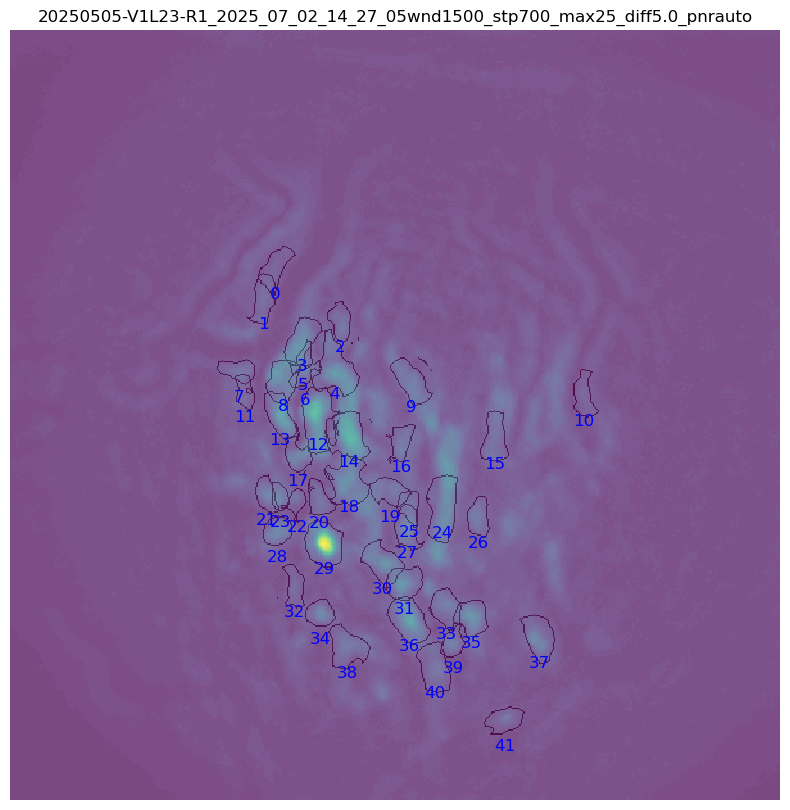

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


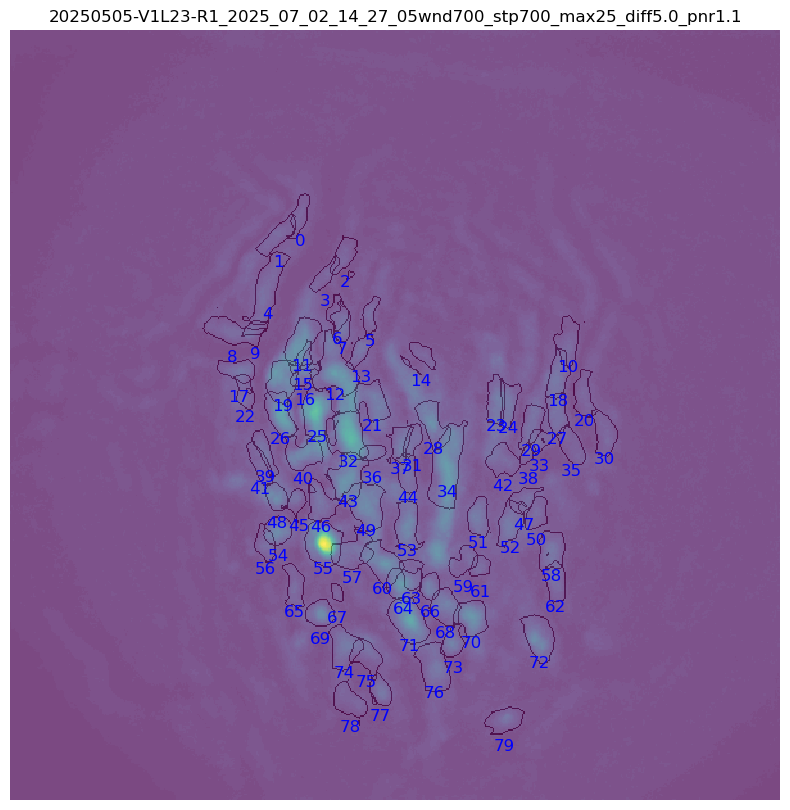

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


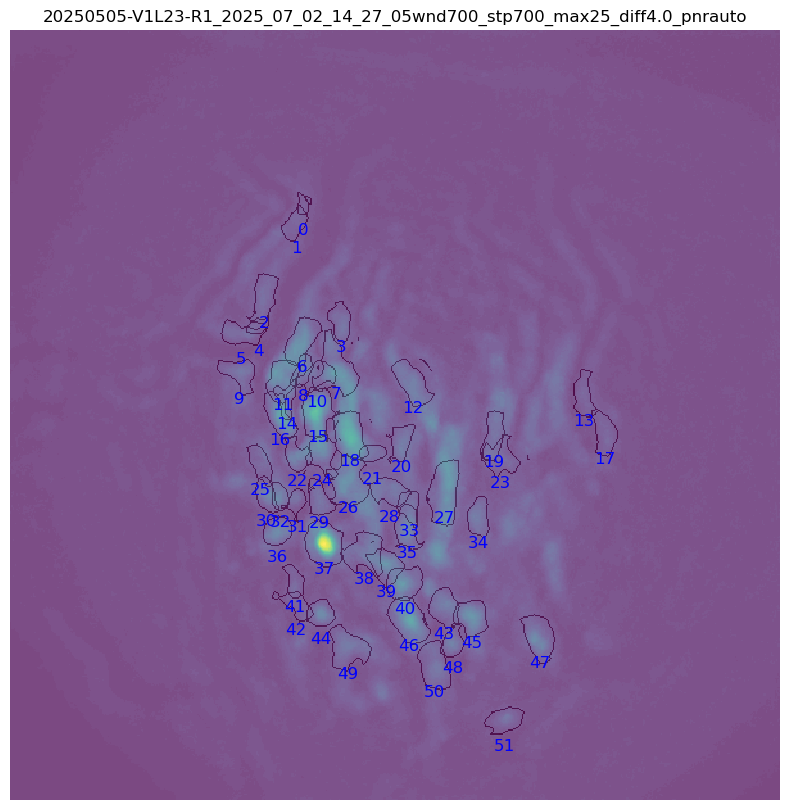

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnrauto.nc


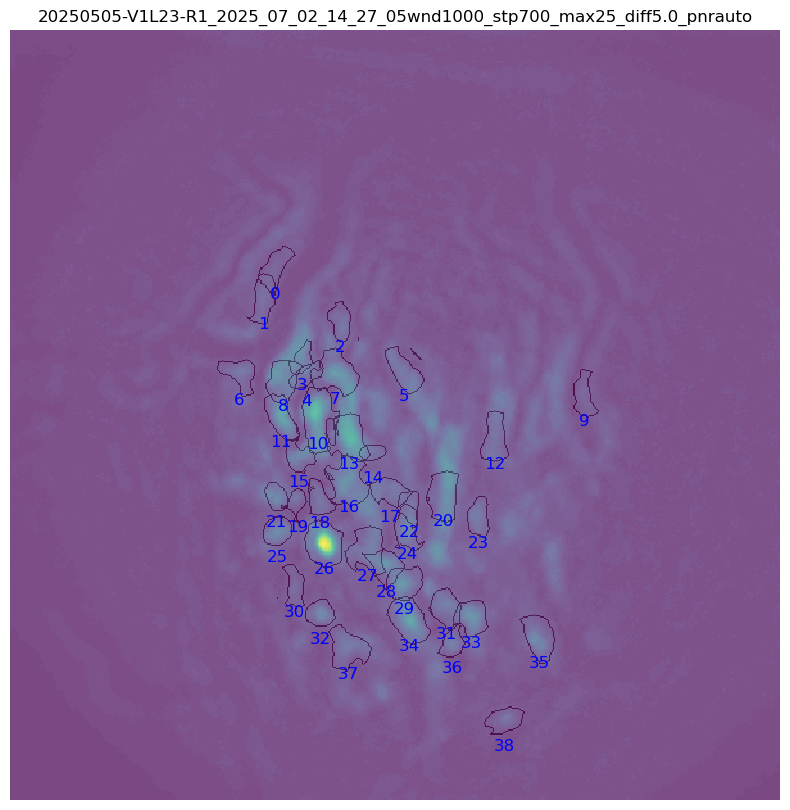

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


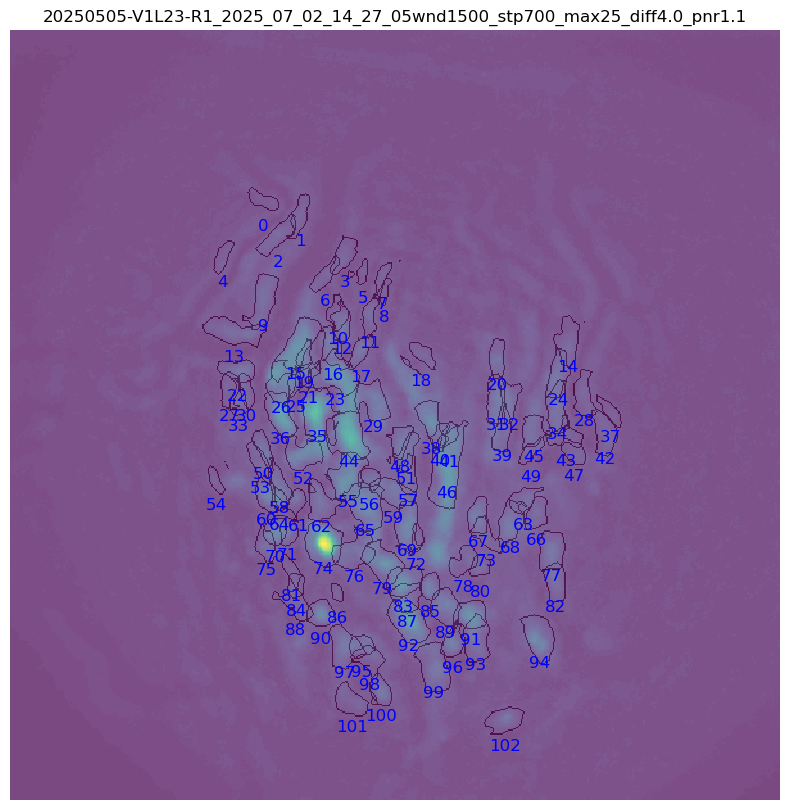

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


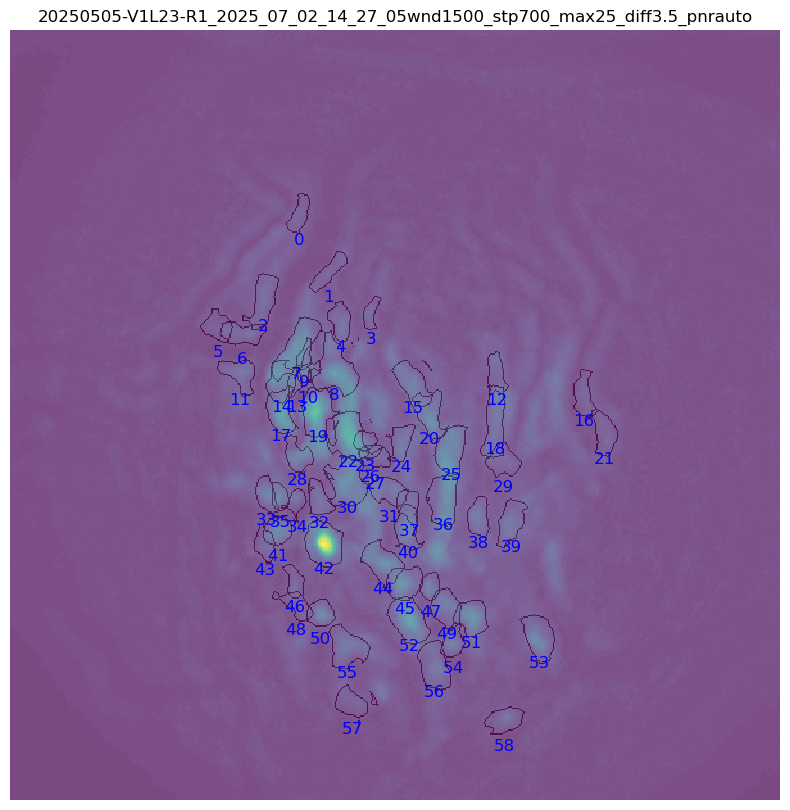

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


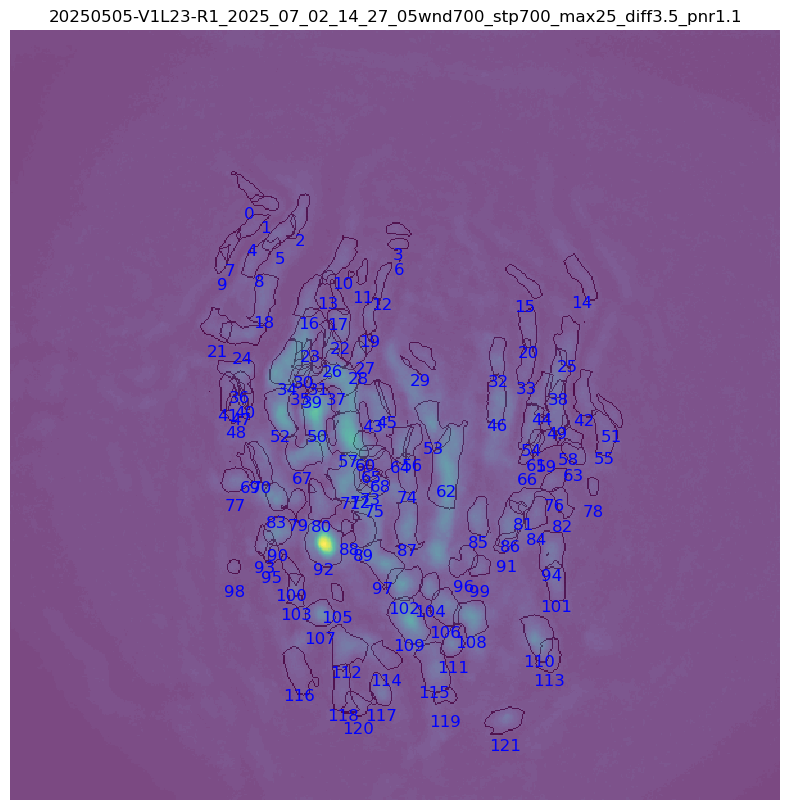

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


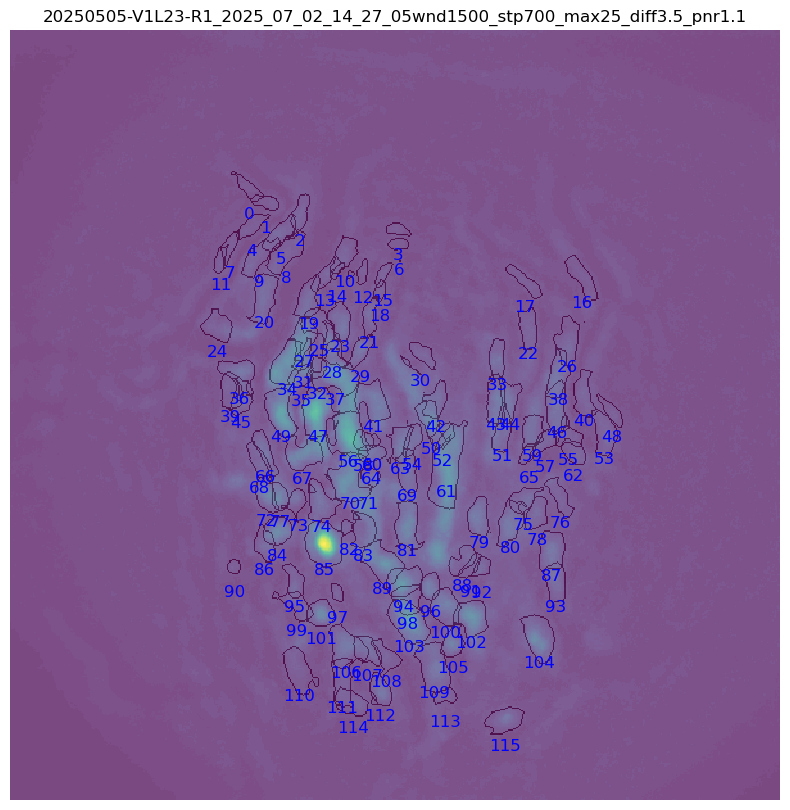

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


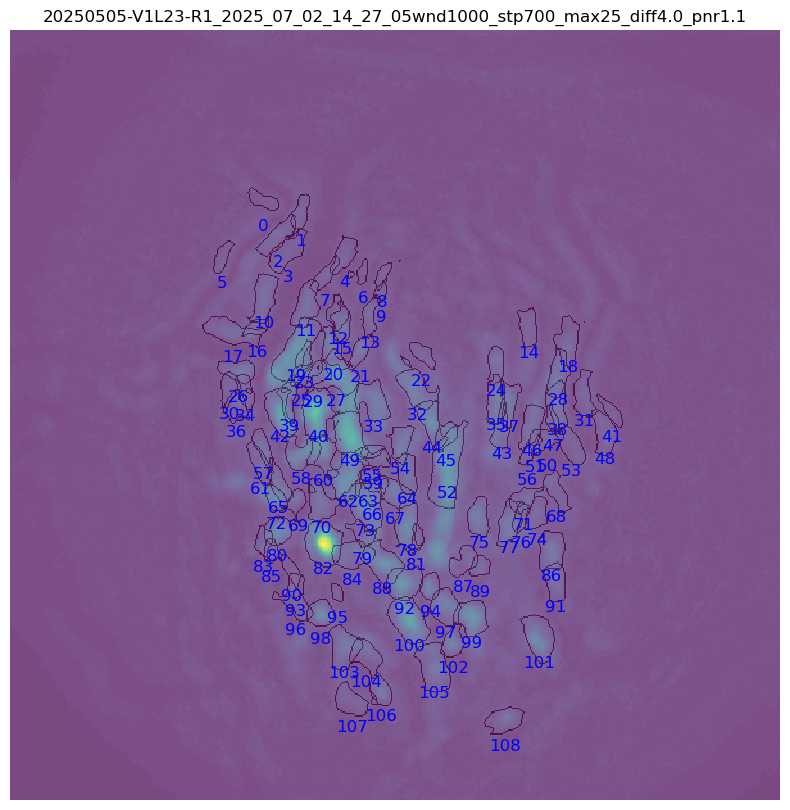

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


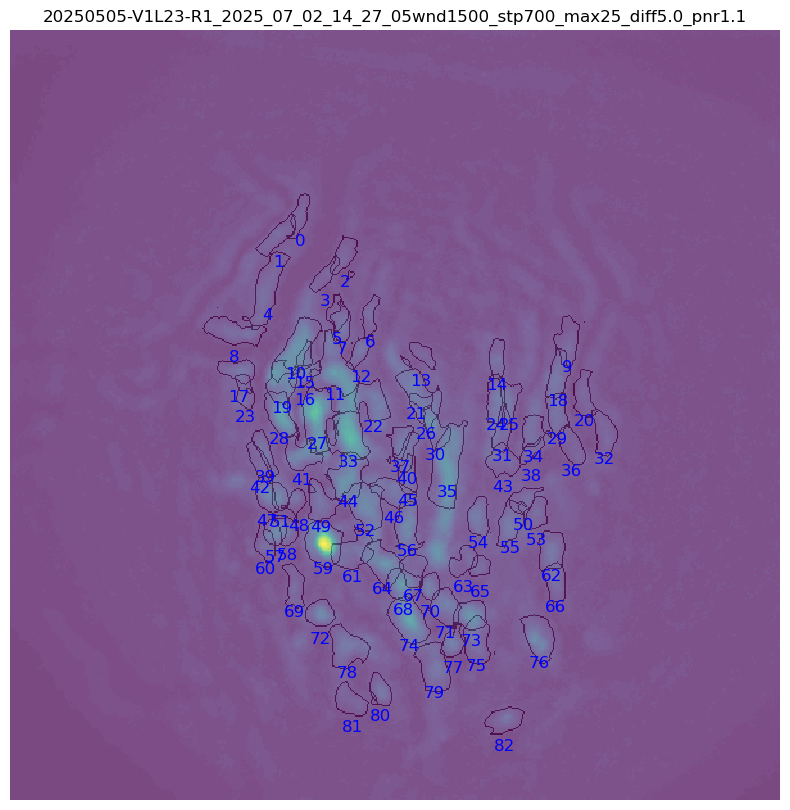

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


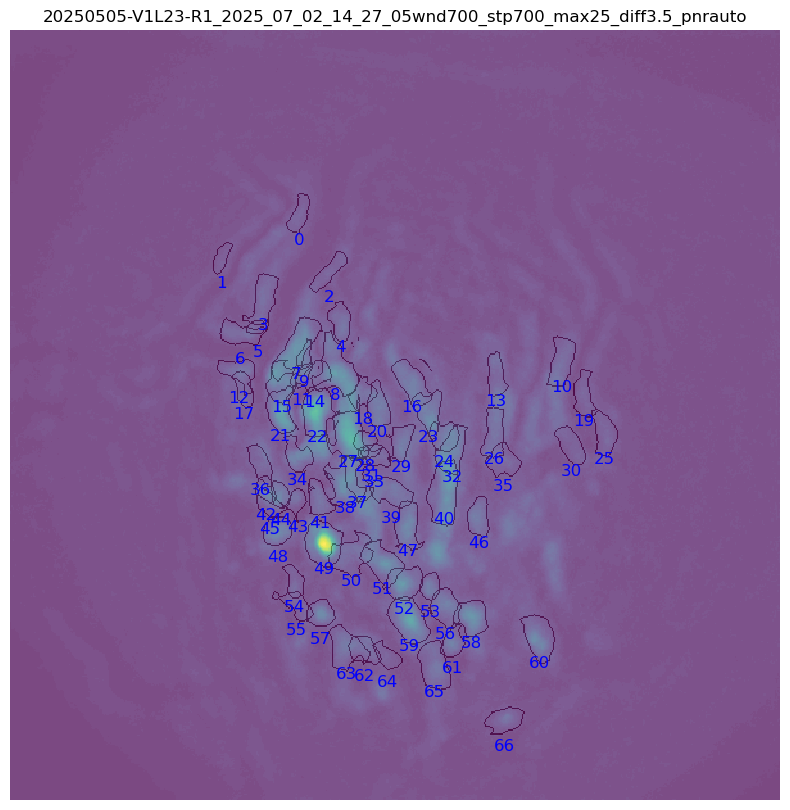

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


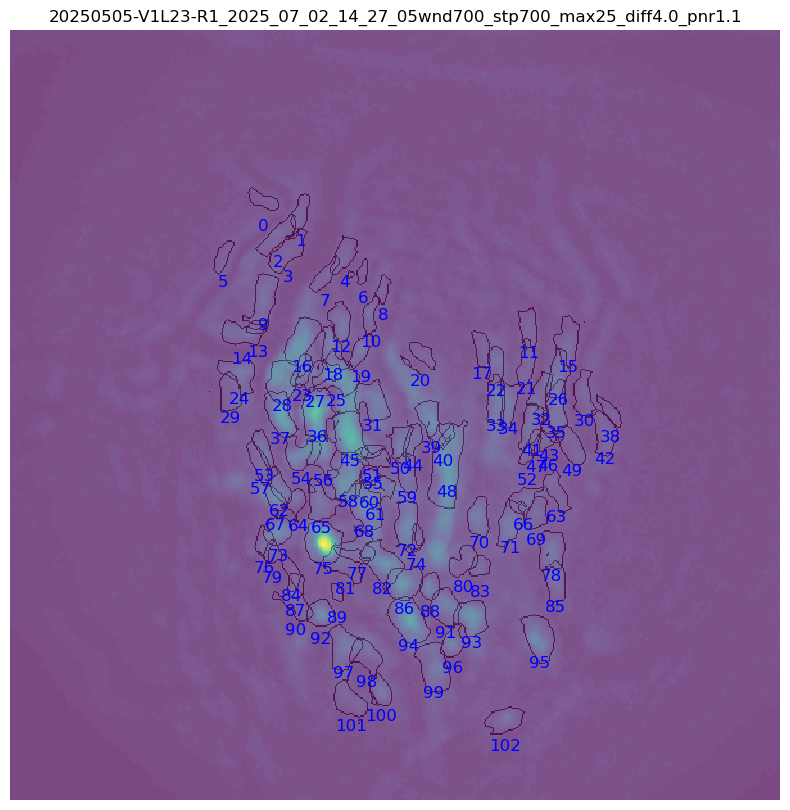

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnrauto.nc


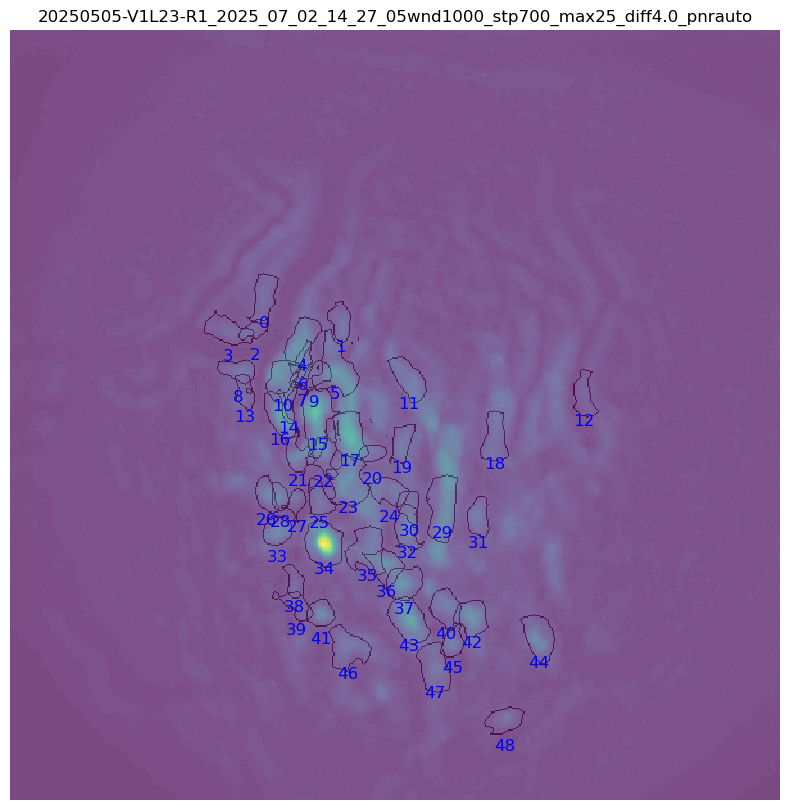

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


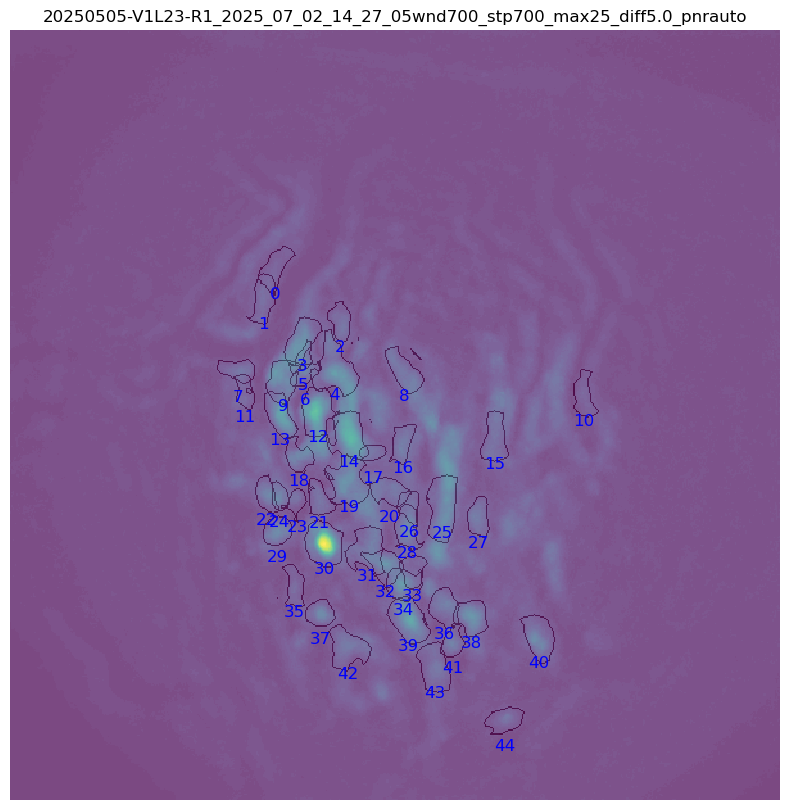

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_27_05/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


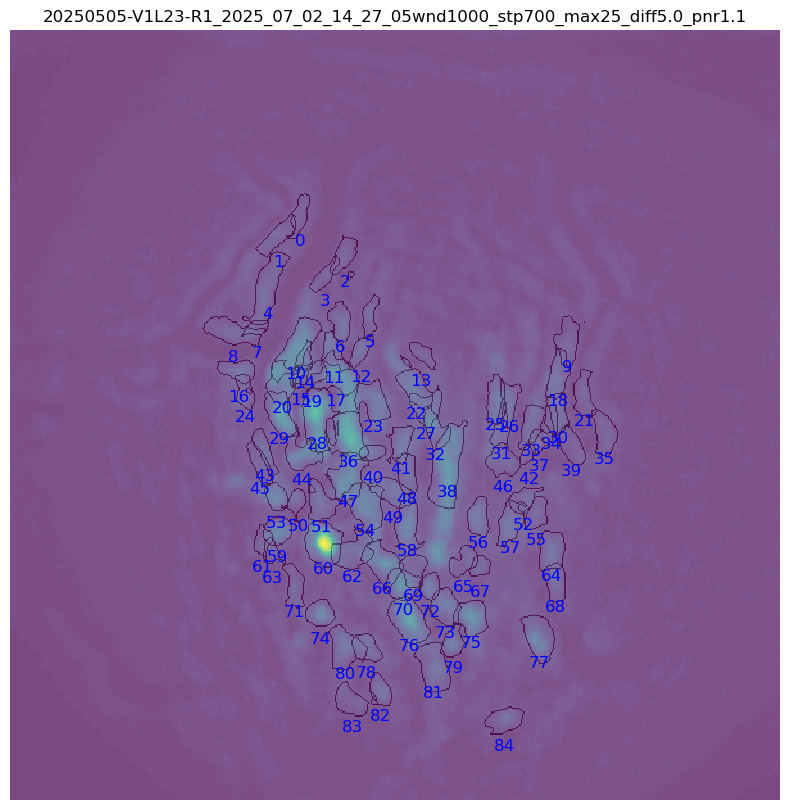


=== Running vis_param_opti for session ===
Animal:       20250505-V1L23-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope
Found 18 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/20

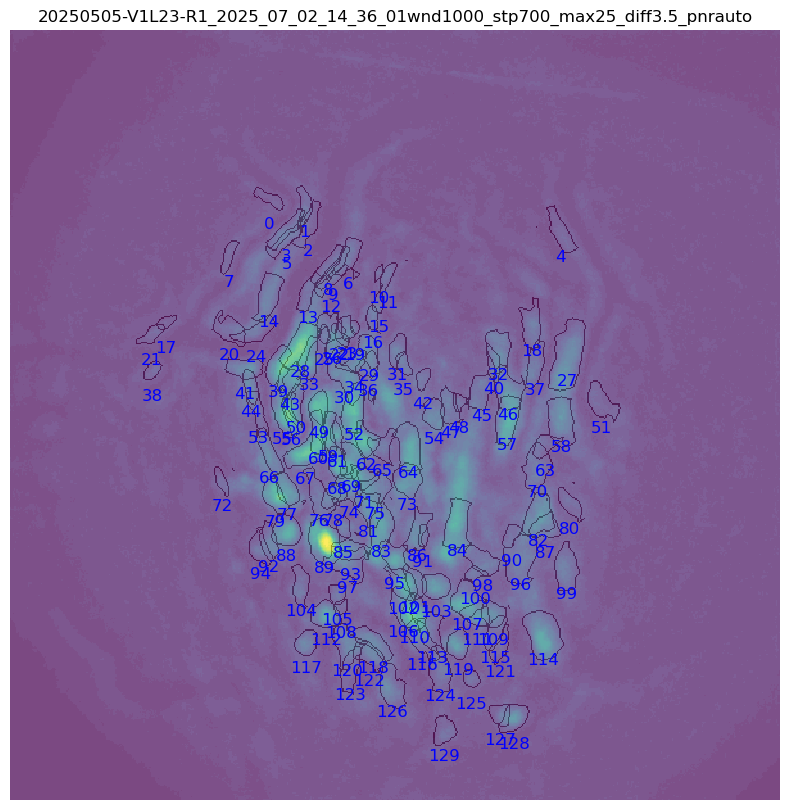

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc


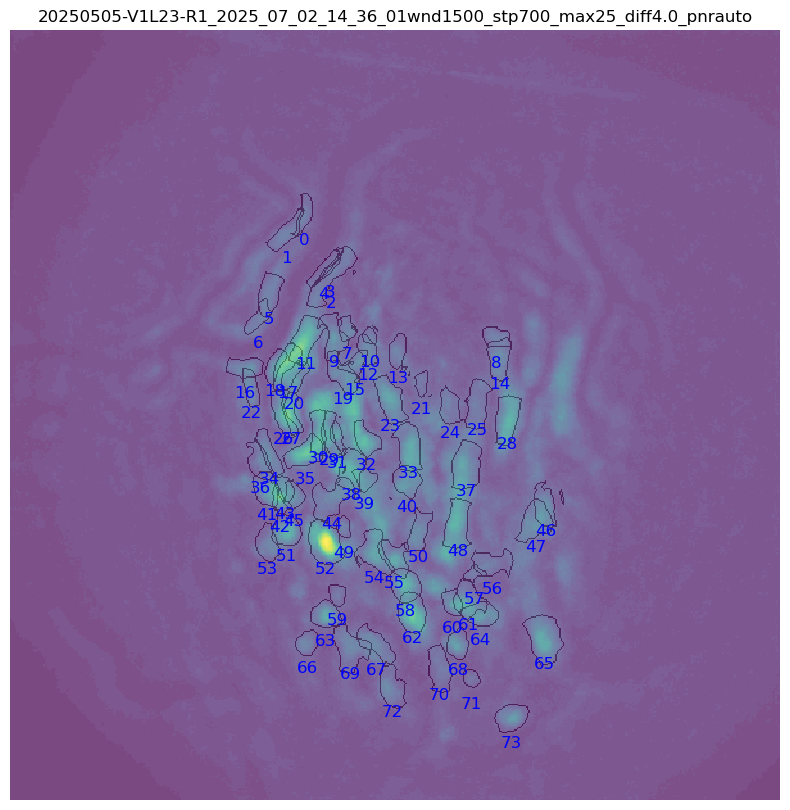

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


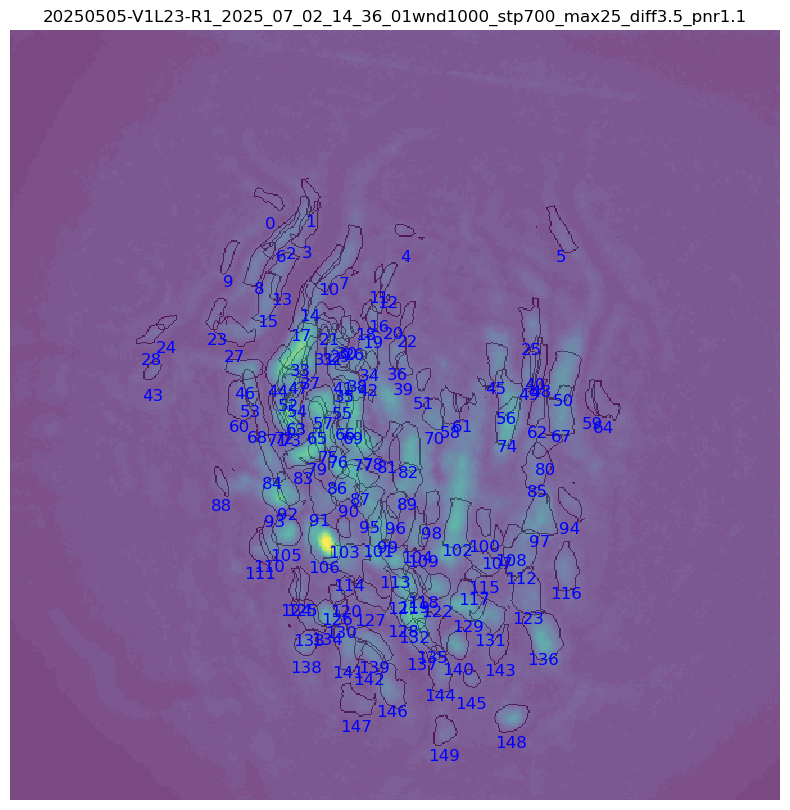

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


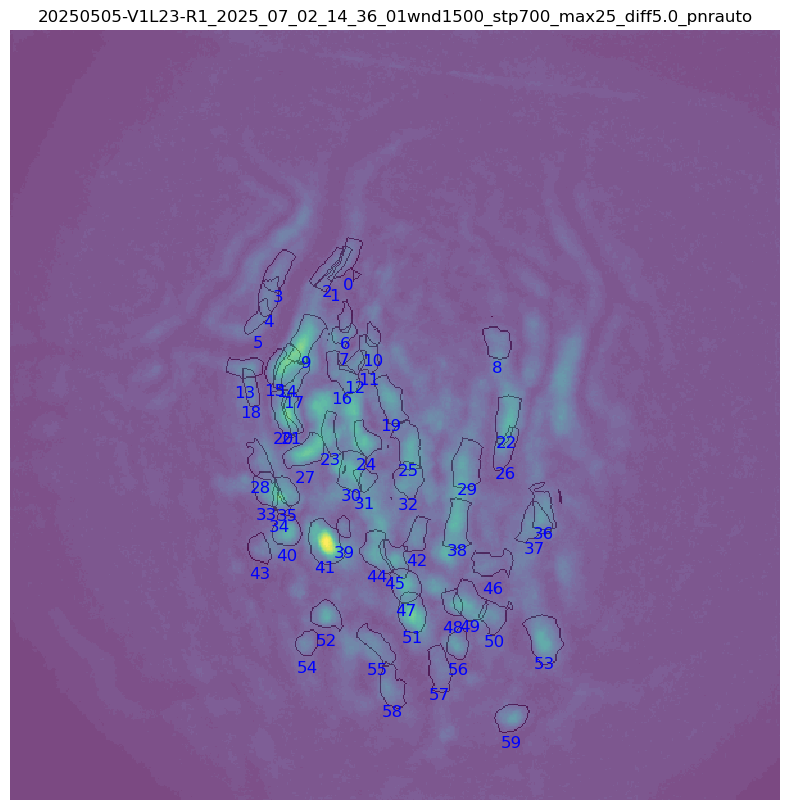

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


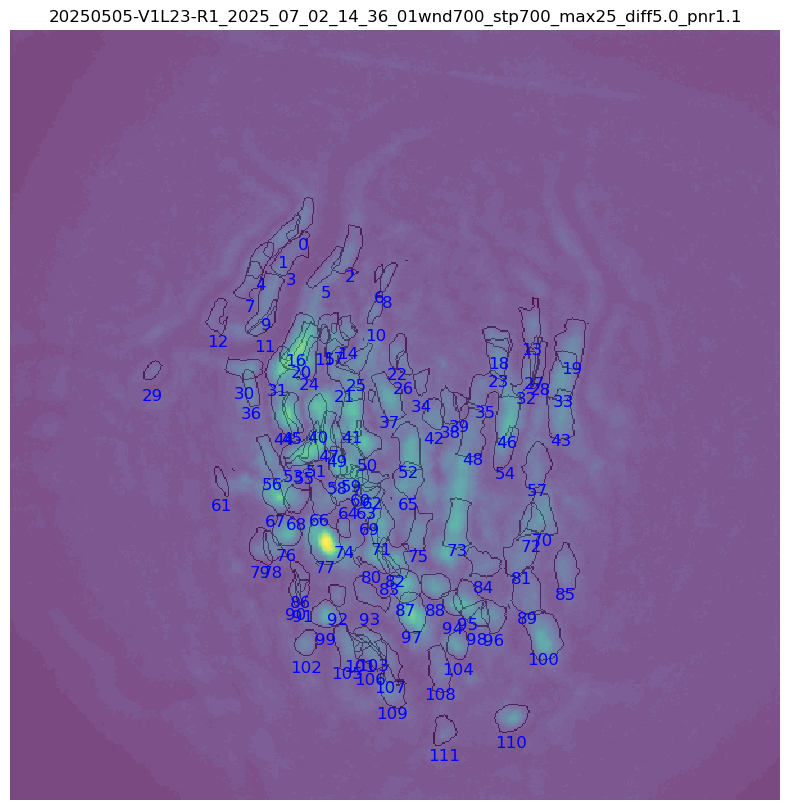

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


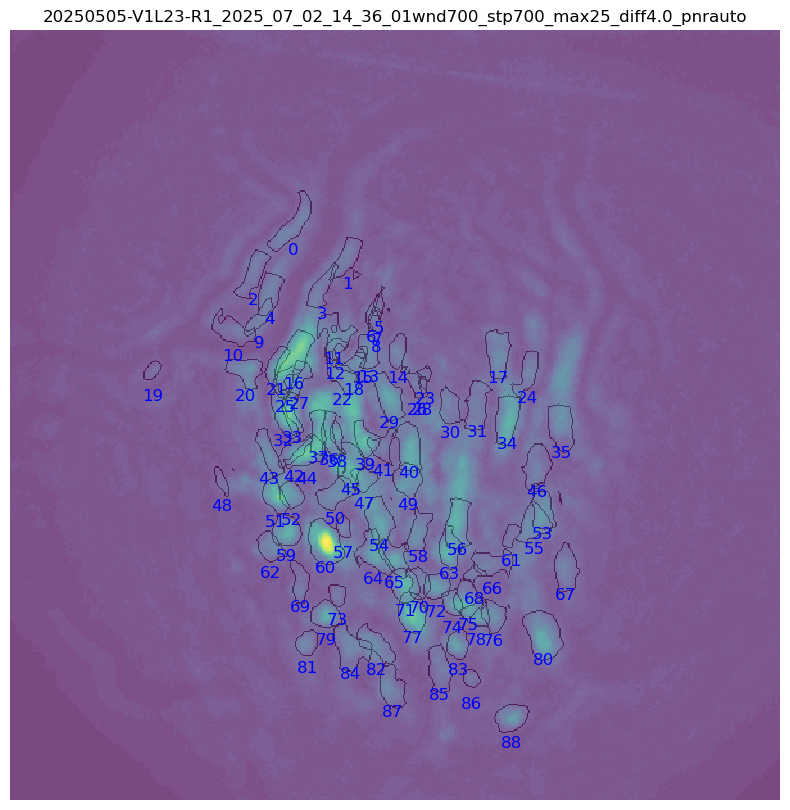

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnrauto.nc


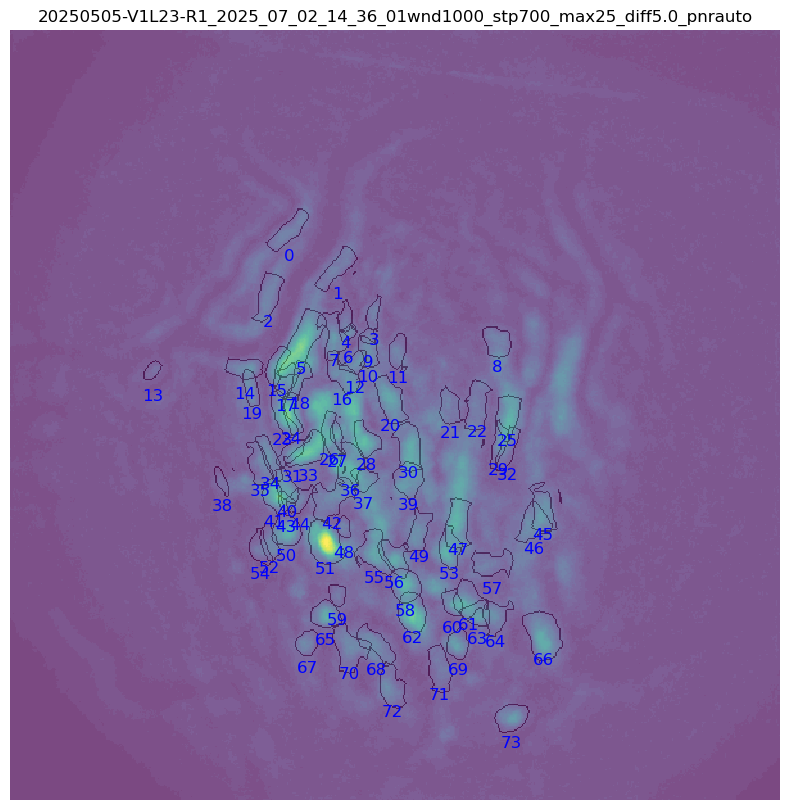

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


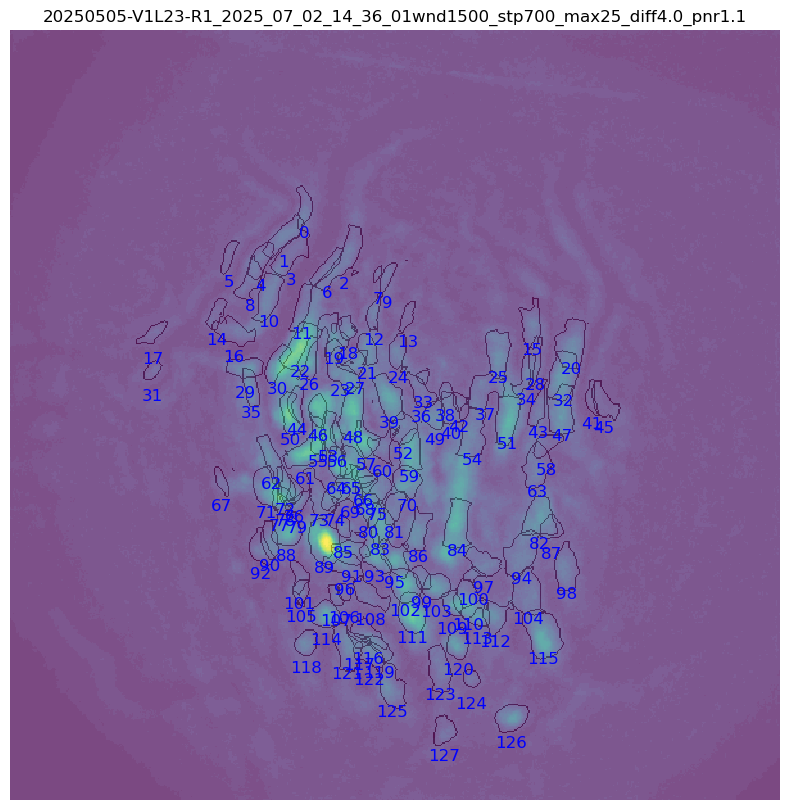

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


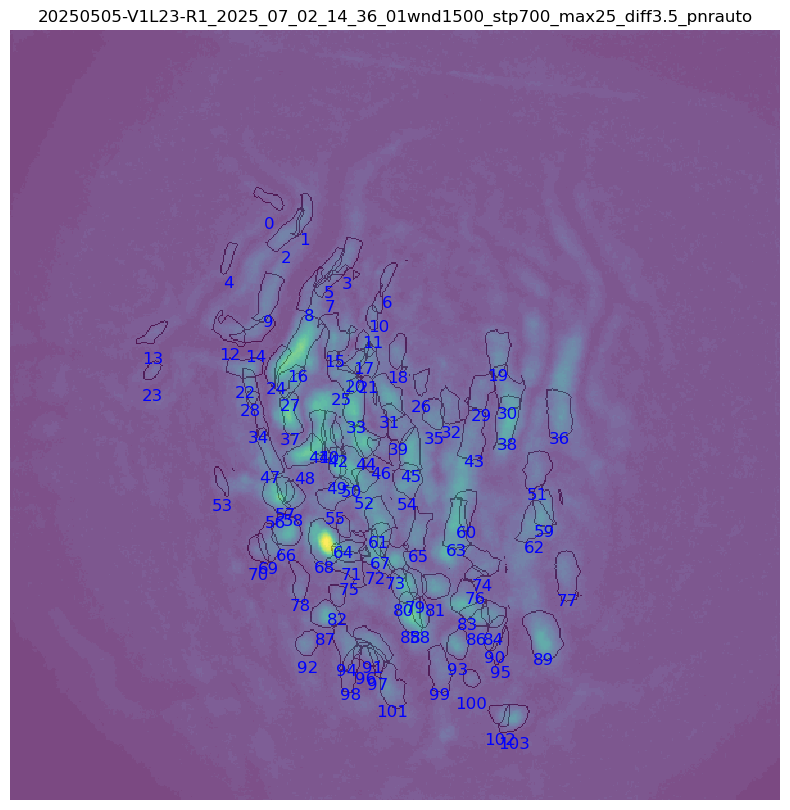

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


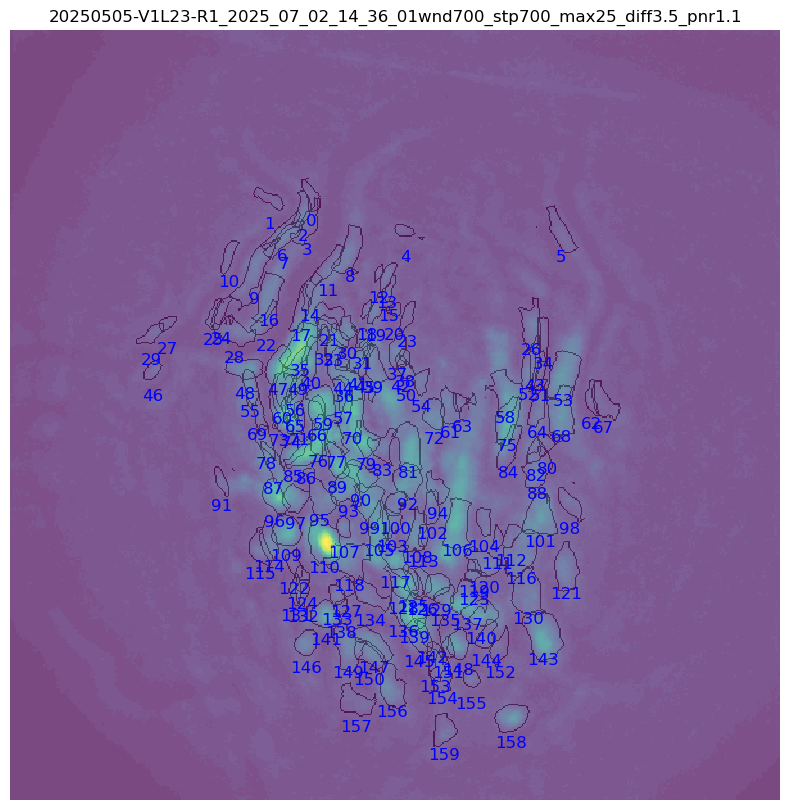

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


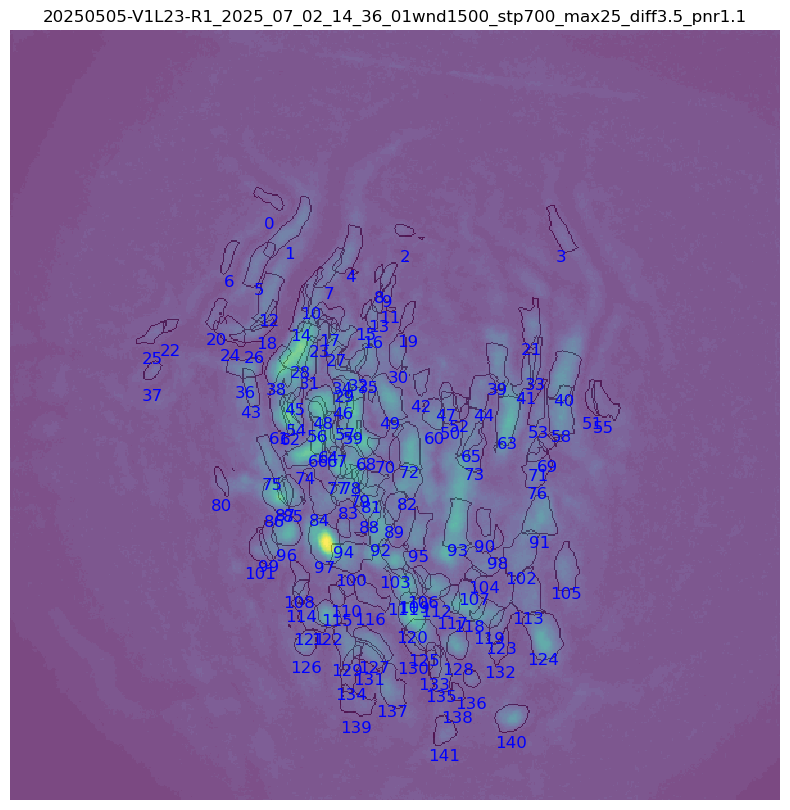

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


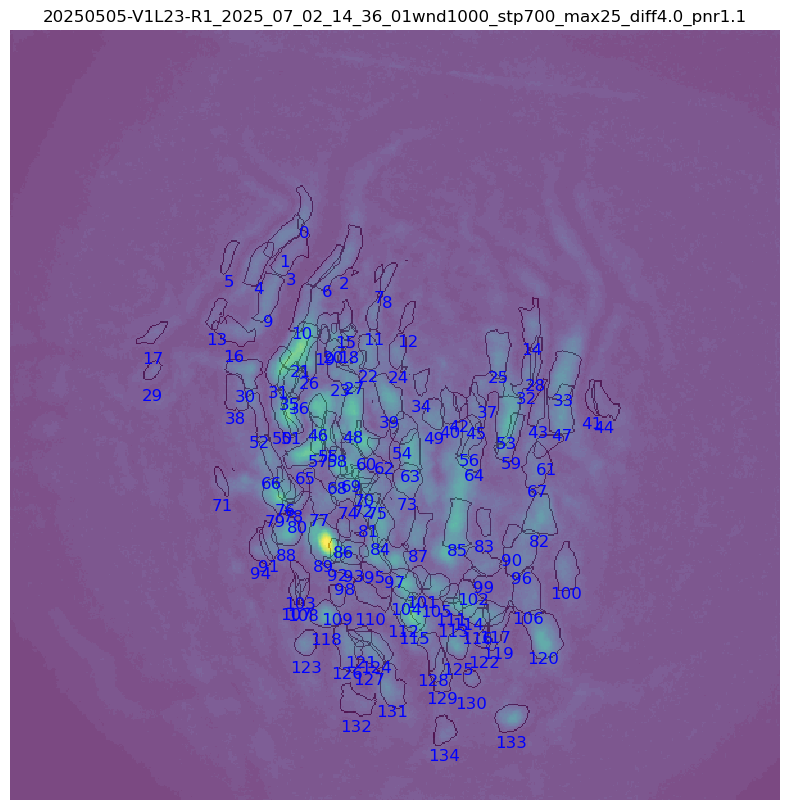

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


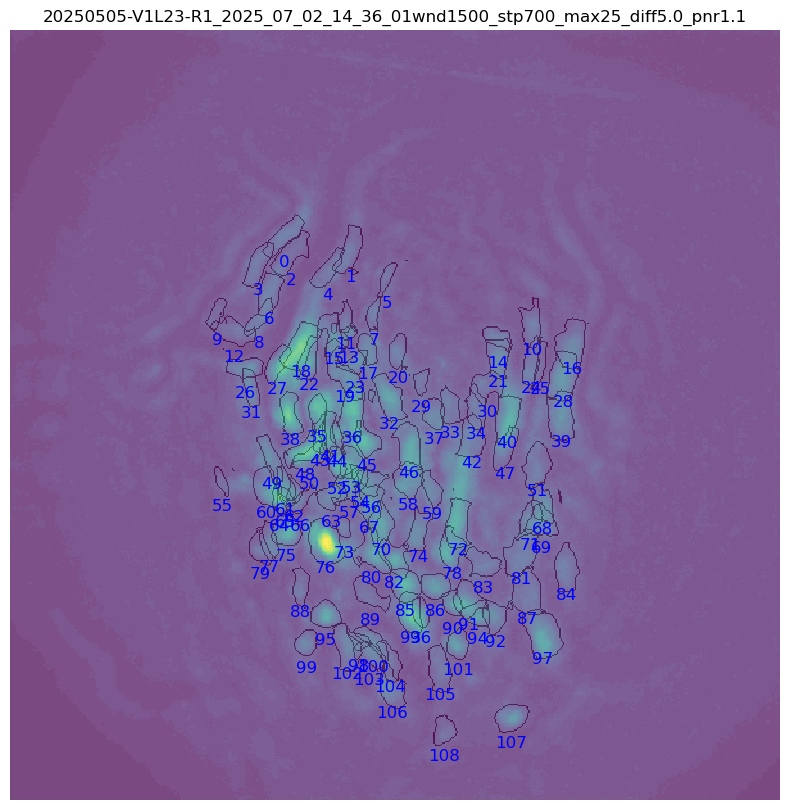

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


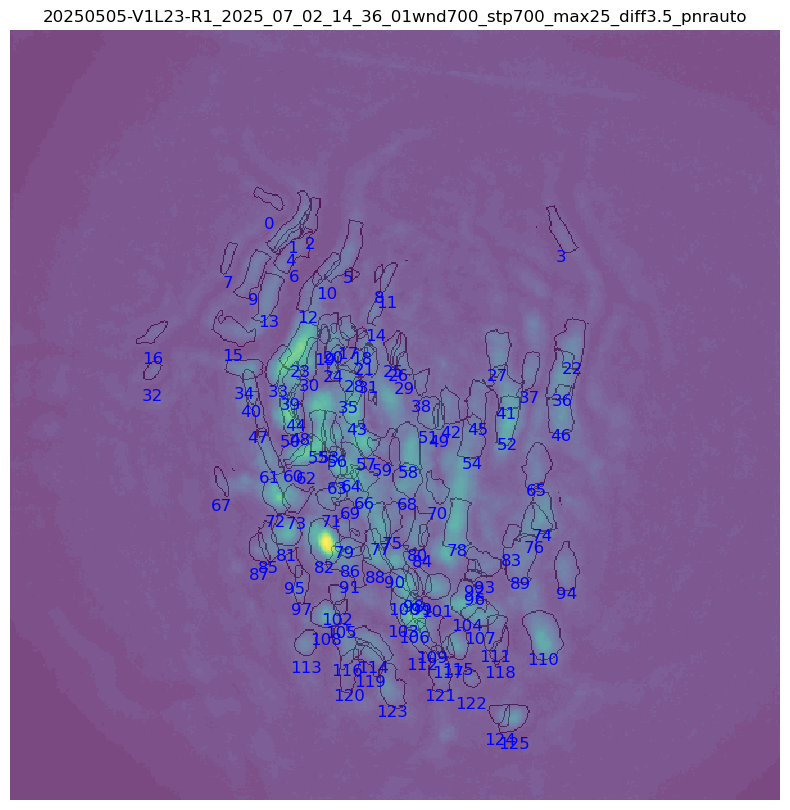

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


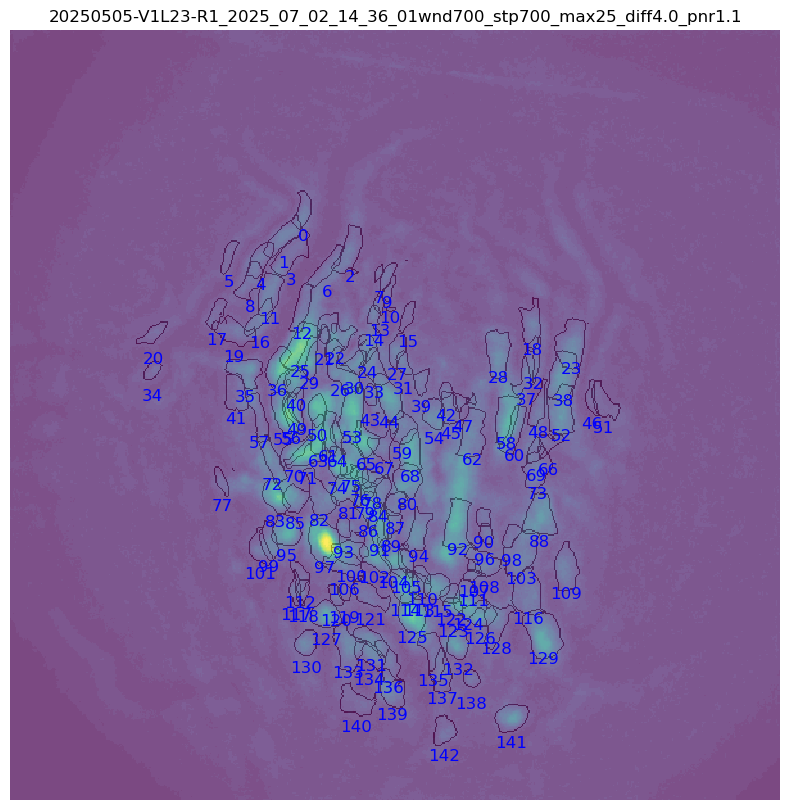

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnrauto.nc


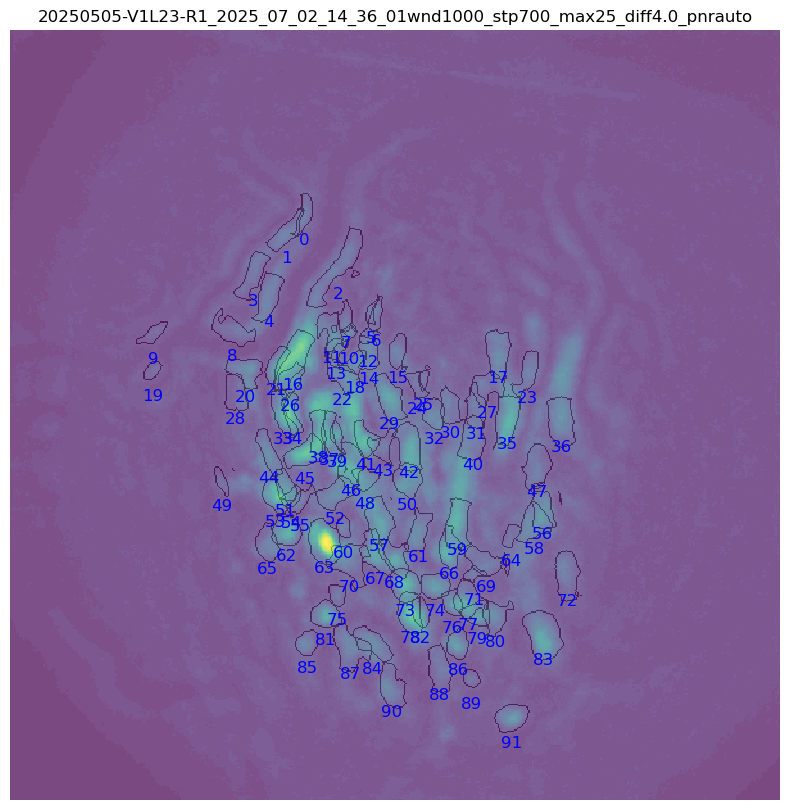

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


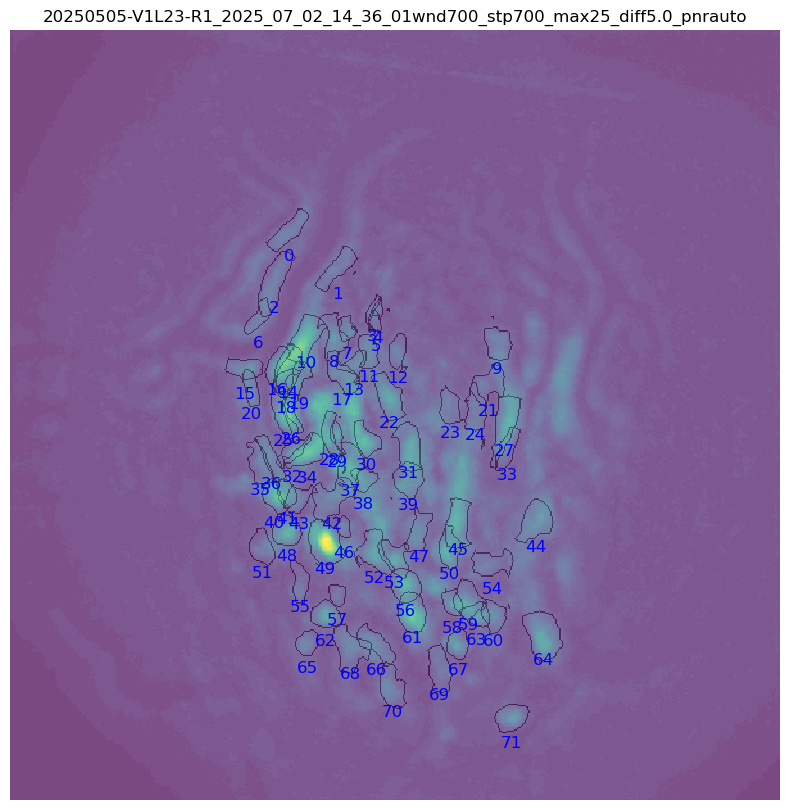

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_36_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


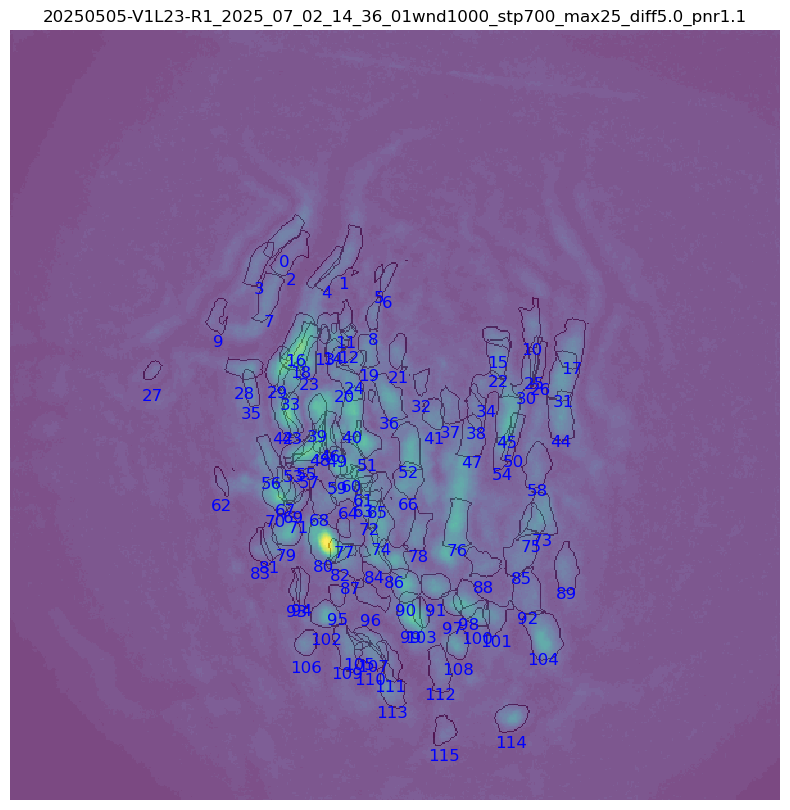


=== Running vis_param_opti for session ===
Animal:       202401015-PMC-r2
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope
Found 19 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_datas

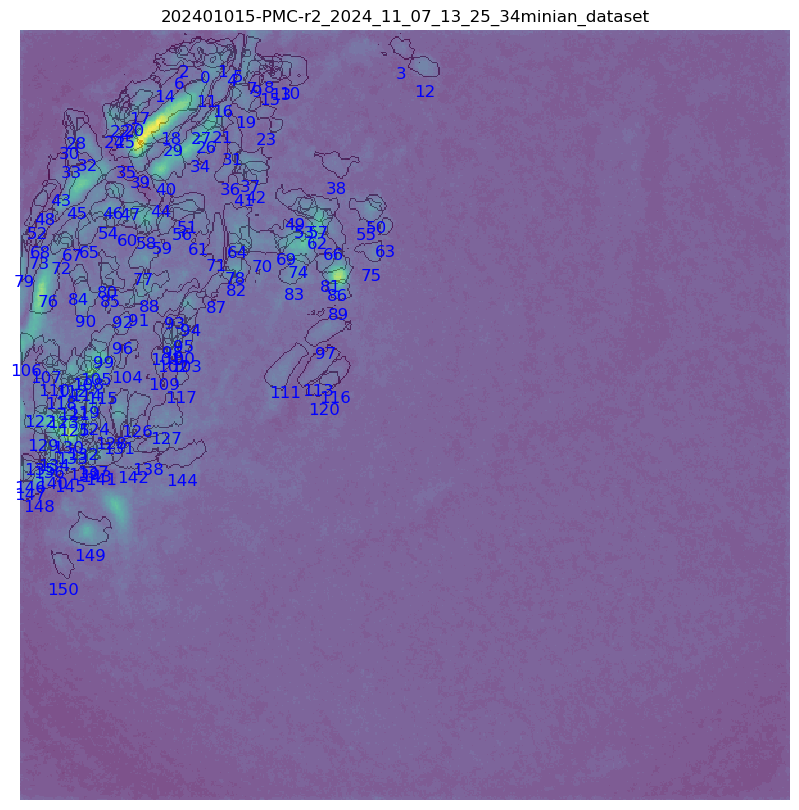

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff4.0_pnrauto.nc


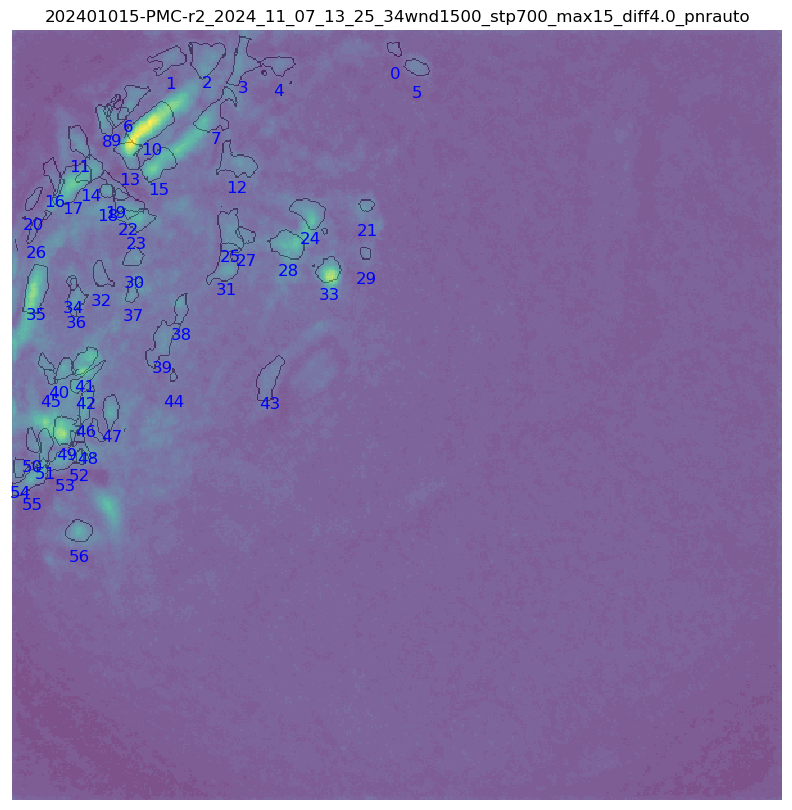

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff5.0_pnr1.1.nc


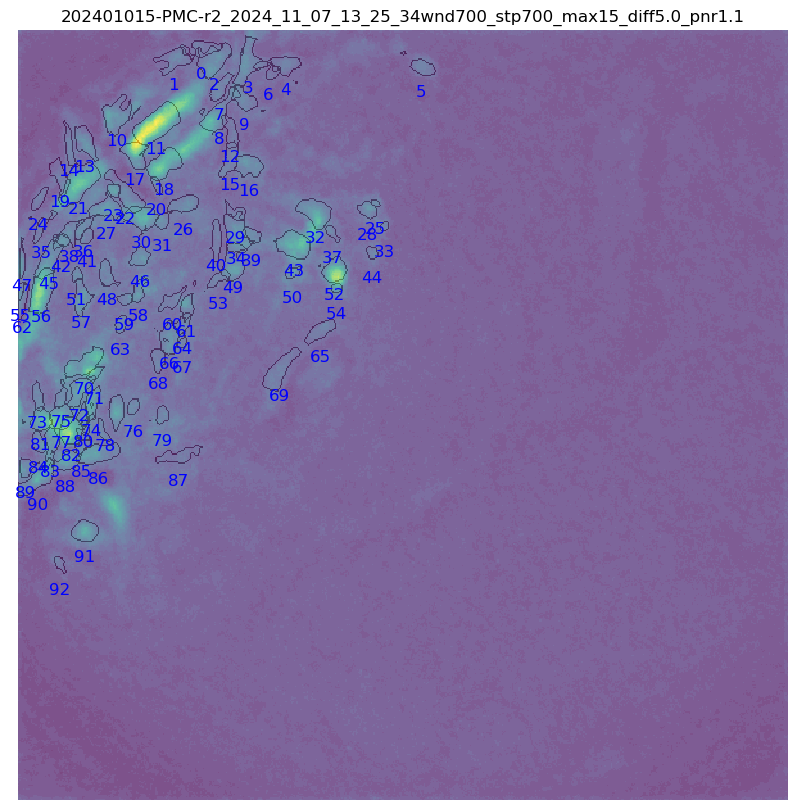

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff5.0_pnr1.1.nc


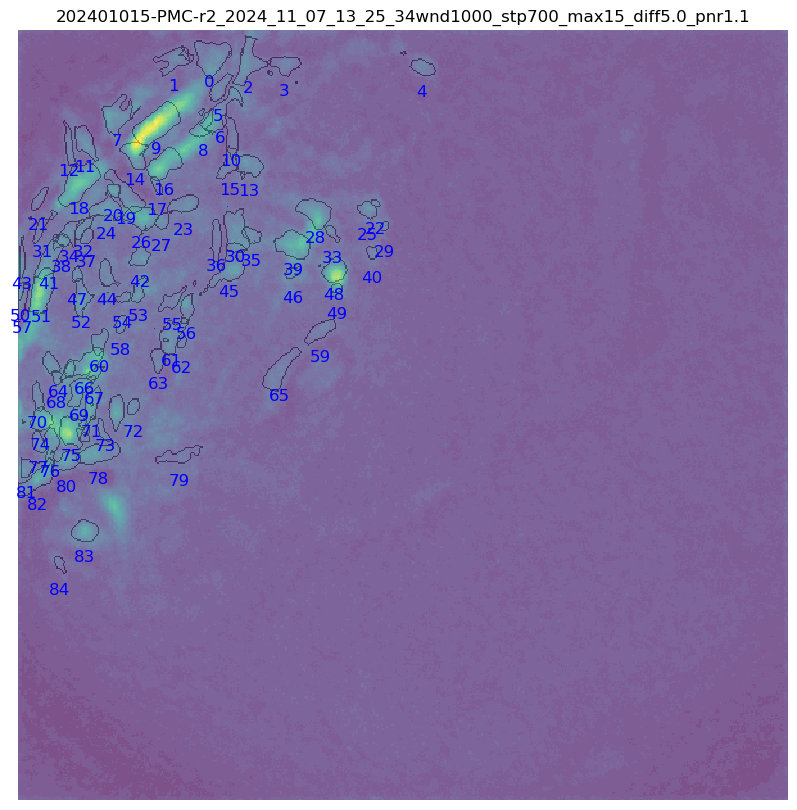

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff5.0_pnrauto.nc


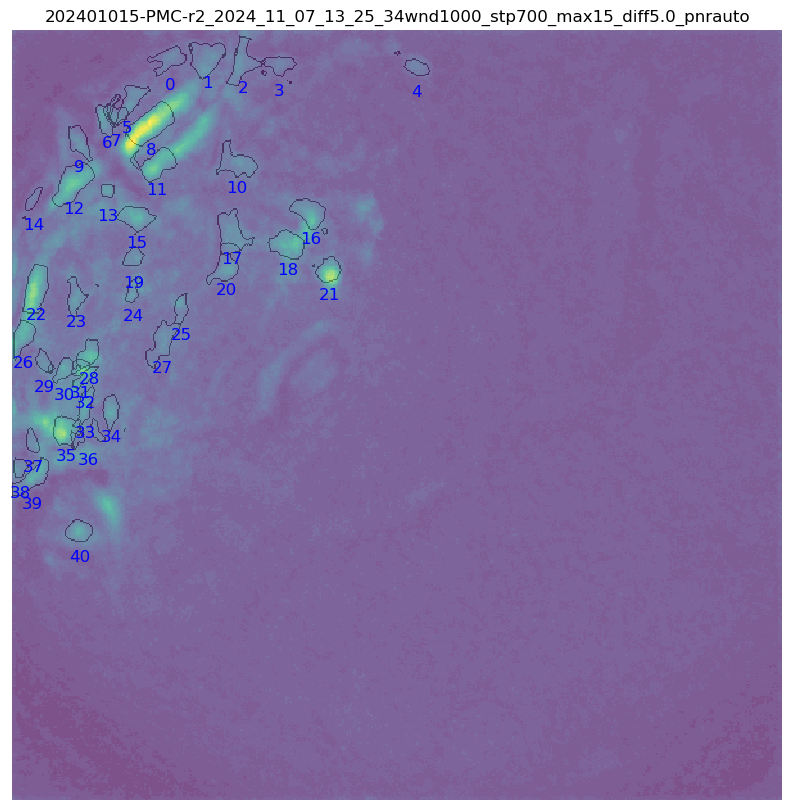

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff4.0_pnr1.1.nc


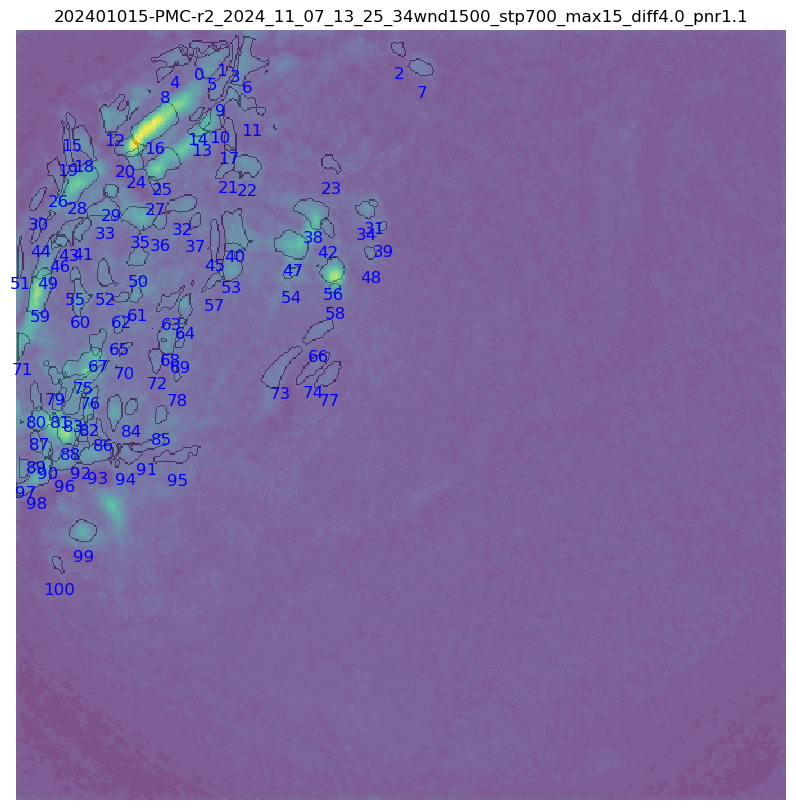

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff3.5_pnrauto.nc


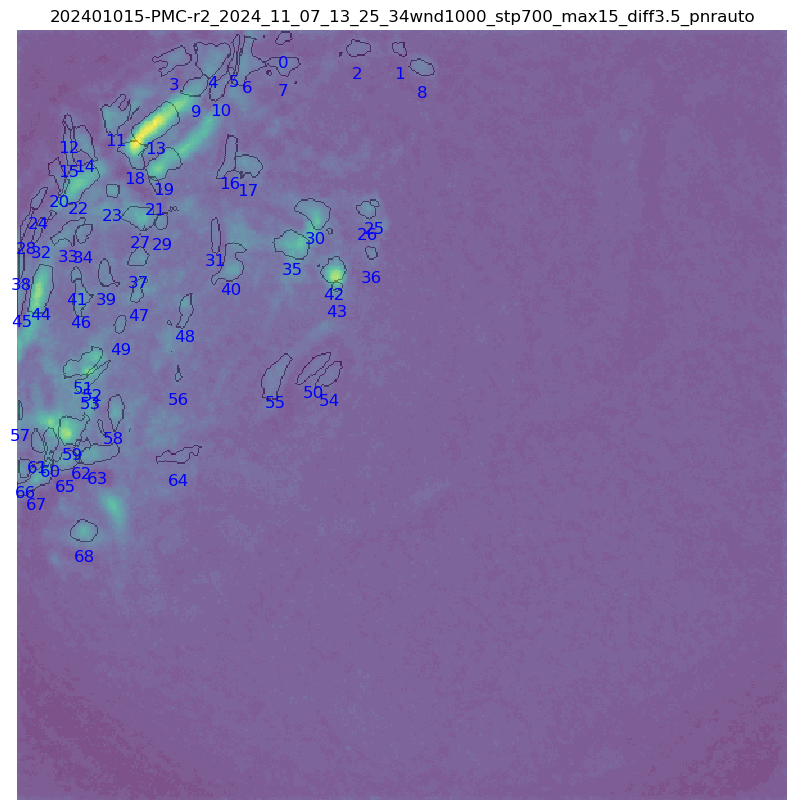

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff4.0_pnr1.1.nc


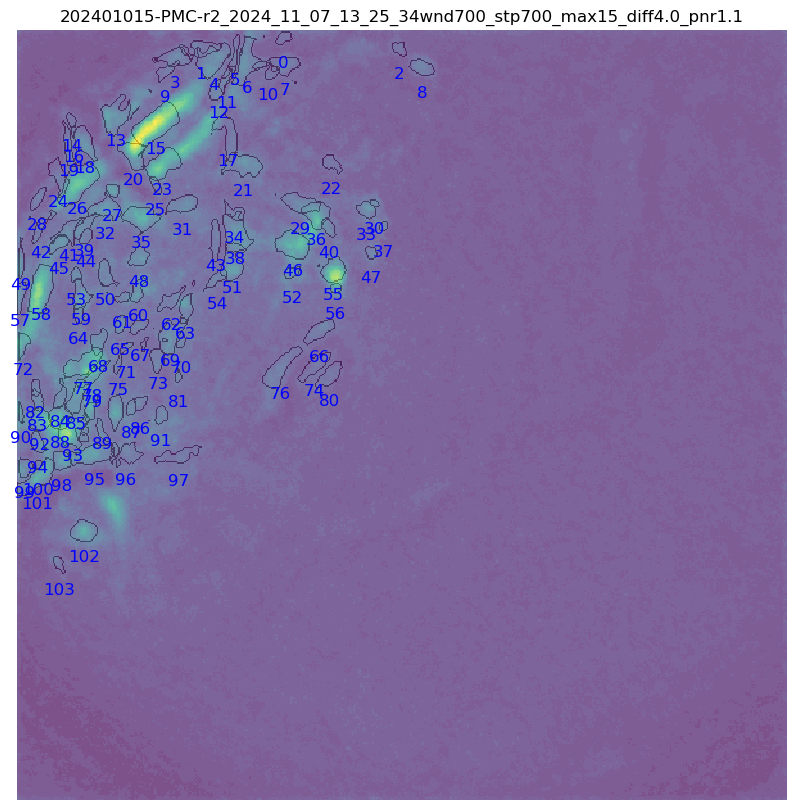

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff3.5_pnr1.1.nc


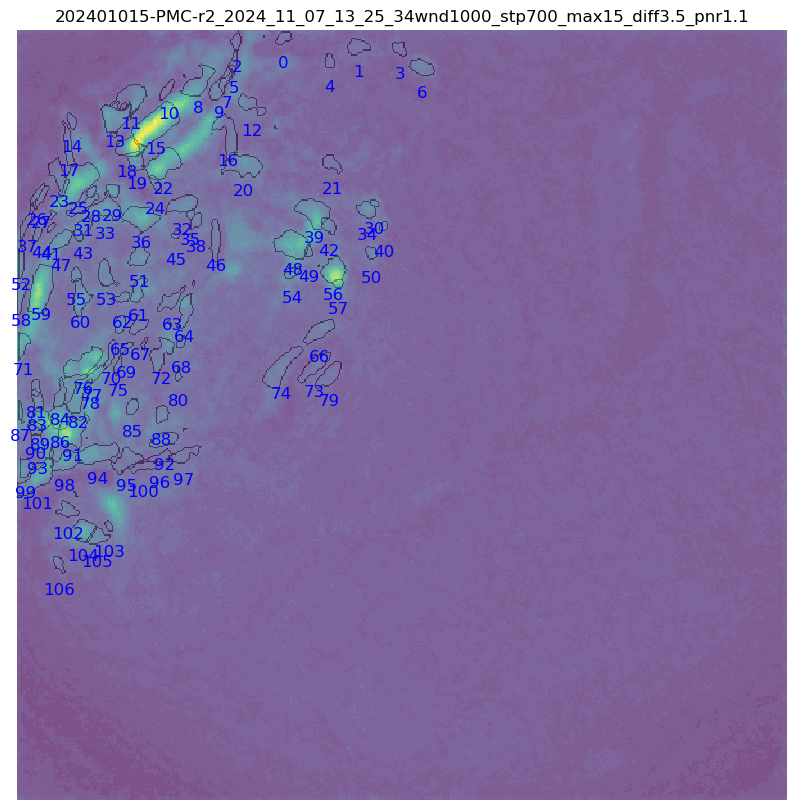

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnrauto.nc


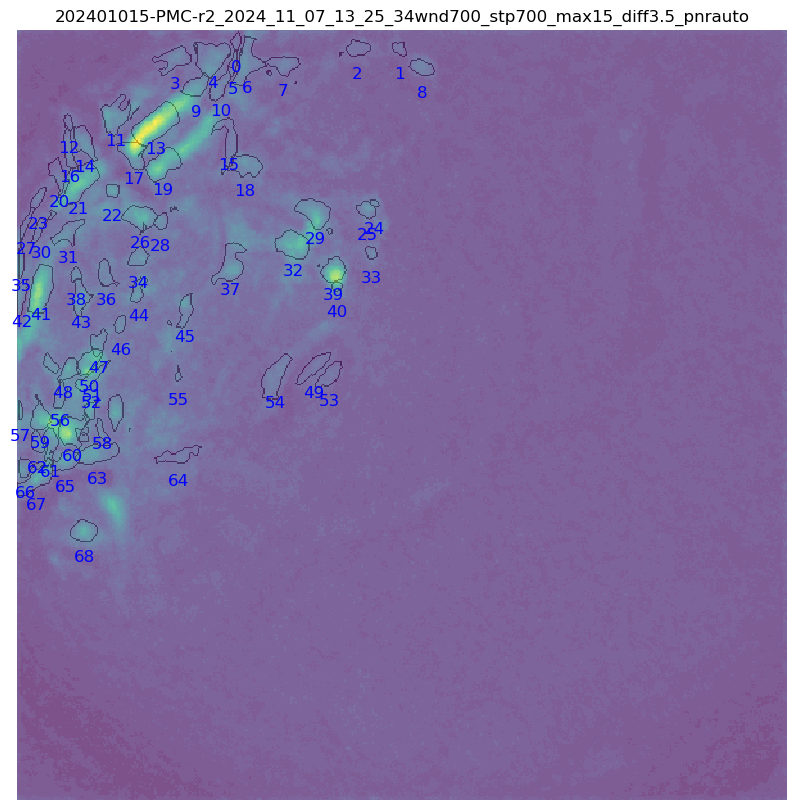

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff5.0_pnrauto.nc


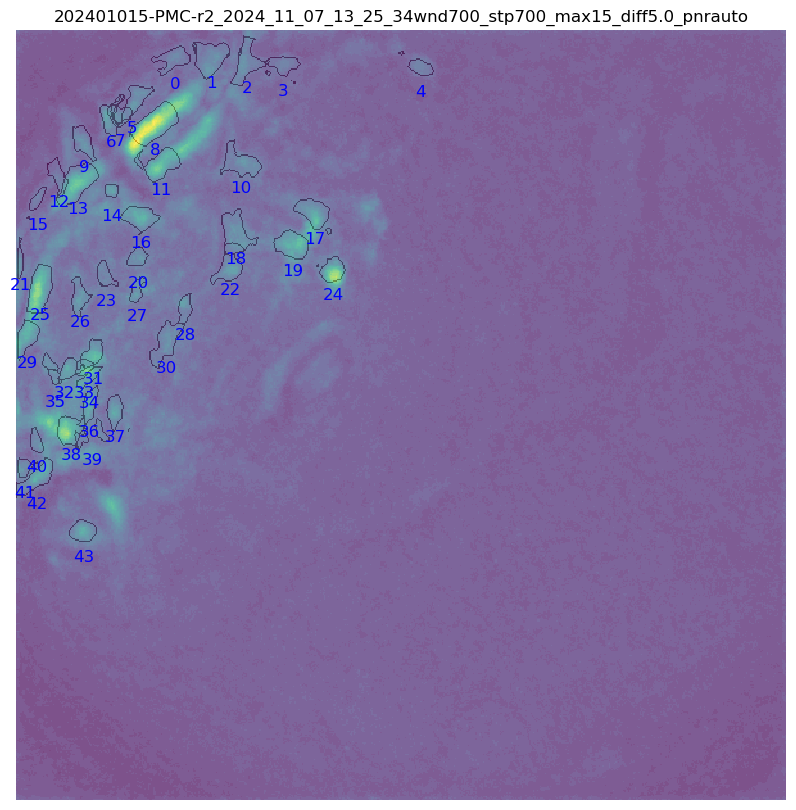

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnr1.1.nc


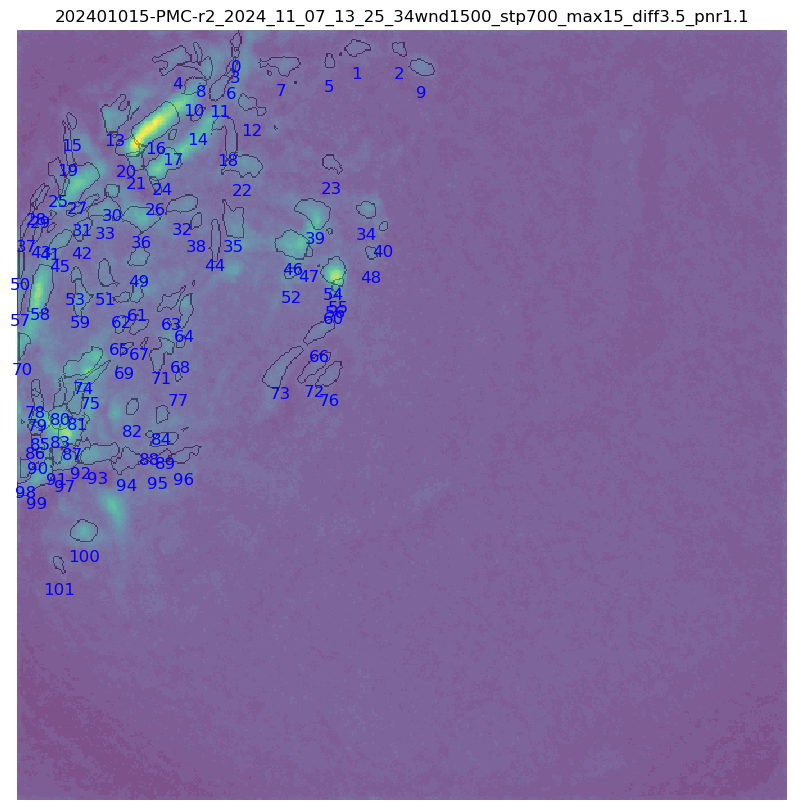

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff4.0_pnr1.1.nc


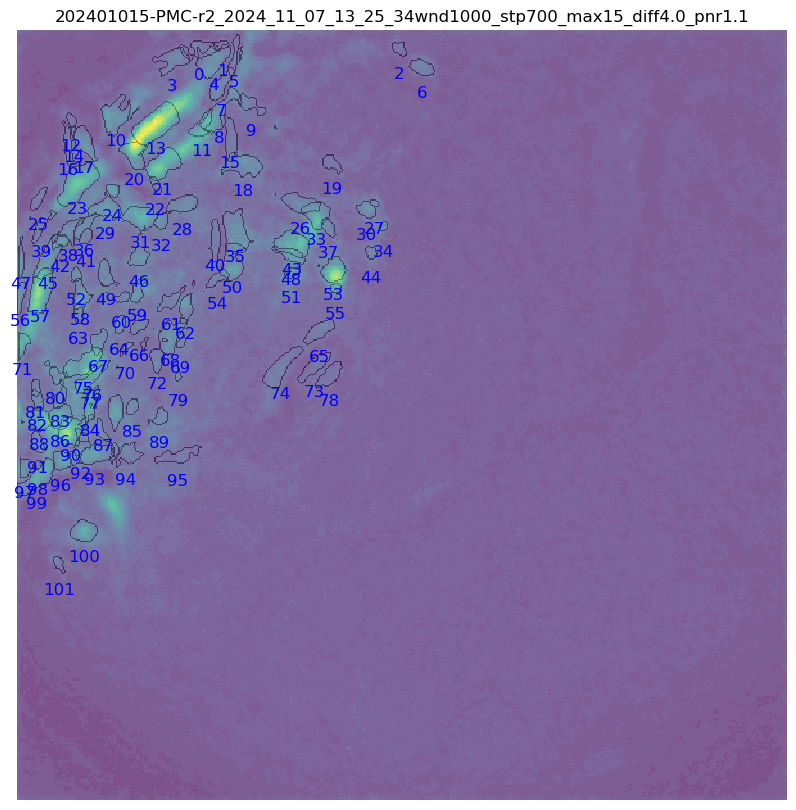

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnr1.1.nc


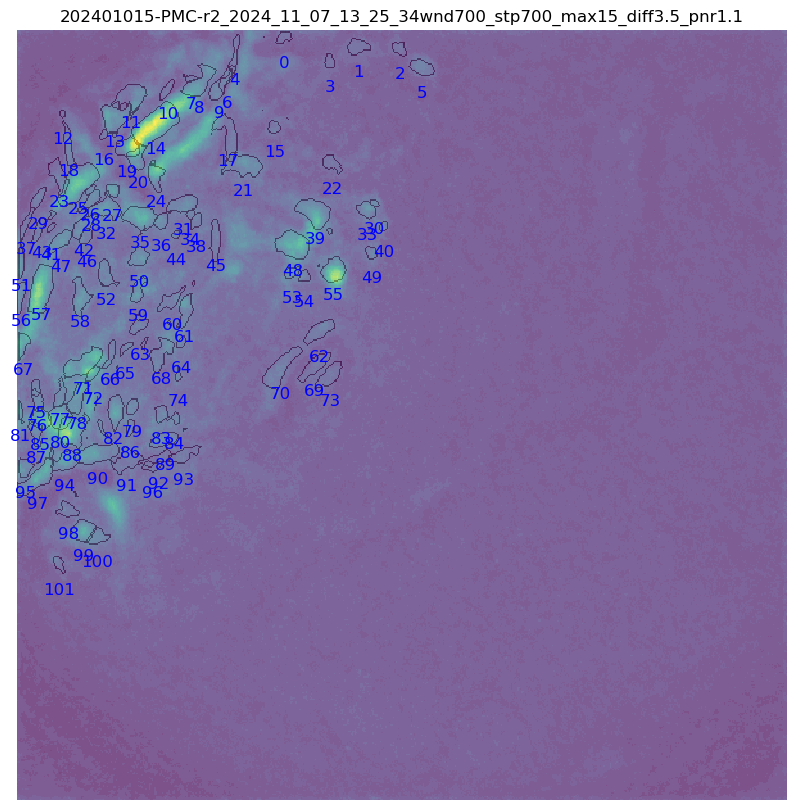

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff5.0_pnrauto.nc


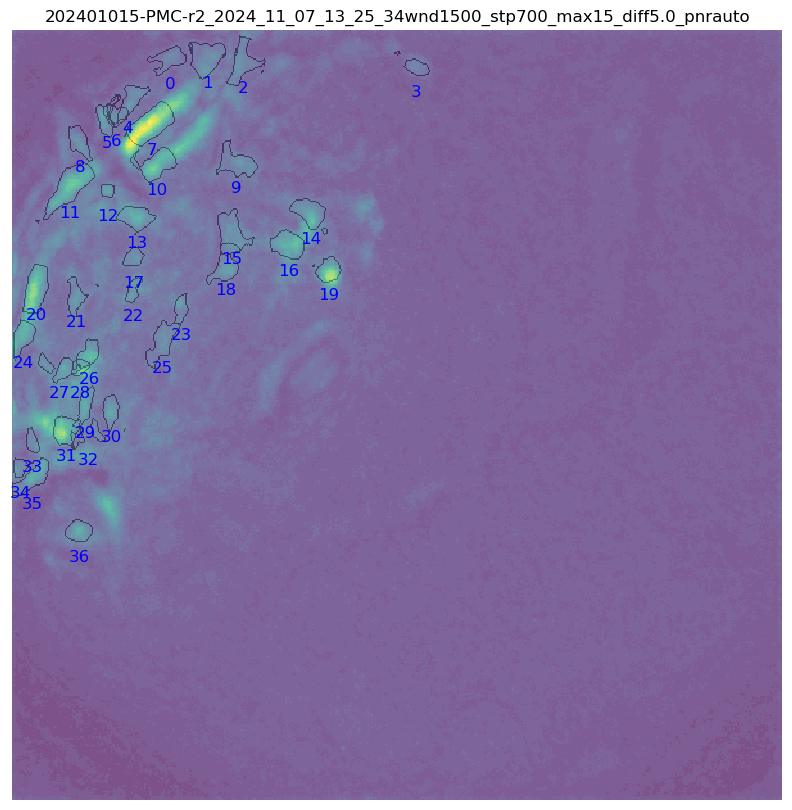

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff5.0_pnr1.1.nc


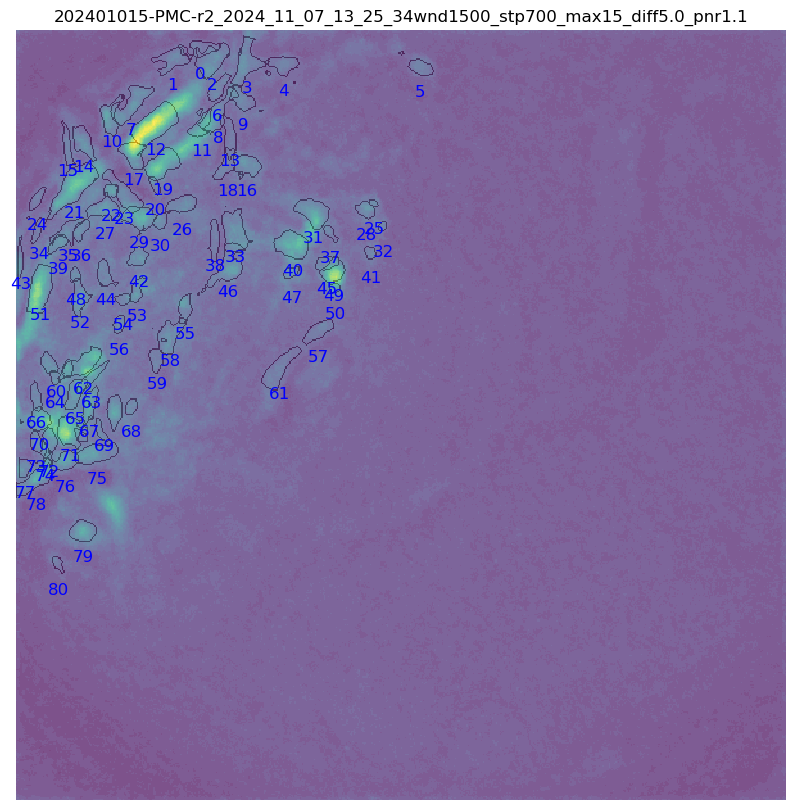

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff4.0_pnrauto.nc


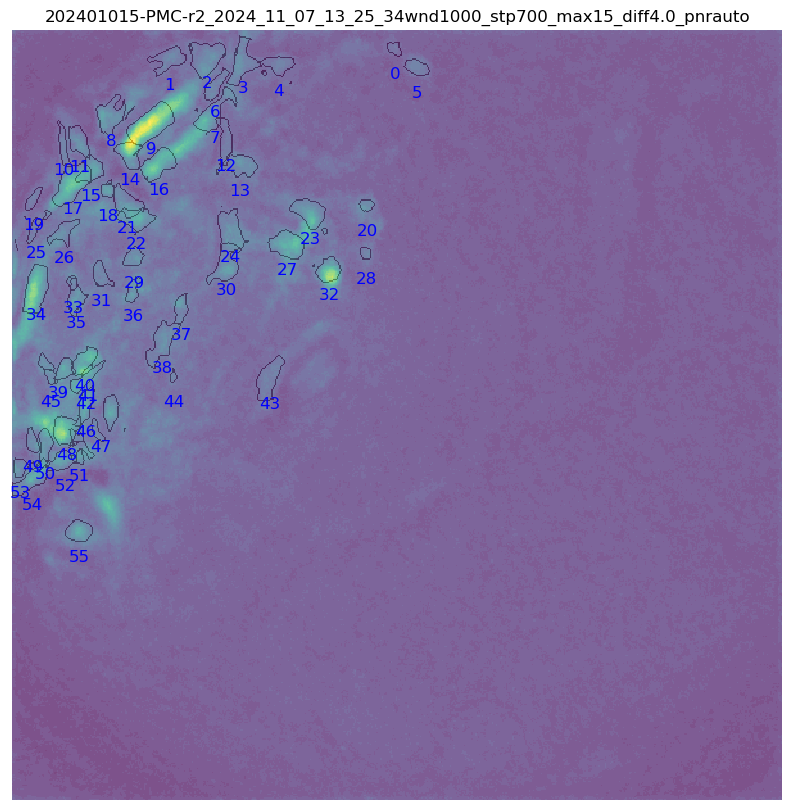

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnrauto.nc


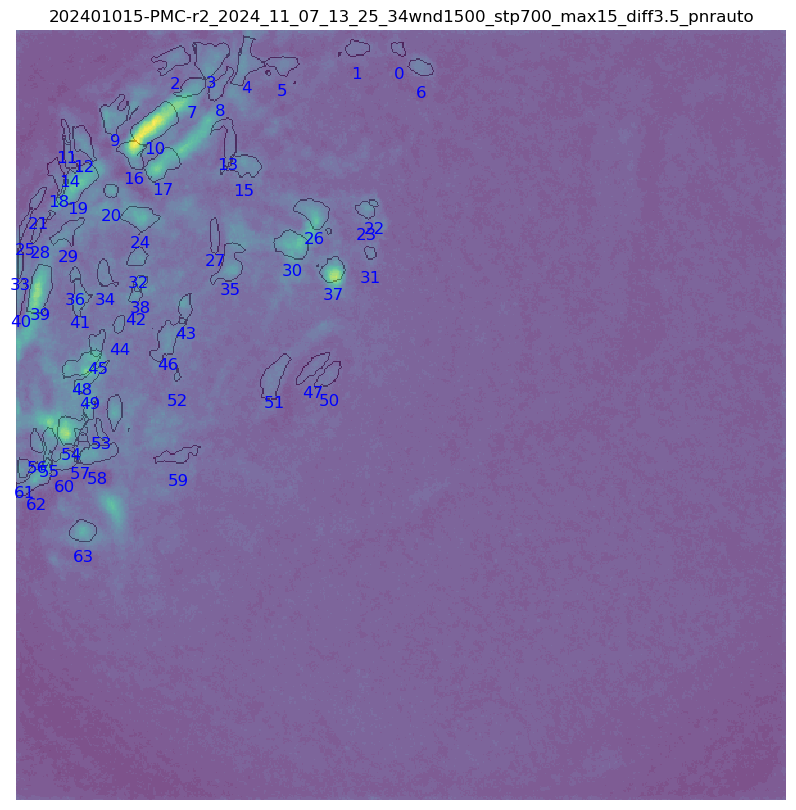

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_25_34/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff4.0_pnrauto.nc


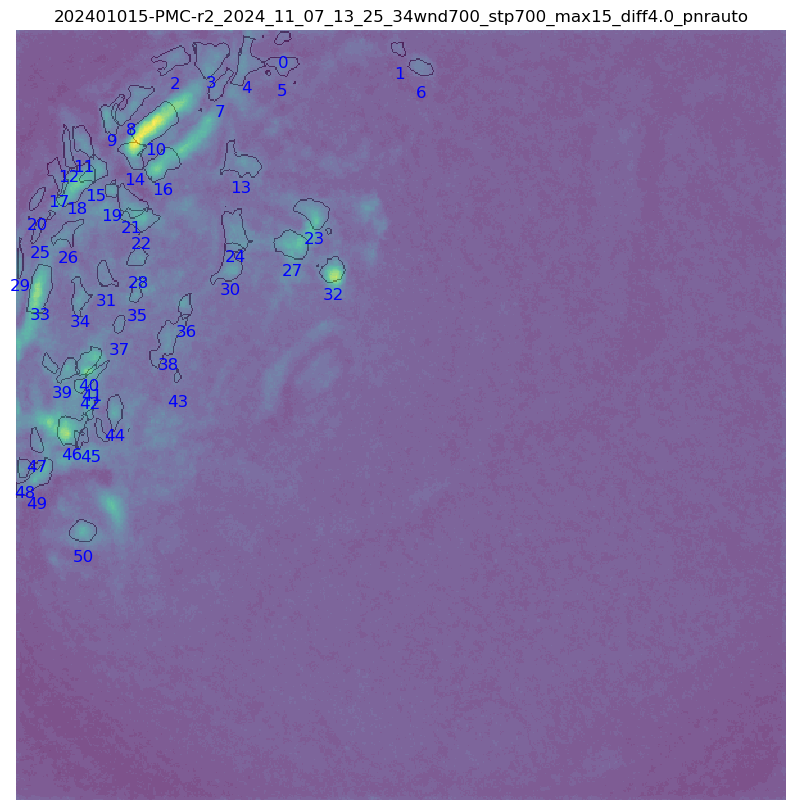


=== Running vis_param_opti for session ===
Animal:       20250506-V1L23-L1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope
Found 7 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07

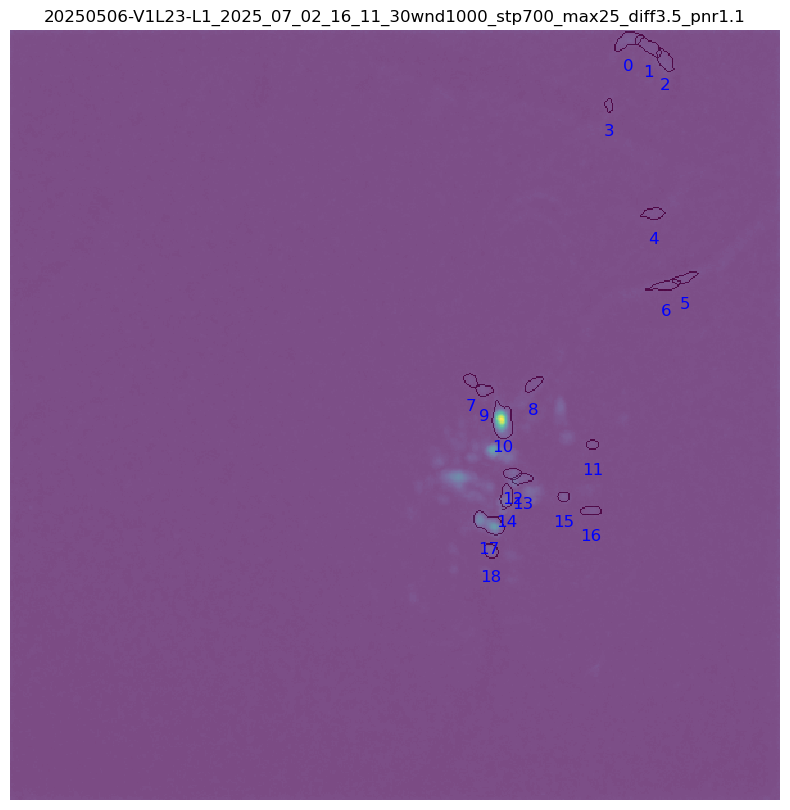

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


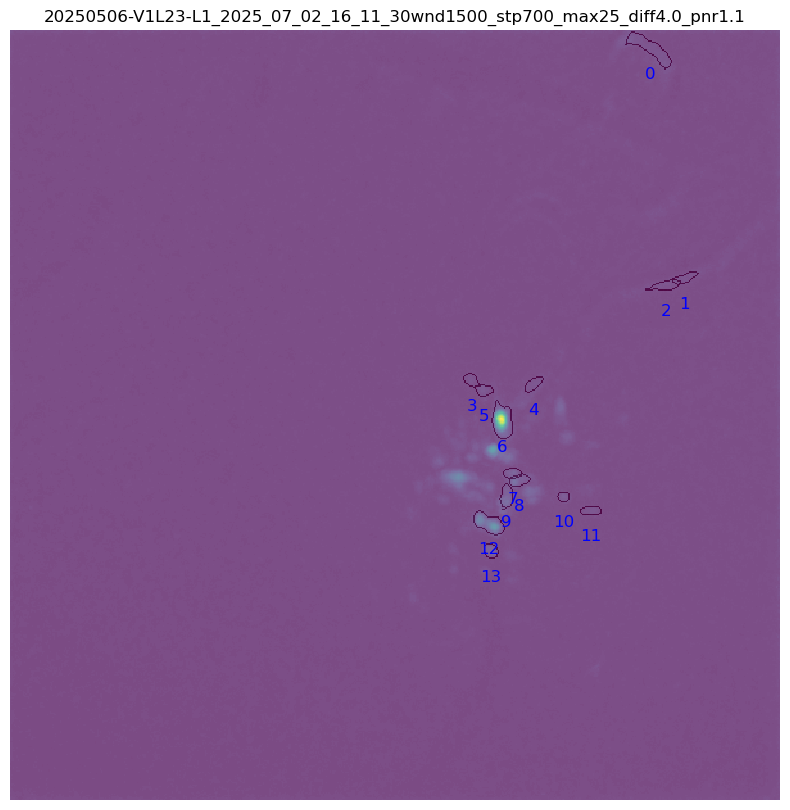

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


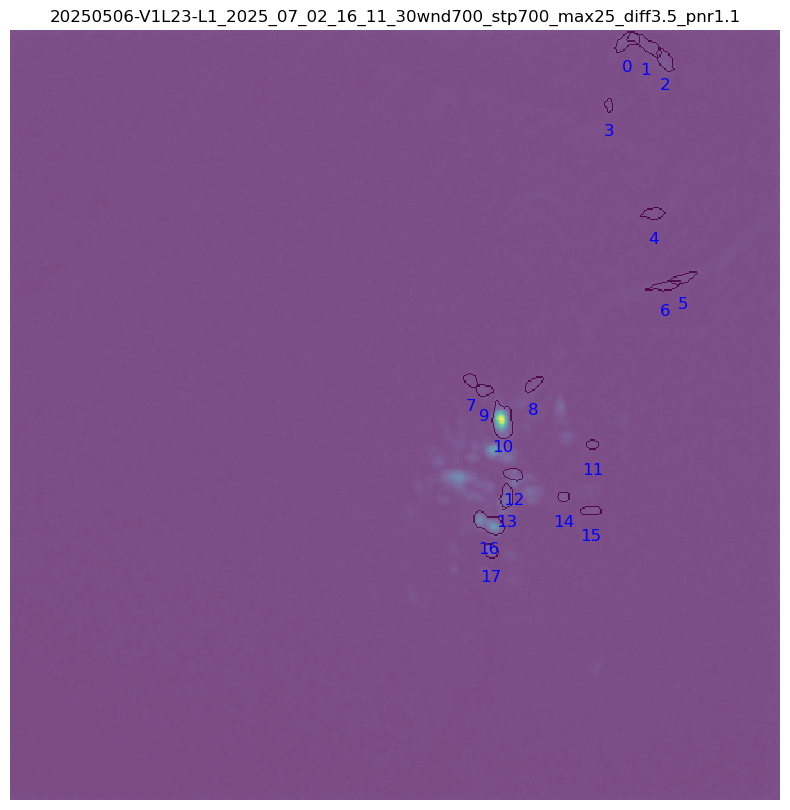

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


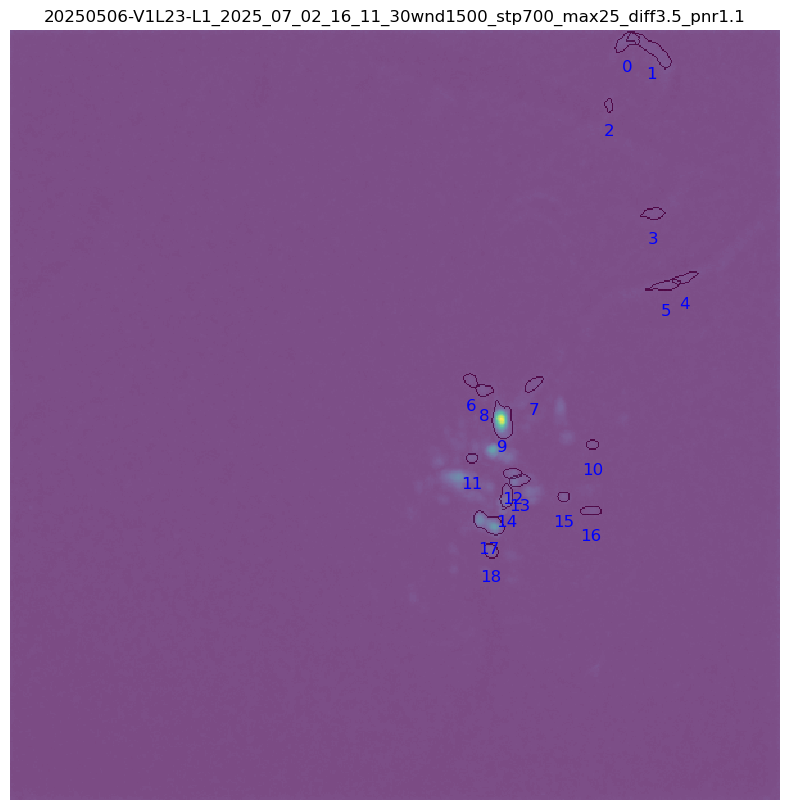

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


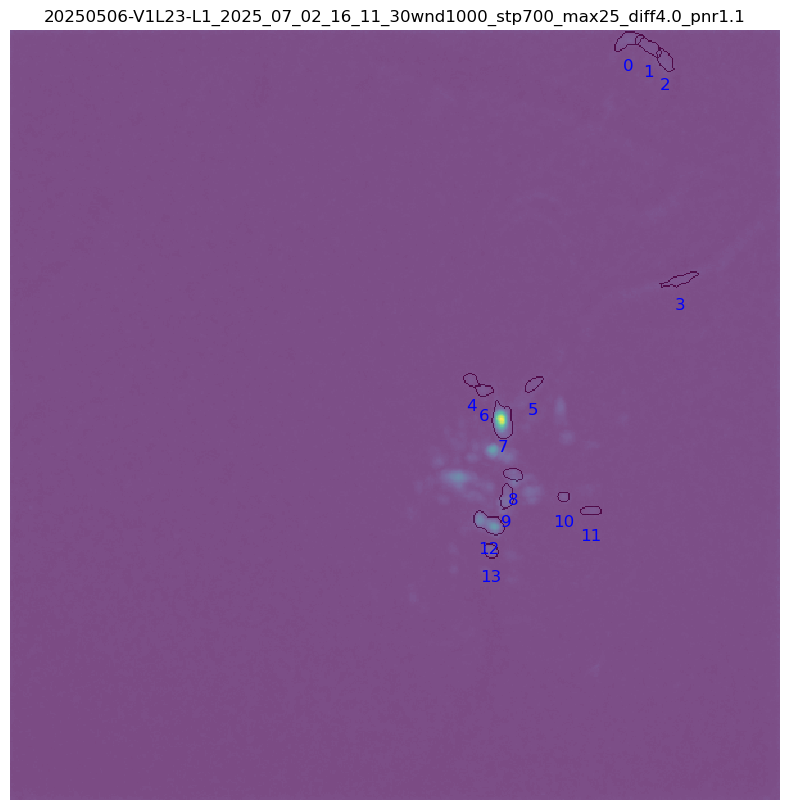

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


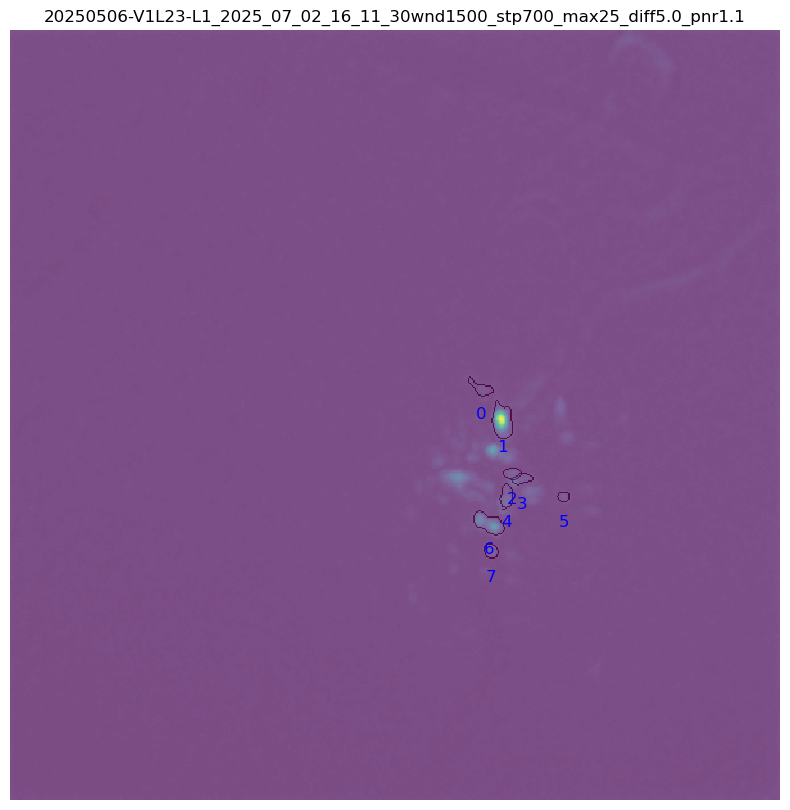

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_11_30/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


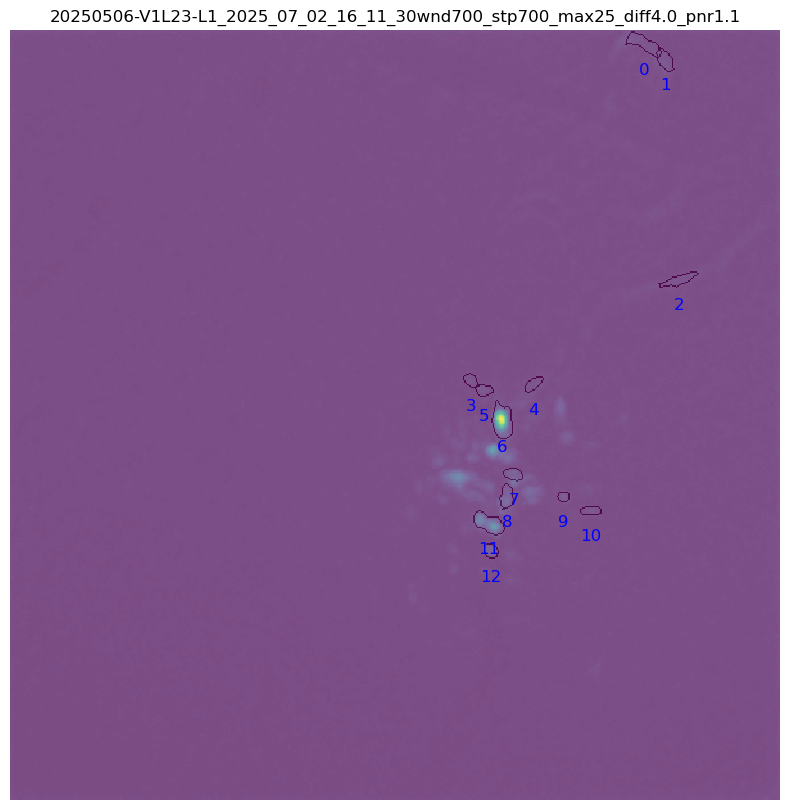


=== Running vis_param_opti for session ===
Animal:       20250506-V1L23-L1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope
Found 11 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_

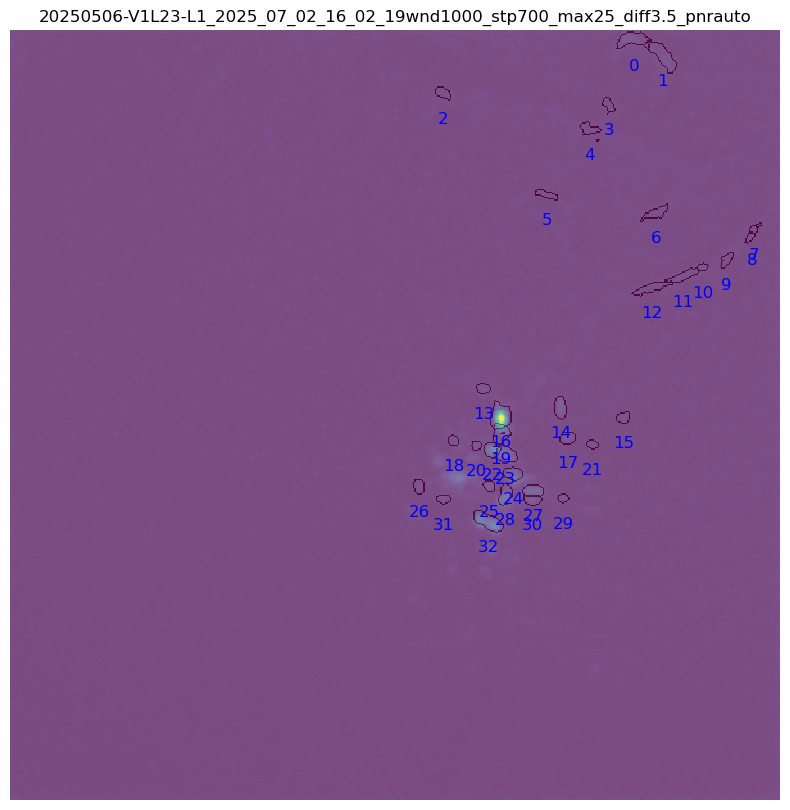

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


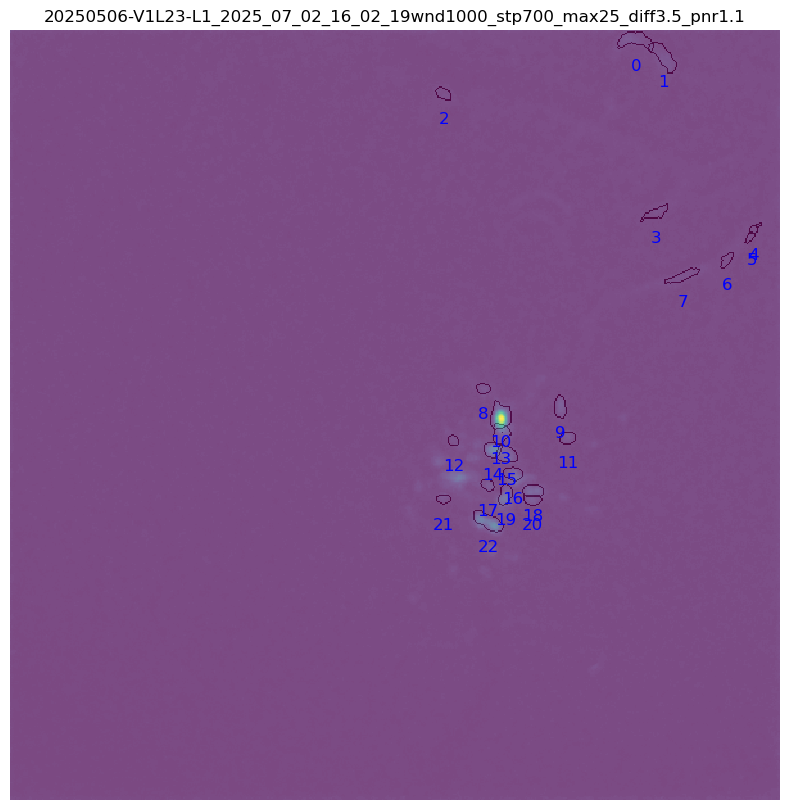

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


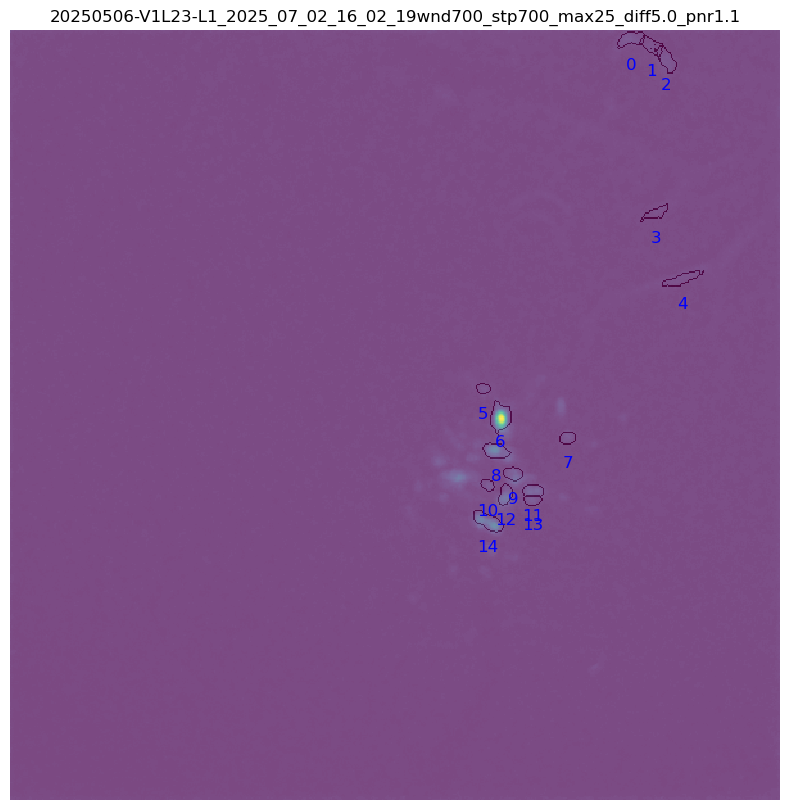

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


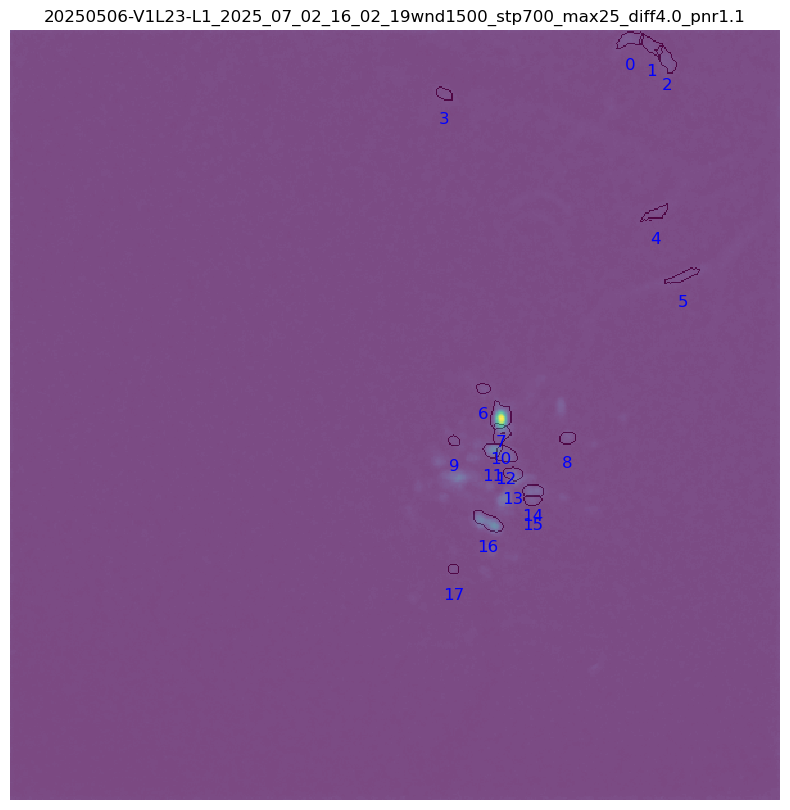

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


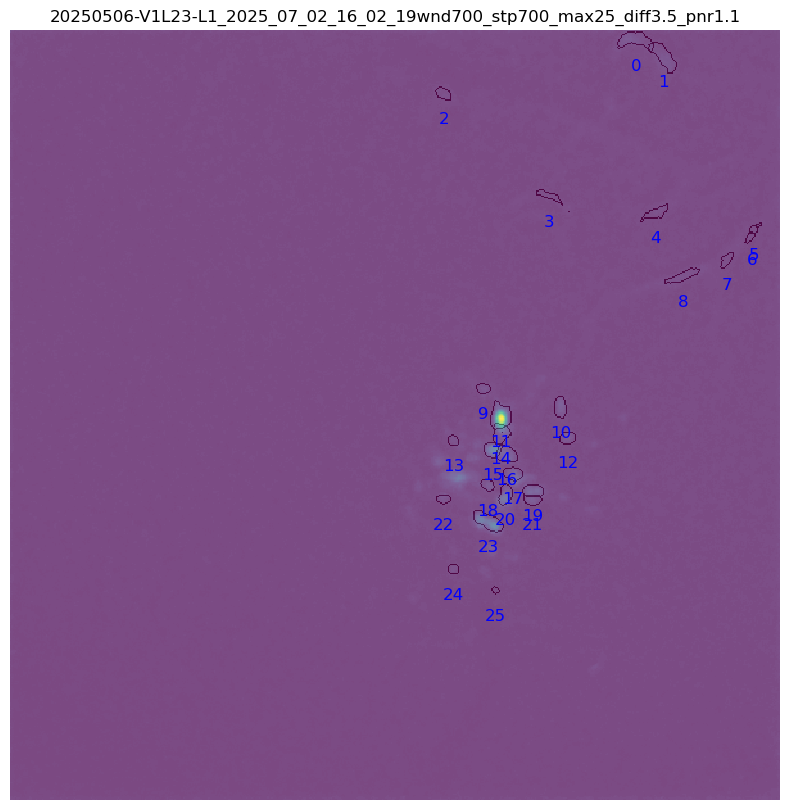

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


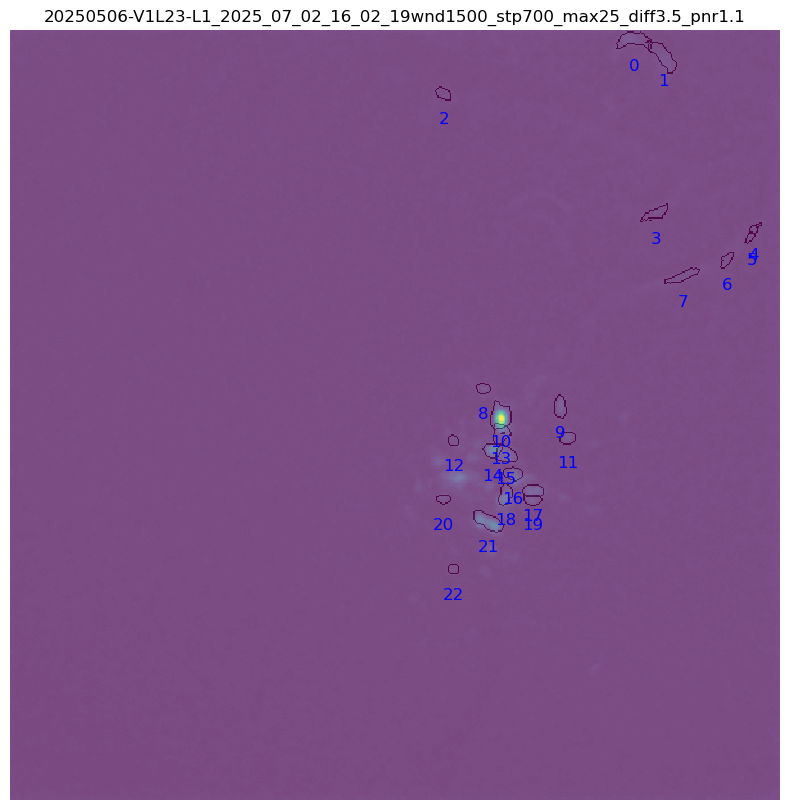

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


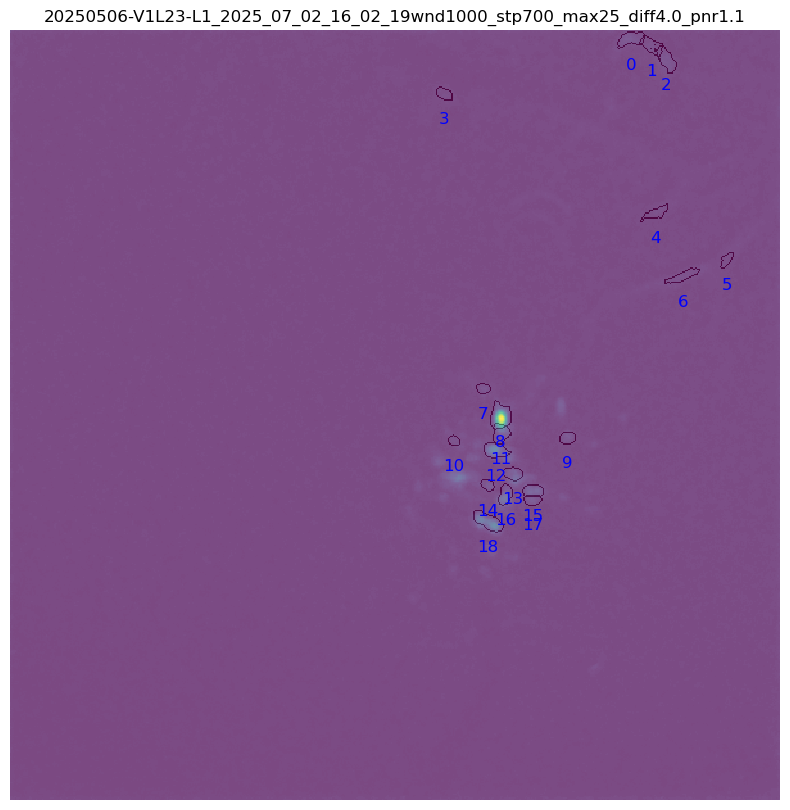

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


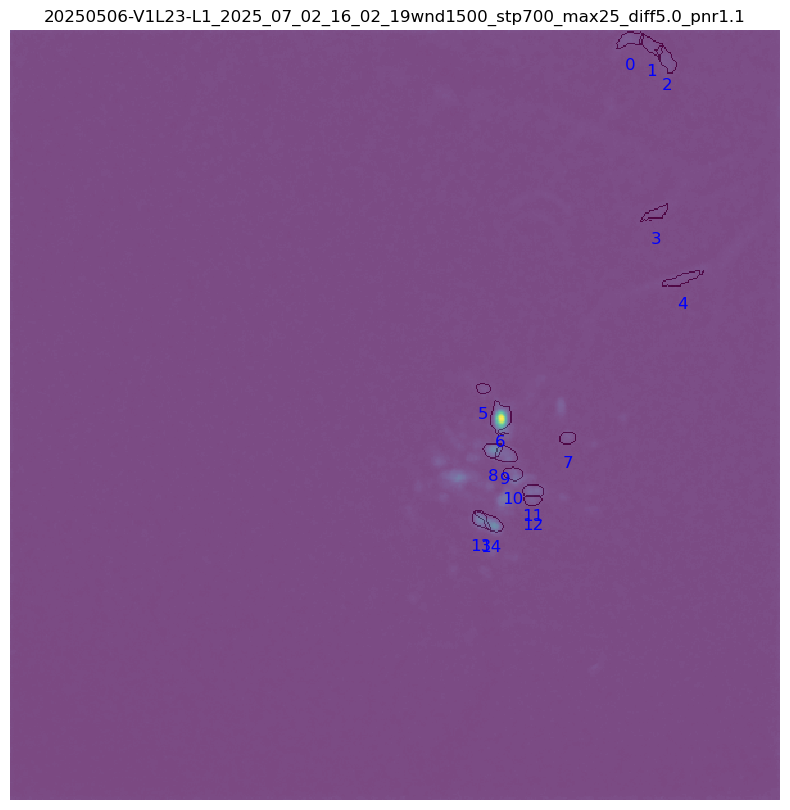

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


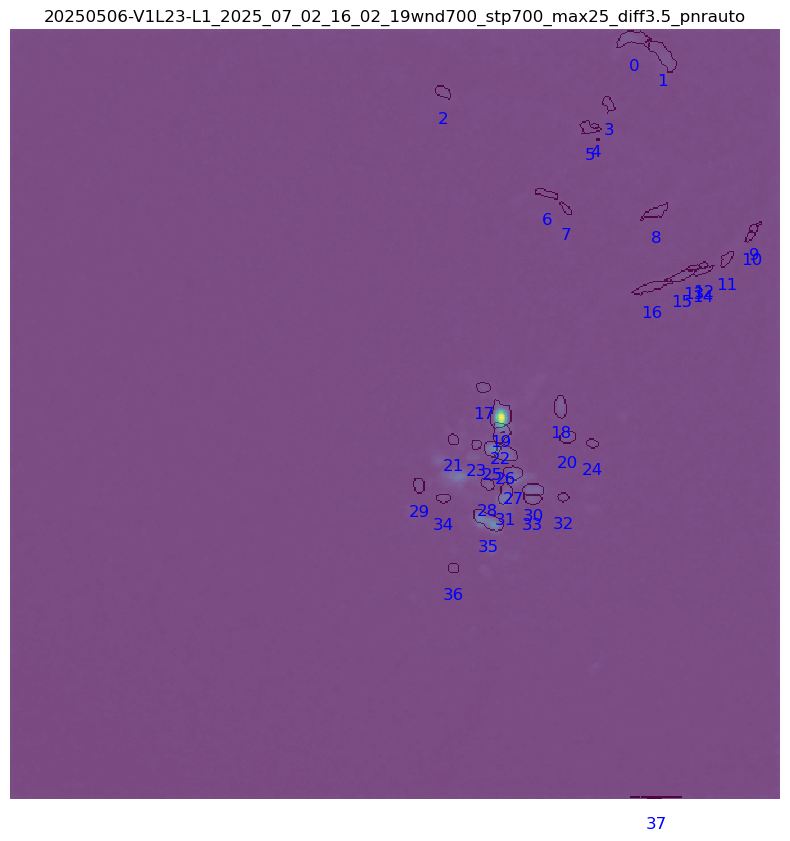

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


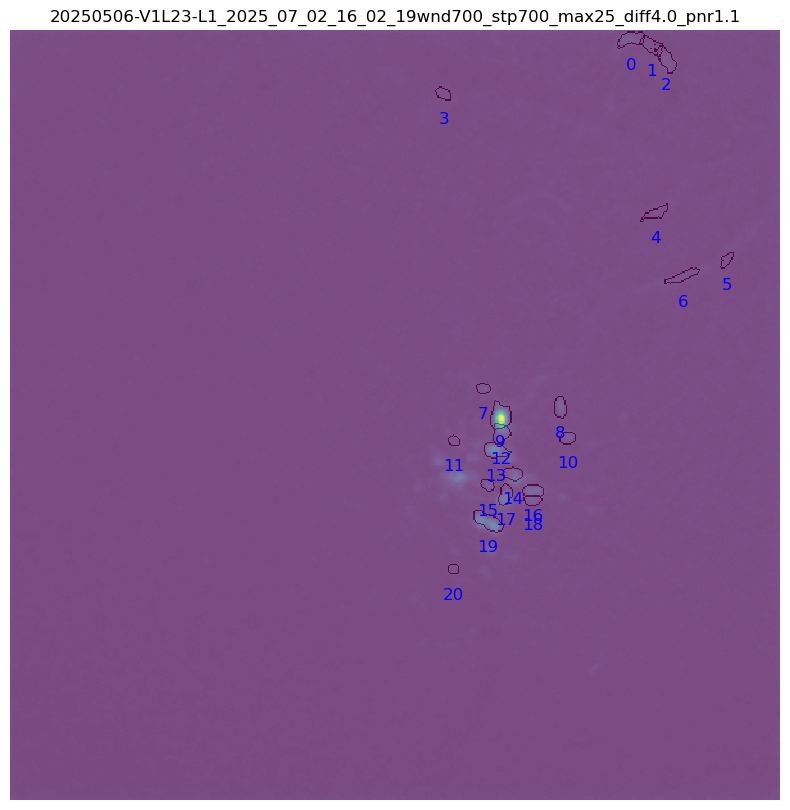

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250506-V1L23-L1/customEntValHere/2025_07_02/16_02_19/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


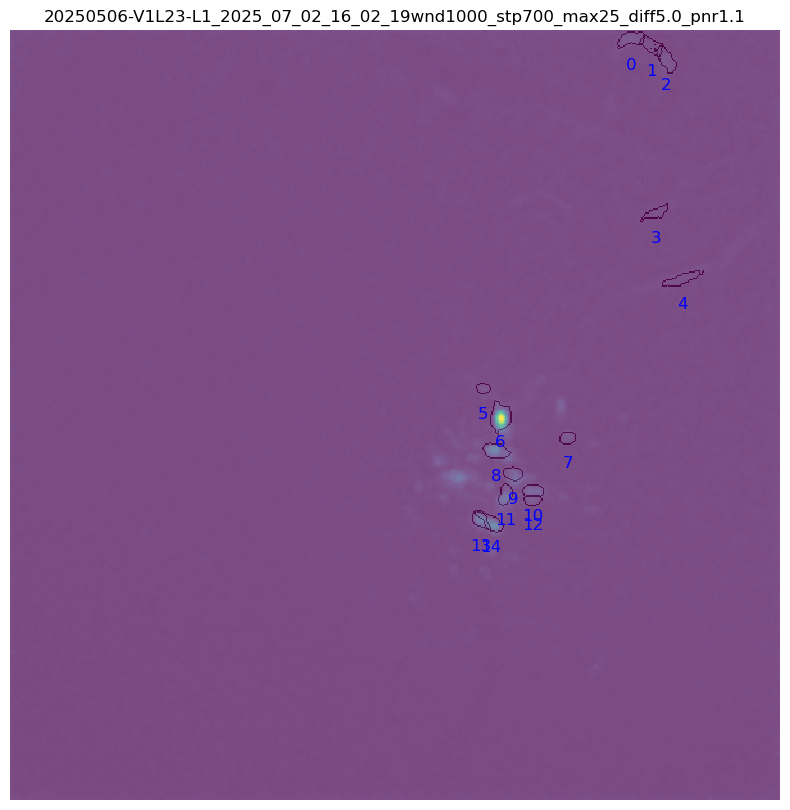


=== Running vis_param_opti for session ===
Animal:       20250407-V1L23-Novelty
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_38_23/My_V4_Miniscope
Found 2 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_38_23/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_38_23/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_38_23/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc


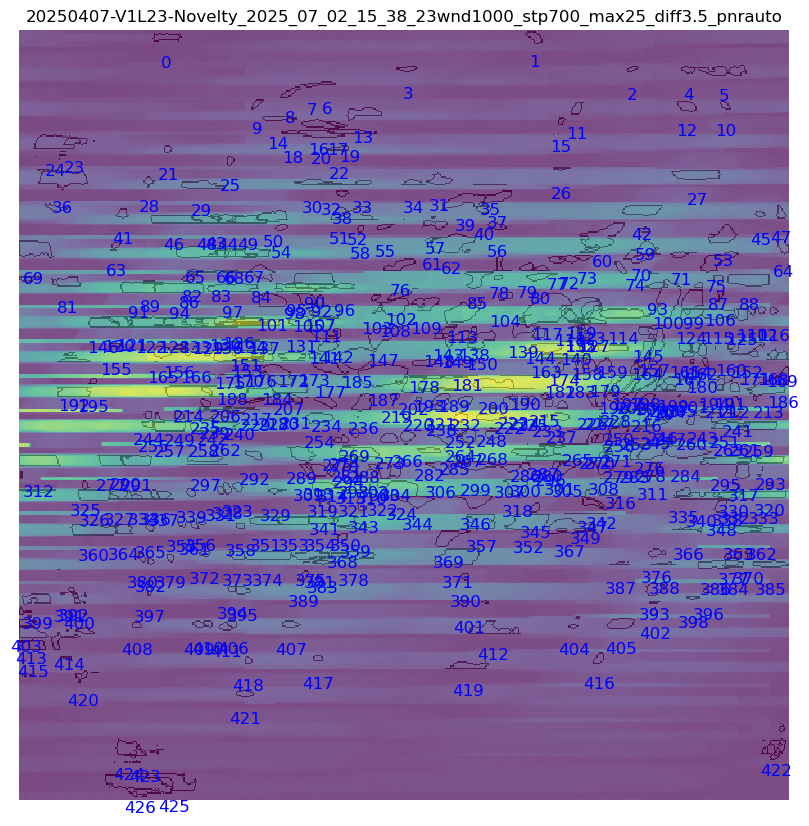

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_38_23/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


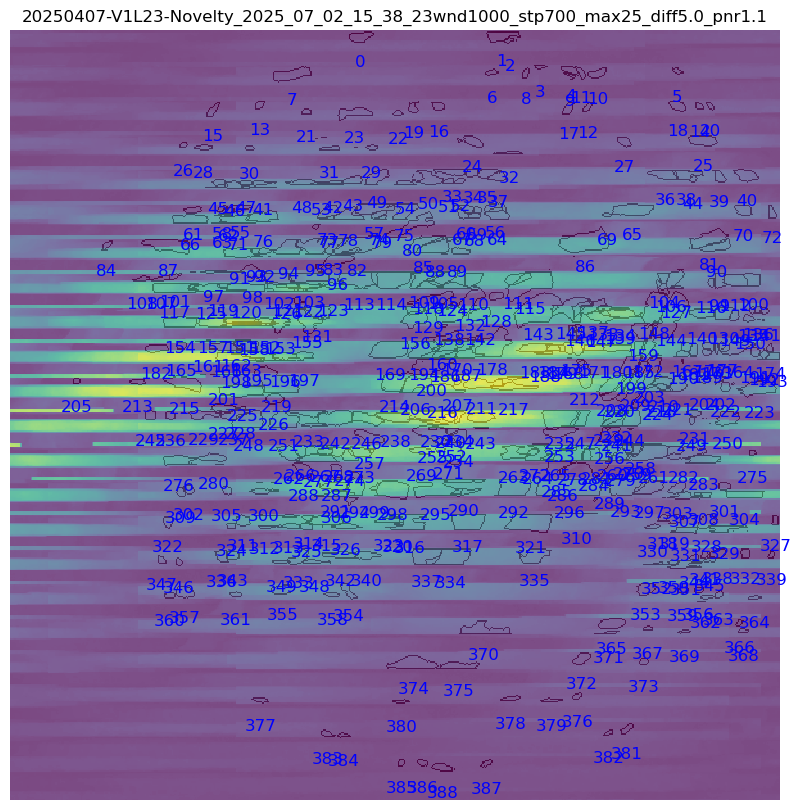


=== Running vis_param_opti for session ===
Animal:       20250407-V1L23-Novelty
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope
Found 18 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2025040

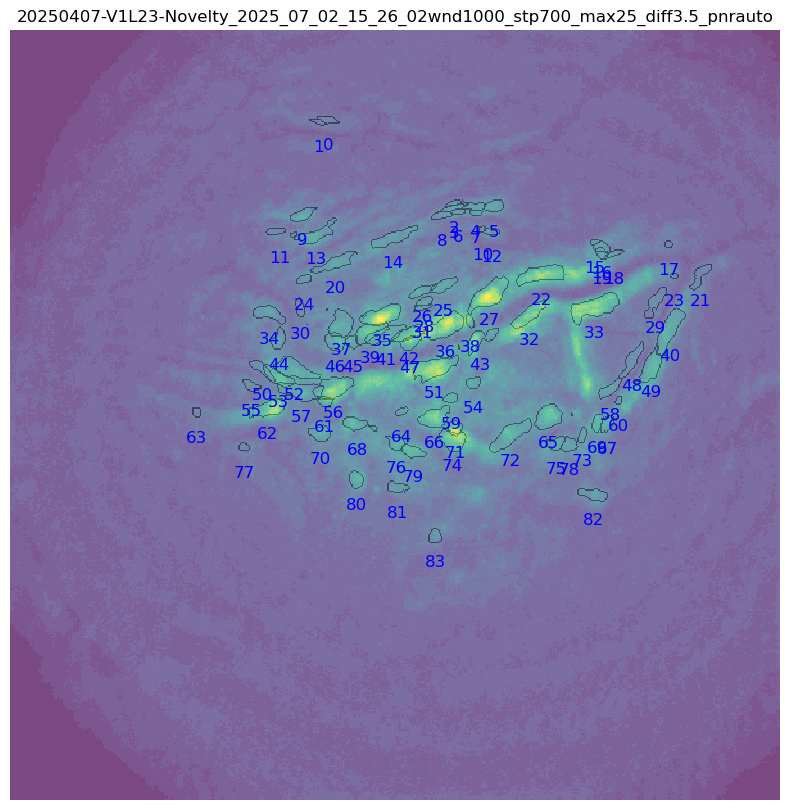

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc


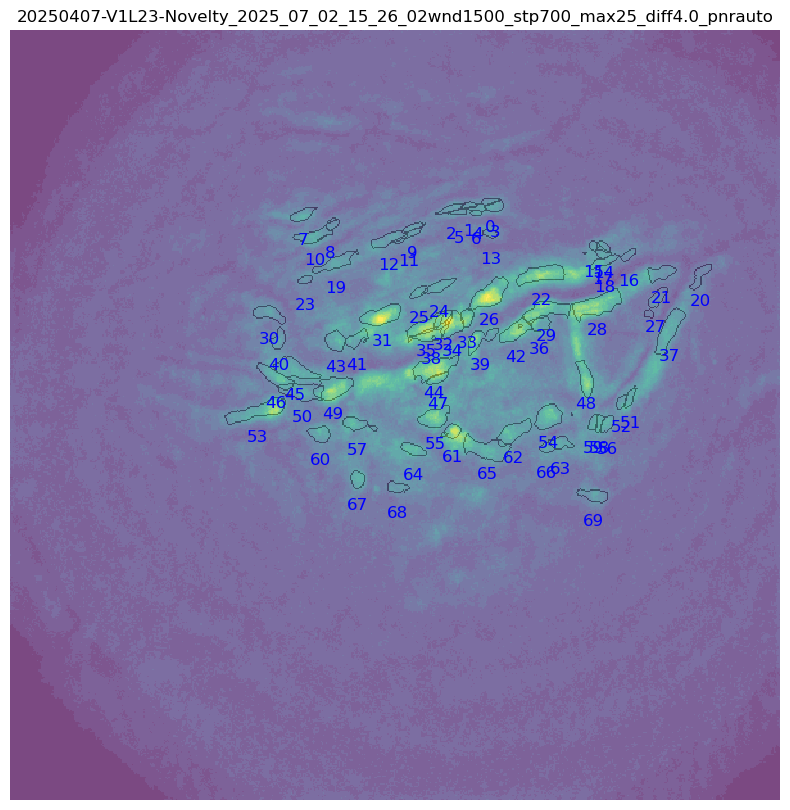

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


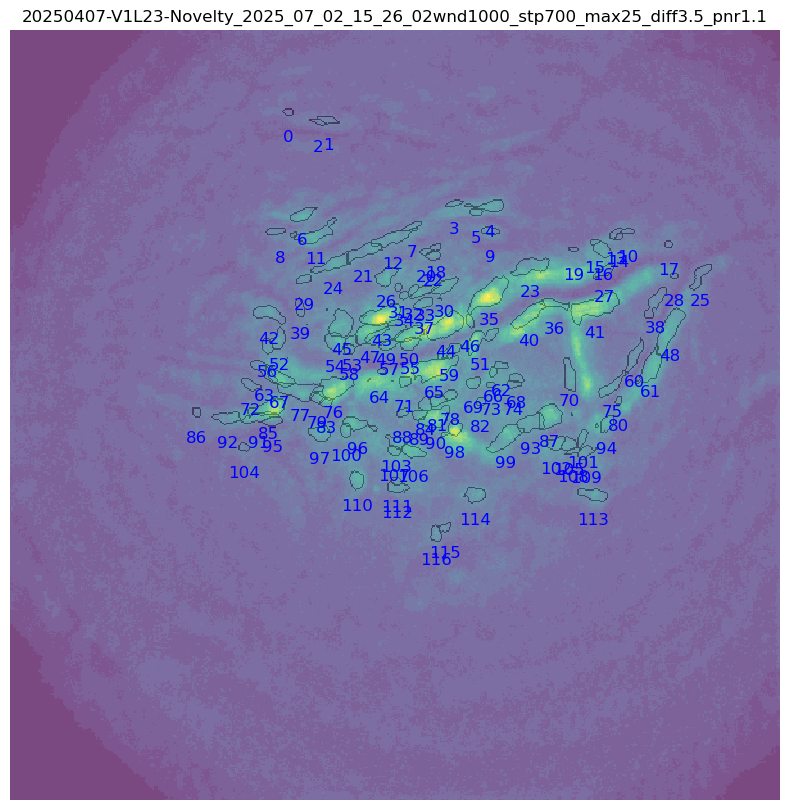

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


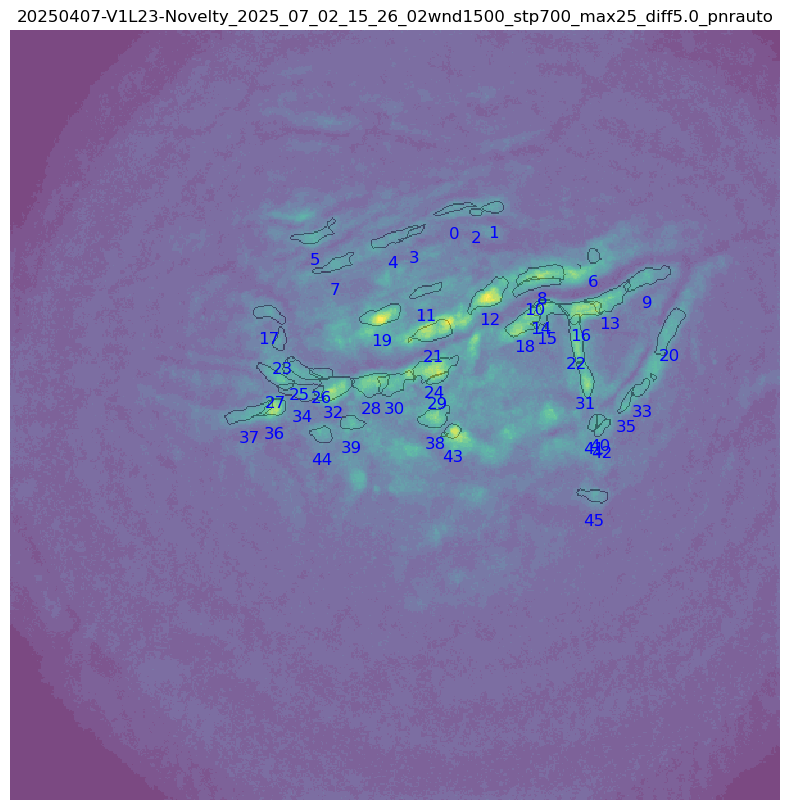

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


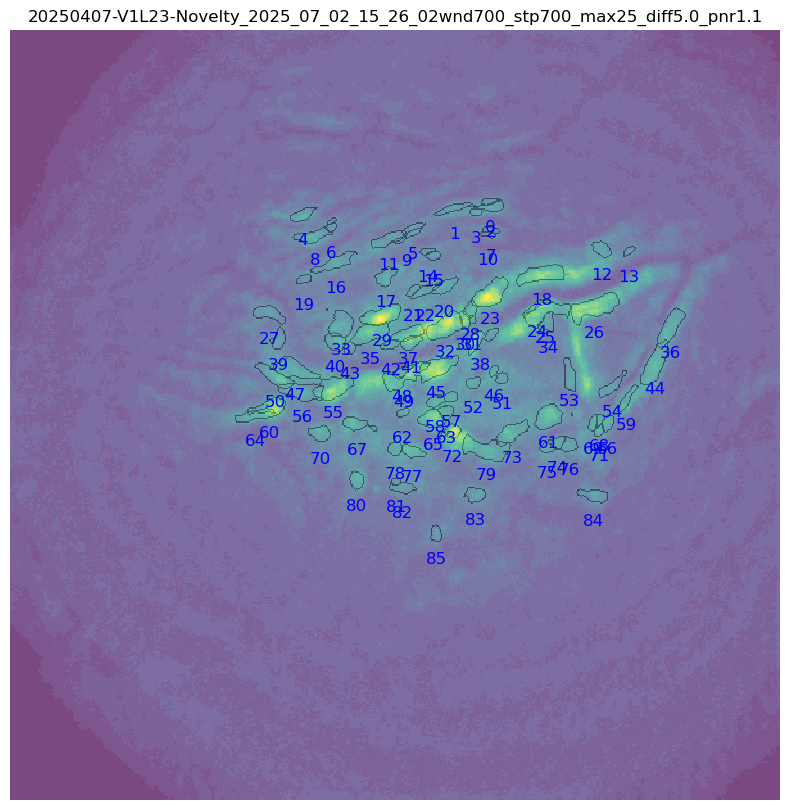

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


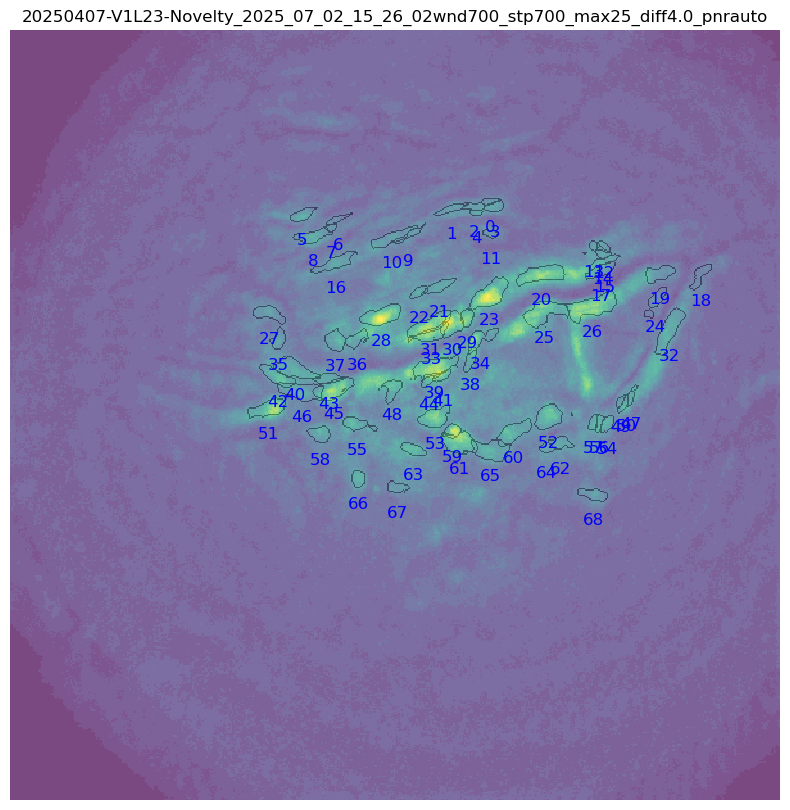

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnrauto.nc


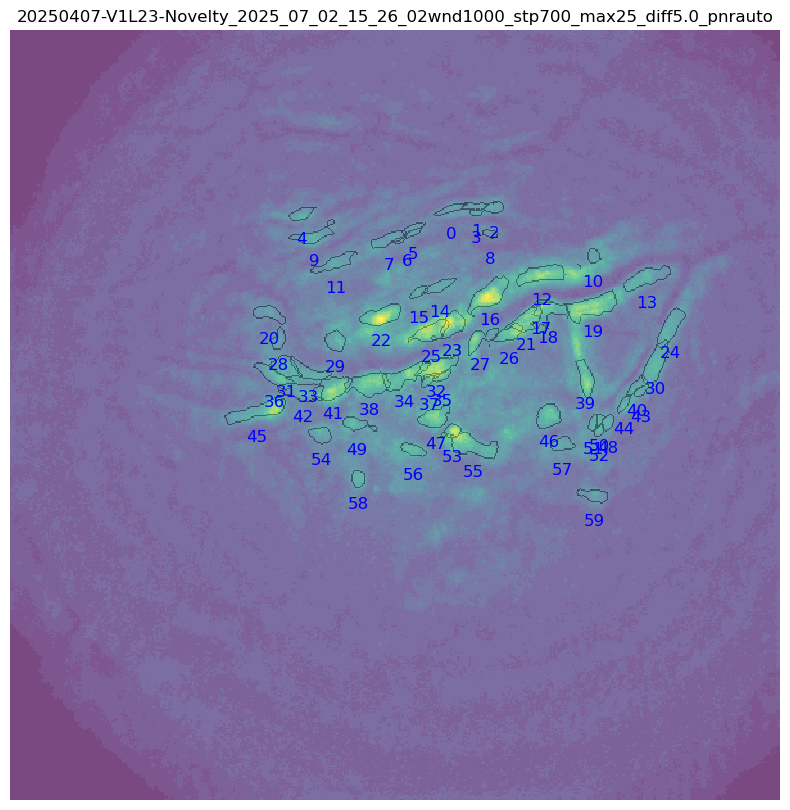

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


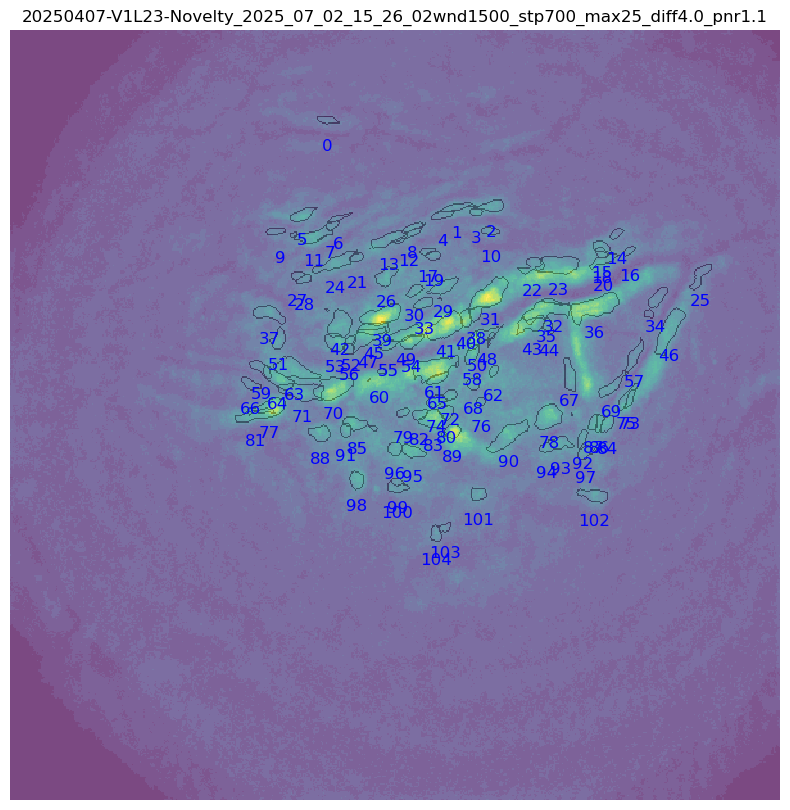

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


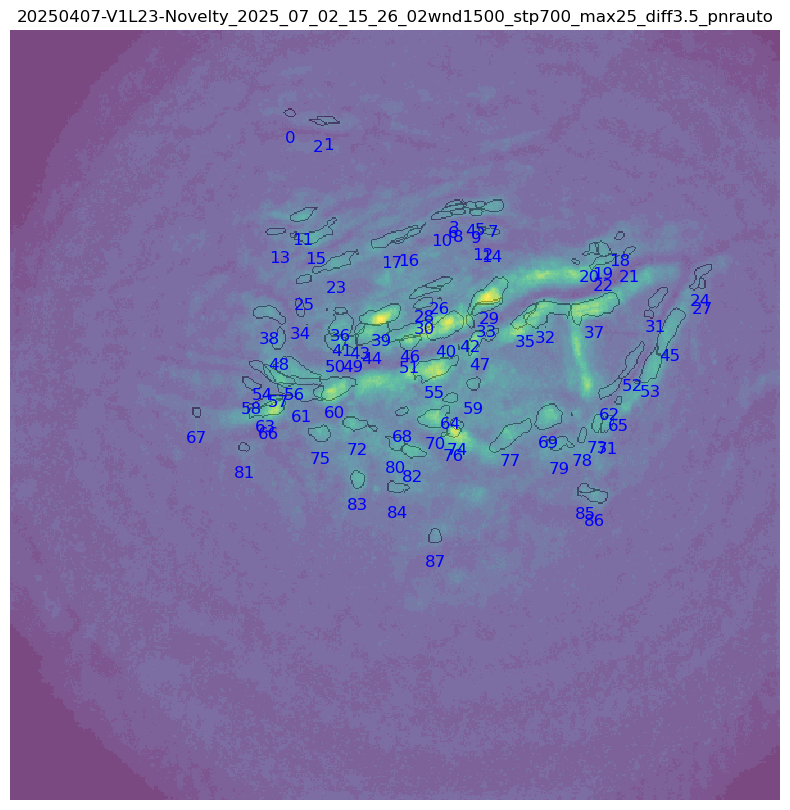

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


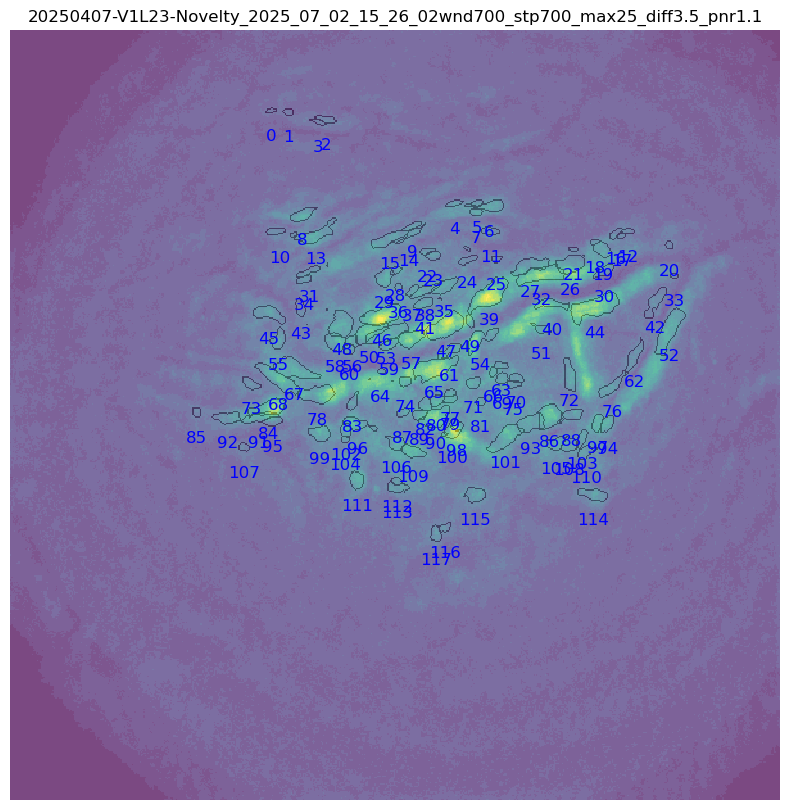

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


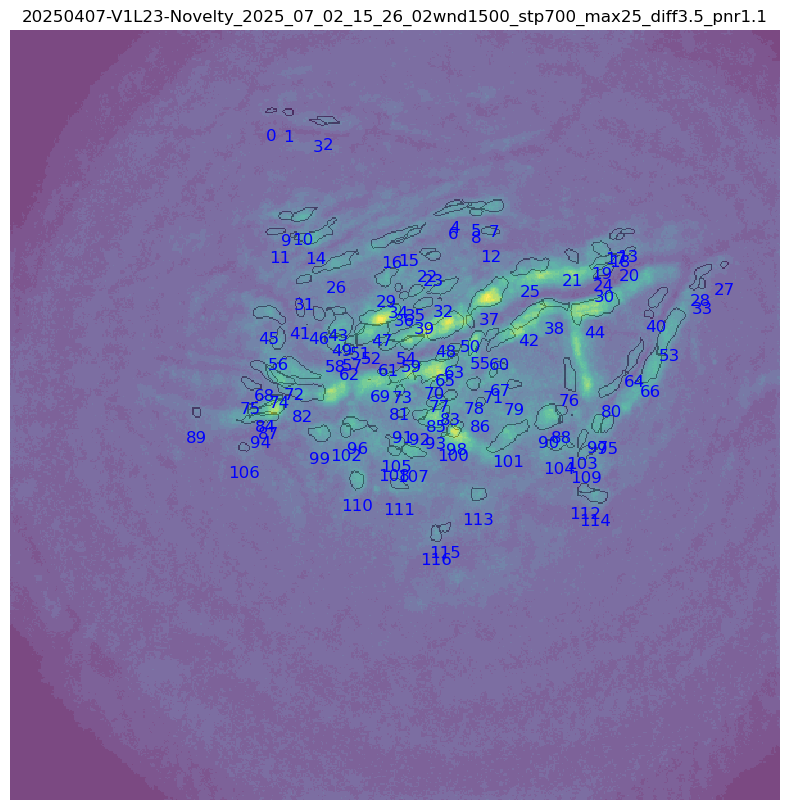

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


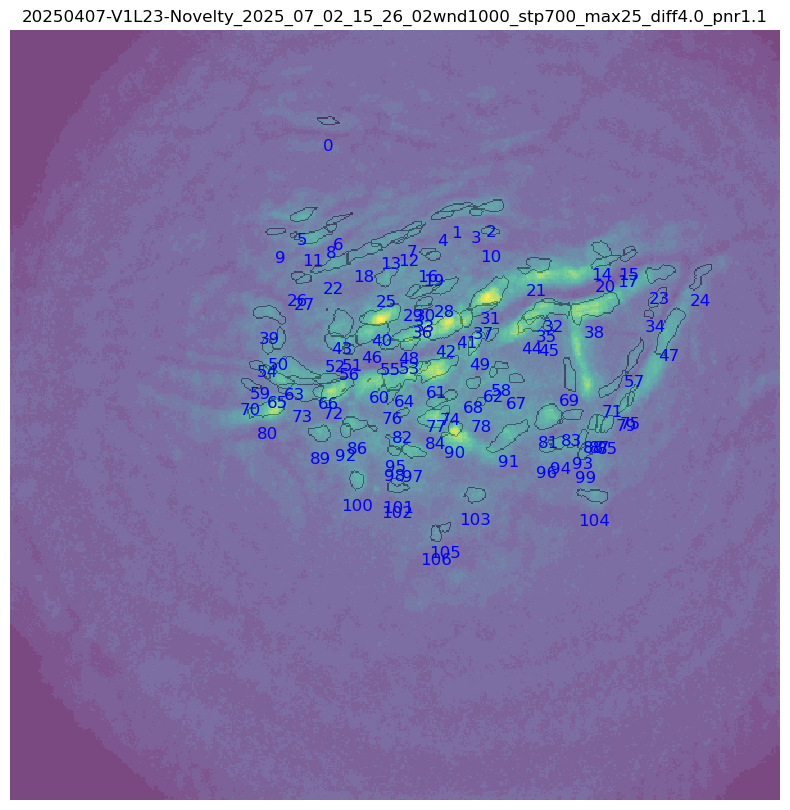

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


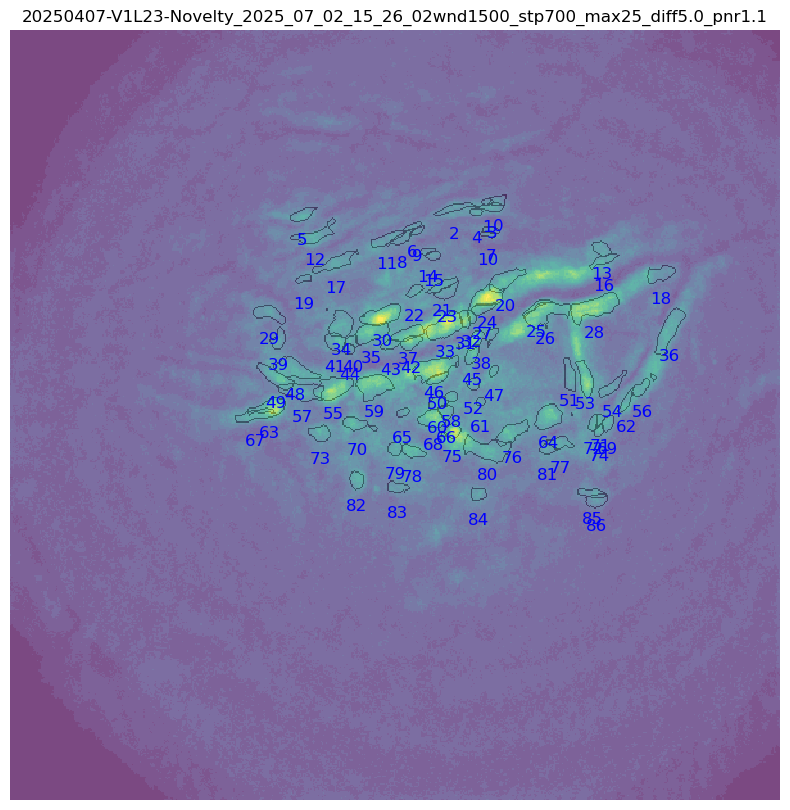

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


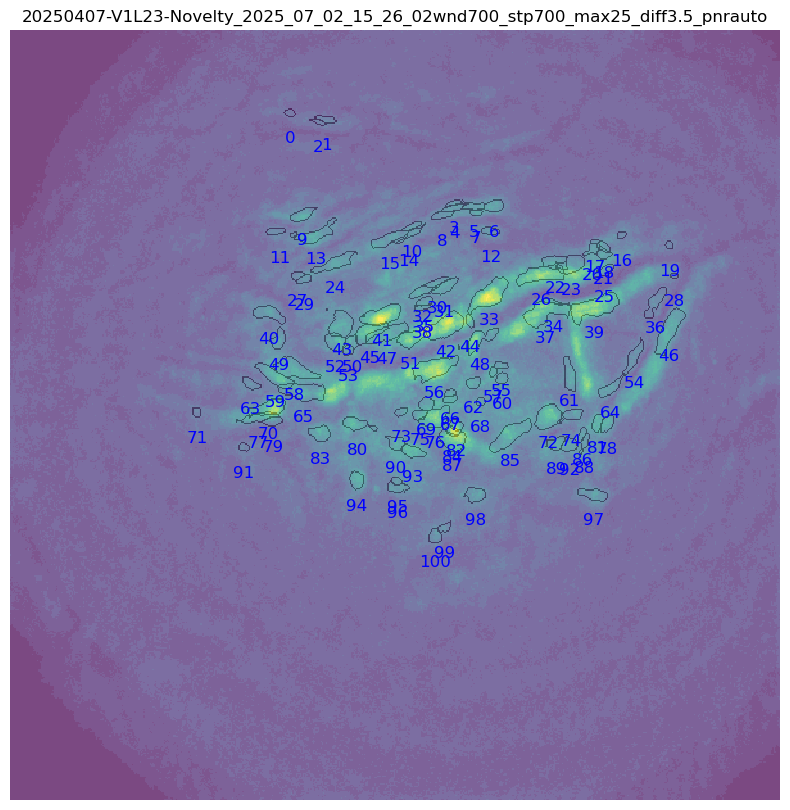

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


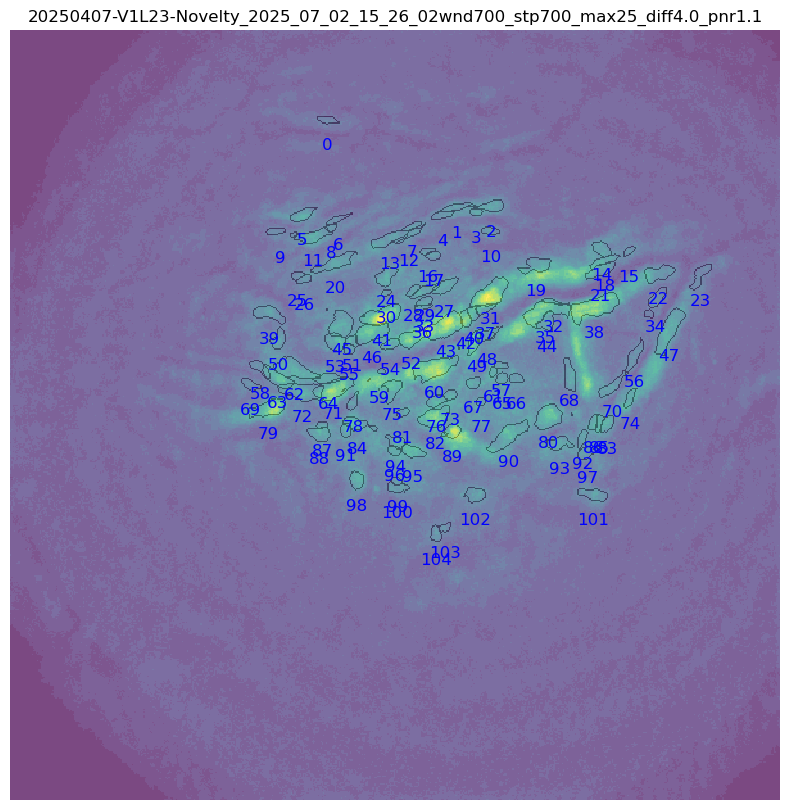

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnrauto.nc


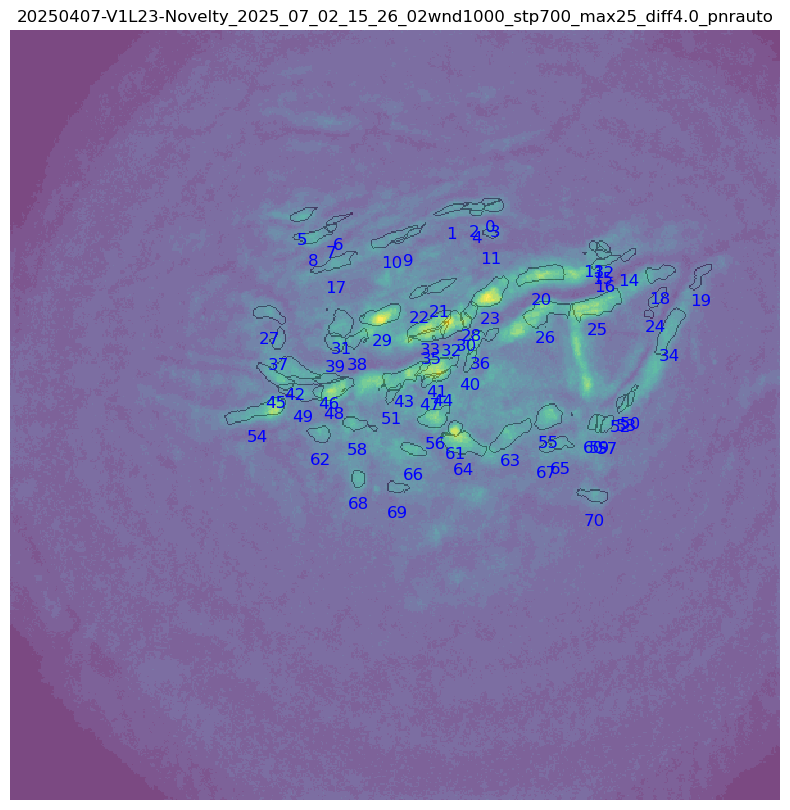

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


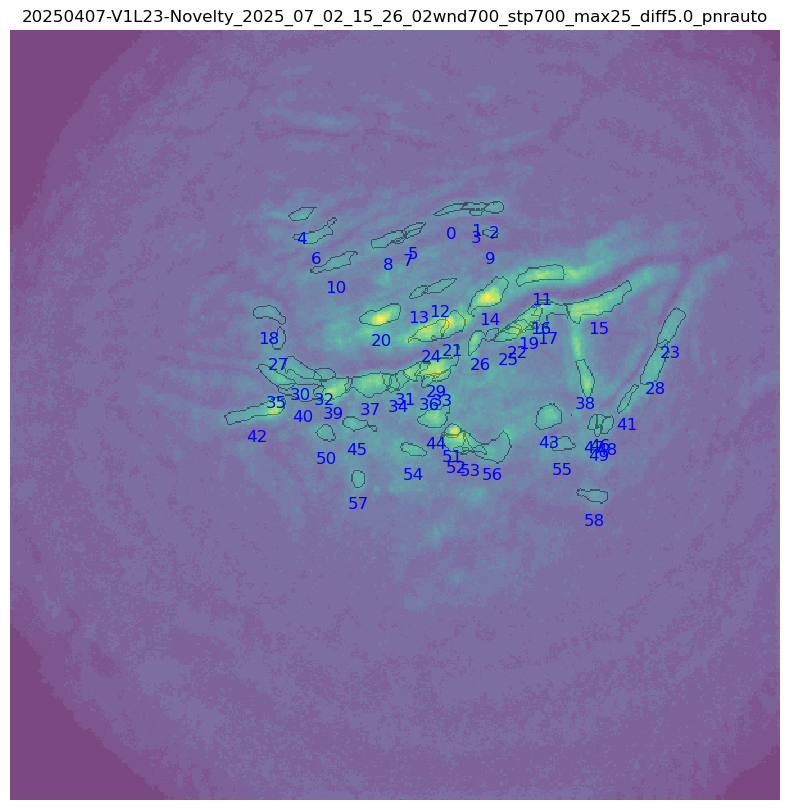

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250407-V1L23-Novelty/customEntValHere/2025_07_02/15_26_02/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


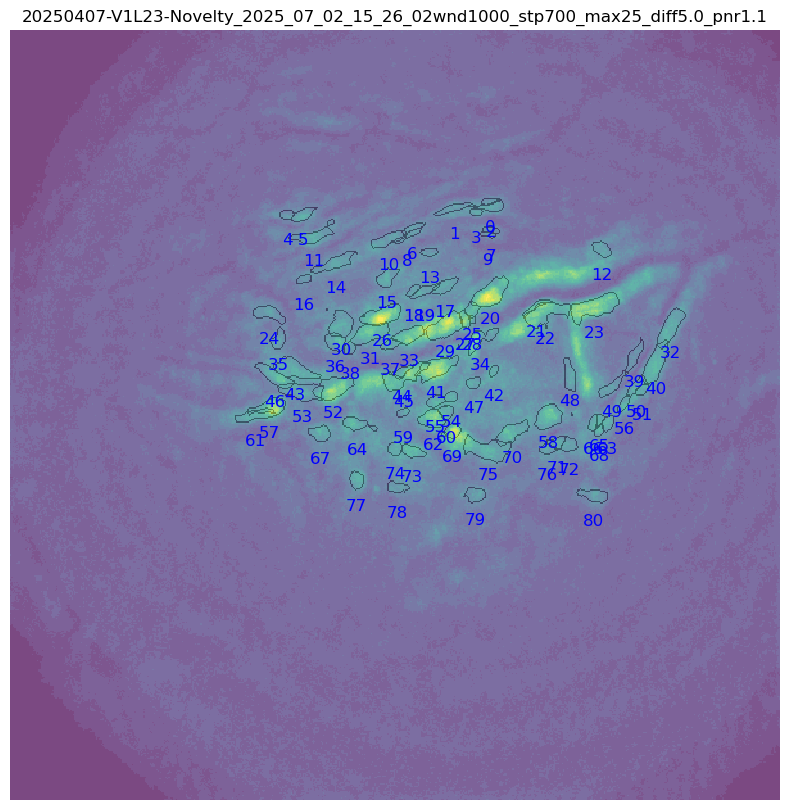


=== Running vis_param_opti for session ===
Animal:       20241224PMCLE1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_23_53/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_23_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnrauto.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_23_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnrauto.nc


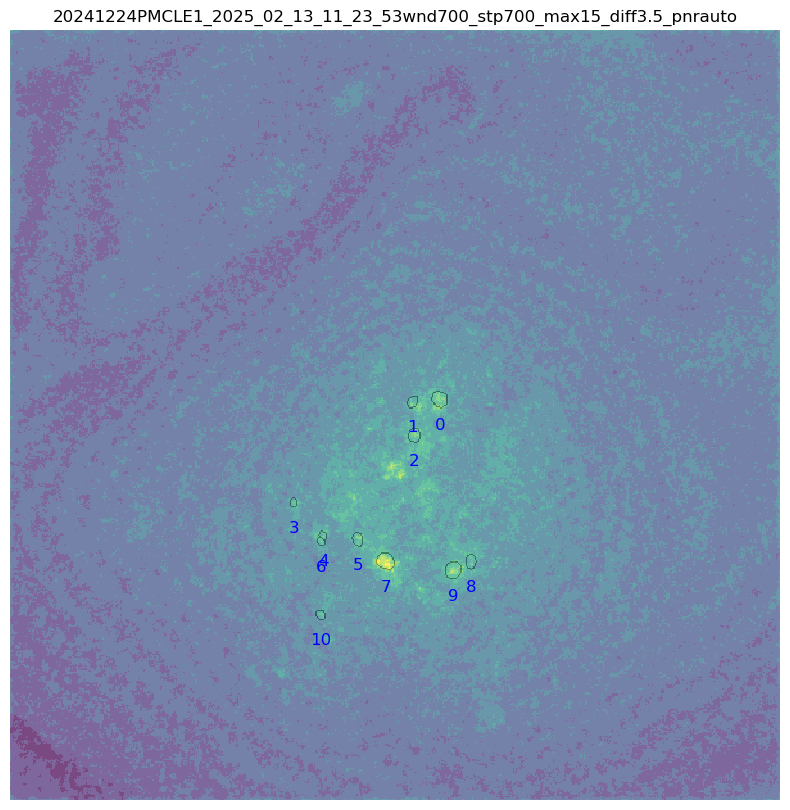


=== Running vis_param_opti for session ===
Animal:       20241224PMCLE1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_58_39/My_V4_Miniscope
No output files found in the session directory.


In [40]:
from utlis.Ca_tools.run_mini_param_utlis import run_vis_param_opti_from_table
run_vis_param_opti_from_table(filtered_table_mini)

In [ ]:
# Convert and flatten the ChunkedArray
experiment_paths = filtered_table_mini["experiment_path"].to_pylist()

# Print each path
for path in experiment_paths:
    # Each element is likely a list with one string, e.g., ['/some/path']
    print(path[0] if isinstance(path, list) else path)xc


In [39]:
import pyarrow as pa
import subprocess
import os

def run_param_search_from_table(filtered_table_mini):
    """
    Iterate through each row in `filtered_table_mini` (a PyArrow Table),
    construct the session_dir from relevant columns, and then call
    param_search_driver.py in a subprocess with the desired arguments.
    """
    # Convert table to a list of dictionaries, each representing one row
    rows = filtered_table_mini.to_pylist()

    for row in rows:
        # Extract needed columns (adjust the column names as necessary)
        # e.g. row["animal_id"], row["custom_label"], row["date"], row["time"]
        animal_id    = row["animal_id"]       # e.g. "20241015PMCBE1"
        custom_label = row["custom_label"]    # e.g. "customEntValHere"
        date_str     = row["date"]            # e.g. "2025_03_11"
        time_str     = row["time"]            # e.g. "14_22_12"

        # Build the session_dir path based on your folder structure.
        # Example:
        #   /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/{animal_id}/{custom_label}/{date_str}/{time_str}/My_V4_Miniscope
        session_dir = os.path.join(
            "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted",
            animal_id,
            custom_label,
            date_str,
            time_str,
            "My_V4_Miniscope"
        )

        # (Optional) Check that it exists or not, or create if needed:
        if not os.path.exists(session_dir):
            print(f"Warning: session_dir not found: {session_dir}")
            # If you want to create it:
            # os.makedirs(session_dir, exist_ok=True)

        print(f"\n=== Running param_search_driver for session ===")
        print(f"Animal:       {animal_id}")
        print(f"Session dir:  {session_dir}")

        # Now call param_search_driver.py, passing in the appropriate args.
        # Adjust environment calls if needed (conda, absolute path, etc.)
        cmd = [
            "conda", "run", "-n", "minian",
            "python",               # or "conda", "run", "-n", "my_env", "python" if you prefer
            "param_search_new_250601.py",
            "--session_dir", session_dir,
            "--animal", animal_id,
            # "--dry_run"
        ]

        result = subprocess.run(cmd, capture_output=True, text=True)
        
        if result.stdout:
            print("[STDOUT]", result.stdout)
        if result.stderr:
            print("[STDERR]", result.stderr)

# Example usage:
# Suppose you've already loaded your arrow table into `filtered_table_mini`.
# You can now call:

run_param_search_from_table(filtered_table_mini)



=== Running param_search_driver for session ===
Animal:       20250505-V1L23-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope
[STDOUT] Running combination: wnd700_stp700_max25_diff3.5_pnr1.1
loading 5 videos in folder /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20250505-V1L23-R1/customEntValHere/2025_07_02/14_45_55/My_V4_Miniscope
constructing chunks
computing max projections
calculating local maximum
selecting seeds
computing peak-noise ratio
selecting seeds
performing KS test
computing distance
computing correlations
pixel recompute ratio: 0.9834174477289113
computing correlations
merging seeds
optimizing computation graph
pixel recompute ratio: 1.047443508234393
computing correlations
building spatial matrix
computing spatial overlap
computing temporal correlation
pixel recompute ratio: 0.38235294117647056
computing correlations
labeling units to be merged
merging units
estimating penalty paramet